# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

A subdirectory or file data already exists.


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

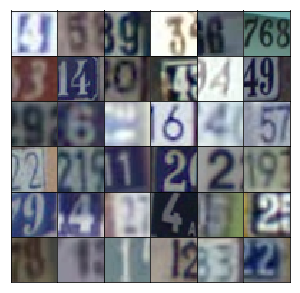

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4 * 4 * 512)
        
        # Conv 1
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        # Implementing leaky relu
        x1 = tf.maximum(alpha * x1, x1)
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides = 2, padding="same")
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        
        # Conv2
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides = 2, padding="same")
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides = 2, padding="same")
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've build before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU. 

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
#         x = tf.layers.conv2d(x, 32, 5, strides = 2, padding="same")
#         x = tf.maximum(alpha * x, x)
        
        # Conv 2
        x1 = tf.layers.conv2d(x, 64, 5, strides = 2, padding="same")
#         x1 = tf.layers.batch_normalization(x1, training=True)
        x1 = tf.maximum(alpha * x1, x1)
        
        # Conv 3
        x2 = tf.layers.conv2d(x1, 128, 5, strides = 2, padding="same")
        x2 = tf.layers.batch_normalization(x2, training=True)
        x2 = tf.maximum(alpha * x2, x2)
        
        # Conv 4
        x3 = tf.layers.conv2d(x2, 256, 5, strides = 2, padding="same")
        x3 = tf.layers.batch_normalization(x3, training=True)
        x3 = tf.maximum(alpha * x3, x3)
        
        logits = tf.layers.dense(tf.reshape(x3, [-1, 4 * 4 * 256]), 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.7912... Generator Loss: 0.4509
Epoch 1/25... Discriminator Loss: 0.3447... Generator Loss: 2.0443
Epoch 1/25... Discriminator Loss: 0.1767... Generator Loss: 2.3431
Epoch 1/25... Discriminator Loss: 0.1120... Generator Loss: 3.0095
Epoch 1/25... Discriminator Loss: 0.2061... Generator Loss: 2.3941
Epoch 1/25... Discriminator Loss: 0.0888... Generator Loss: 3.3129
Epoch 1/25... Discriminator Loss: 0.3905... Generator Loss: 1.7149
Epoch 1/25... Discriminator Loss: 1.2883... Generator Loss: 0.6604
Epoch 1/25... Discriminator Loss: 0.9478... Generator Loss: 0.9471
Epoch 1/25... Discriminator Loss: 0.5899... Generator Loss: 1.6273


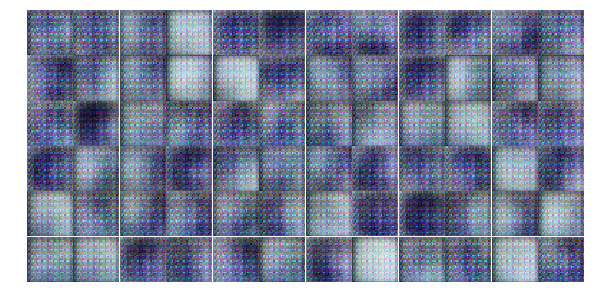

Epoch 1/25... Discriminator Loss: 0.4756... Generator Loss: 1.4485
Epoch 1/25... Discriminator Loss: 0.4181... Generator Loss: 1.6130
Epoch 1/25... Discriminator Loss: 0.4497... Generator Loss: 1.4811
Epoch 1/25... Discriminator Loss: 0.3931... Generator Loss: 1.8680
Epoch 1/25... Discriminator Loss: 0.6123... Generator Loss: 1.1737
Epoch 1/25... Discriminator Loss: 0.3999... Generator Loss: 2.7654
Epoch 1/25... Discriminator Loss: 0.2931... Generator Loss: 2.0680
Epoch 1/25... Discriminator Loss: 0.6031... Generator Loss: 1.2011
Epoch 1/25... Discriminator Loss: 1.7329... Generator Loss: 3.7856
Epoch 1/25... Discriminator Loss: 0.8887... Generator Loss: 0.8704


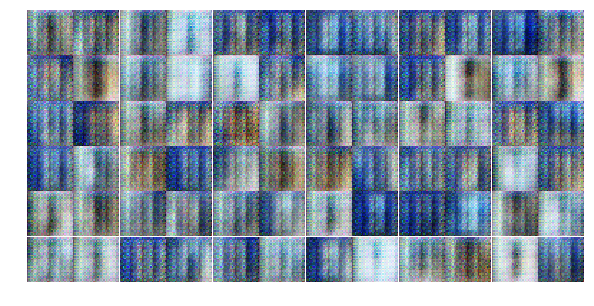

Epoch 1/25... Discriminator Loss: 0.2691... Generator Loss: 4.7054
Epoch 1/25... Discriminator Loss: 0.8110... Generator Loss: 1.9307
Epoch 1/25... Discriminator Loss: 0.3117... Generator Loss: 1.8912
Epoch 1/25... Discriminator Loss: 4.7157... Generator Loss: 0.0140
Epoch 1/25... Discriminator Loss: 0.8822... Generator Loss: 1.0330
Epoch 1/25... Discriminator Loss: 1.0889... Generator Loss: 1.1612
Epoch 1/25... Discriminator Loss: 1.0141... Generator Loss: 0.8819
Epoch 1/25... Discriminator Loss: 0.6391... Generator Loss: 1.3705
Epoch 1/25... Discriminator Loss: 0.3748... Generator Loss: 2.0172
Epoch 1/25... Discriminator Loss: 0.4883... Generator Loss: 2.5770


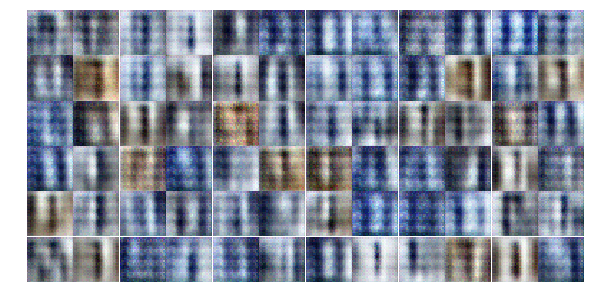

Epoch 1/25... Discriminator Loss: 0.6784... Generator Loss: 1.0747
Epoch 1/25... Discriminator Loss: 0.8019... Generator Loss: 1.0619
Epoch 1/25... Discriminator Loss: 0.5537... Generator Loss: 1.2383
Epoch 1/25... Discriminator Loss: 1.0537... Generator Loss: 1.0215
Epoch 1/25... Discriminator Loss: 0.8716... Generator Loss: 1.1539
Epoch 1/25... Discriminator Loss: 0.4831... Generator Loss: 1.5376
Epoch 1/25... Discriminator Loss: 0.7854... Generator Loss: 1.2574
Epoch 1/25... Discriminator Loss: 0.5516... Generator Loss: 2.9301
Epoch 1/25... Discriminator Loss: 0.7240... Generator Loss: 2.1064
Epoch 1/25... Discriminator Loss: 0.8462... Generator Loss: 1.2133


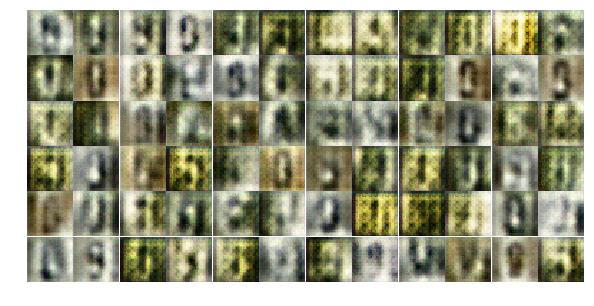

Epoch 1/25... Discriminator Loss: 0.5066... Generator Loss: 1.8452
Epoch 1/25... Discriminator Loss: 0.5508... Generator Loss: 1.4669
Epoch 1/25... Discriminator Loss: 0.3473... Generator Loss: 1.9733
Epoch 1/25... Discriminator Loss: 0.8805... Generator Loss: 1.2049
Epoch 1/25... Discriminator Loss: 0.7996... Generator Loss: 1.5295
Epoch 1/25... Discriminator Loss: 0.6284... Generator Loss: 2.0500
Epoch 1/25... Discriminator Loss: 0.8457... Generator Loss: 1.1163
Epoch 1/25... Discriminator Loss: 0.8758... Generator Loss: 2.2098
Epoch 1/25... Discriminator Loss: 0.9325... Generator Loss: 0.7770
Epoch 1/25... Discriminator Loss: 0.5221... Generator Loss: 1.5486


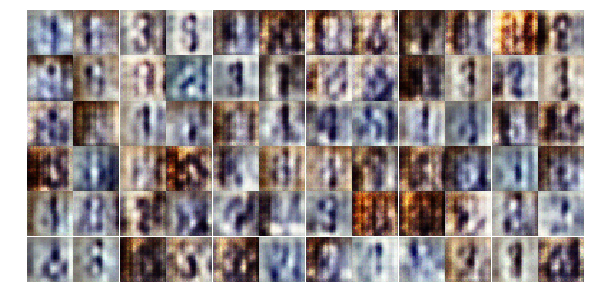

Epoch 1/25... Discriminator Loss: 0.6306... Generator Loss: 1.6263
Epoch 1/25... Discriminator Loss: 0.7211... Generator Loss: 0.9884
Epoch 1/25... Discriminator Loss: 0.5637... Generator Loss: 1.6280
Epoch 1/25... Discriminator Loss: 0.5431... Generator Loss: 1.5767
Epoch 1/25... Discriminator Loss: 0.5951... Generator Loss: 1.5785
Epoch 1/25... Discriminator Loss: 0.8707... Generator Loss: 1.1953
Epoch 1/25... Discriminator Loss: 0.7897... Generator Loss: 1.5173
Epoch 2/25... Discriminator Loss: 1.1440... Generator Loss: 1.2935
Epoch 2/25... Discriminator Loss: 1.4372... Generator Loss: 1.3397
Epoch 2/25... Discriminator Loss: 0.8280... Generator Loss: 1.0285


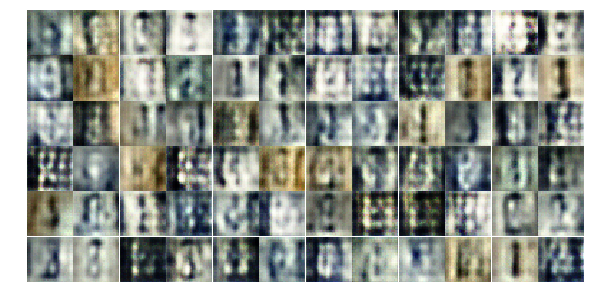

Epoch 2/25... Discriminator Loss: 1.0604... Generator Loss: 0.9868
Epoch 2/25... Discriminator Loss: 0.9408... Generator Loss: 1.3894
Epoch 2/25... Discriminator Loss: 1.0154... Generator Loss: 0.8905
Epoch 2/25... Discriminator Loss: 0.6332... Generator Loss: 1.6117
Epoch 2/25... Discriminator Loss: 1.1024... Generator Loss: 0.8869
Epoch 2/25... Discriminator Loss: 0.8620... Generator Loss: 1.2112
Epoch 2/25... Discriminator Loss: 0.8287... Generator Loss: 1.2154
Epoch 2/25... Discriminator Loss: 0.5235... Generator Loss: 2.0114
Epoch 2/25... Discriminator Loss: 0.7430... Generator Loss: 1.3702
Epoch 2/25... Discriminator Loss: 1.1135... Generator Loss: 0.7284


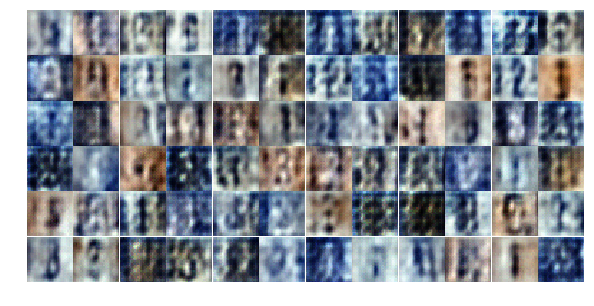

Epoch 2/25... Discriminator Loss: 0.9476... Generator Loss: 0.9602
Epoch 2/25... Discriminator Loss: 0.6688... Generator Loss: 1.8259
Epoch 2/25... Discriminator Loss: 0.6528... Generator Loss: 1.7240
Epoch 2/25... Discriminator Loss: 0.8843... Generator Loss: 1.7803
Epoch 2/25... Discriminator Loss: 0.8950... Generator Loss: 1.3543
Epoch 2/25... Discriminator Loss: 1.0896... Generator Loss: 0.9085
Epoch 2/25... Discriminator Loss: 1.5061... Generator Loss: 0.4177
Epoch 2/25... Discriminator Loss: 1.2644... Generator Loss: 0.6145
Epoch 2/25... Discriminator Loss: 1.3367... Generator Loss: 0.8896
Epoch 2/25... Discriminator Loss: 1.1121... Generator Loss: 0.7307


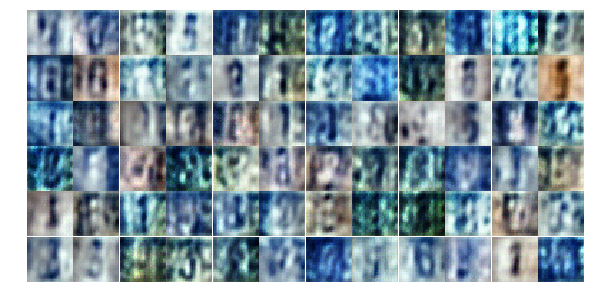

Epoch 2/25... Discriminator Loss: 1.1637... Generator Loss: 1.0214
Epoch 2/25... Discriminator Loss: 0.8292... Generator Loss: 1.4422
Epoch 2/25... Discriminator Loss: 0.7312... Generator Loss: 1.2196
Epoch 2/25... Discriminator Loss: 0.5184... Generator Loss: 2.1743
Epoch 2/25... Discriminator Loss: 0.5922... Generator Loss: 2.0427
Epoch 2/25... Discriminator Loss: 0.7833... Generator Loss: 1.4707
Epoch 2/25... Discriminator Loss: 1.2723... Generator Loss: 0.4082
Epoch 2/25... Discriminator Loss: 1.0661... Generator Loss: 0.6159
Epoch 2/25... Discriminator Loss: 0.5193... Generator Loss: 1.6160
Epoch 2/25... Discriminator Loss: 0.3351... Generator Loss: 2.5617


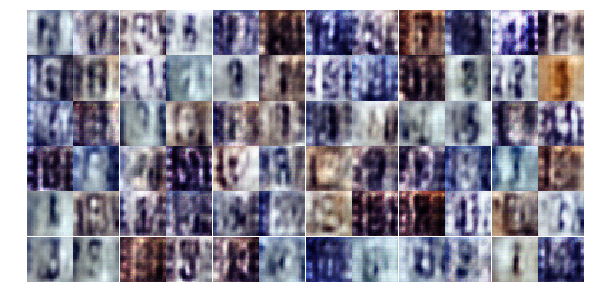

Epoch 2/25... Discriminator Loss: 0.6069... Generator Loss: 1.3192
Epoch 2/25... Discriminator Loss: 0.5095... Generator Loss: 1.7388
Epoch 2/25... Discriminator Loss: 1.5421... Generator Loss: 0.4696
Epoch 2/25... Discriminator Loss: 1.2253... Generator Loss: 0.6775
Epoch 2/25... Discriminator Loss: 0.9504... Generator Loss: 1.0840
Epoch 2/25... Discriminator Loss: 0.8882... Generator Loss: 1.1904
Epoch 2/25... Discriminator Loss: 1.5161... Generator Loss: 0.8833
Epoch 2/25... Discriminator Loss: 1.2199... Generator Loss: 0.9431
Epoch 2/25... Discriminator Loss: 1.5145... Generator Loss: 0.7103
Epoch 2/25... Discriminator Loss: 0.9912... Generator Loss: 0.9673


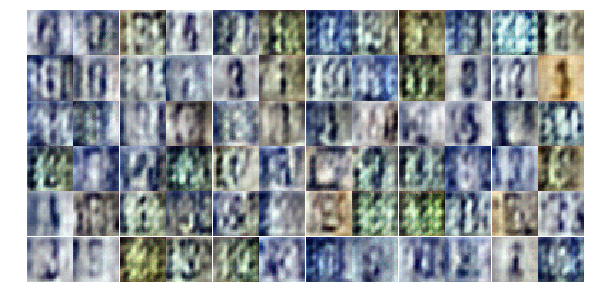

Epoch 2/25... Discriminator Loss: 0.8101... Generator Loss: 1.1942
Epoch 2/25... Discriminator Loss: 0.9327... Generator Loss: 1.0125
Epoch 2/25... Discriminator Loss: 1.0640... Generator Loss: 1.0448
Epoch 2/25... Discriminator Loss: 0.6294... Generator Loss: 1.8441
Epoch 2/25... Discriminator Loss: 0.7367... Generator Loss: 1.2357
Epoch 2/25... Discriminator Loss: 0.8482... Generator Loss: 0.9283
Epoch 2/25... Discriminator Loss: 1.1888... Generator Loss: 0.5604
Epoch 2/25... Discriminator Loss: 1.0286... Generator Loss: 0.8122
Epoch 2/25... Discriminator Loss: 0.7061... Generator Loss: 2.0253
Epoch 2/25... Discriminator Loss: 0.9139... Generator Loss: 0.9008


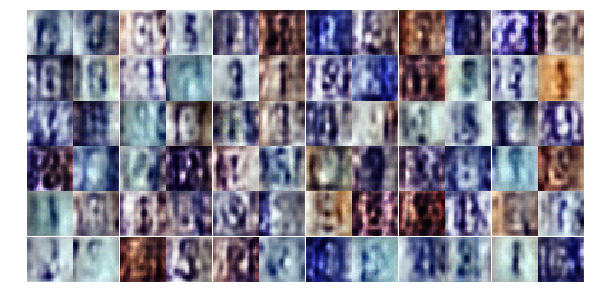

Epoch 2/25... Discriminator Loss: 0.5879... Generator Loss: 2.2598
Epoch 2/25... Discriminator Loss: 0.3790... Generator Loss: 2.1022
Epoch 2/25... Discriminator Loss: 1.6133... Generator Loss: 0.3458
Epoch 2/25... Discriminator Loss: 1.0308... Generator Loss: 1.3521
Epoch 3/25... Discriminator Loss: 0.7301... Generator Loss: 1.6013
Epoch 3/25... Discriminator Loss: 1.2303... Generator Loss: 0.7870
Epoch 3/25... Discriminator Loss: 1.2539... Generator Loss: 0.7128
Epoch 3/25... Discriminator Loss: 0.5628... Generator Loss: 1.4443
Epoch 3/25... Discriminator Loss: 0.9108... Generator Loss: 1.8479
Epoch 3/25... Discriminator Loss: 1.0652... Generator Loss: 0.9564


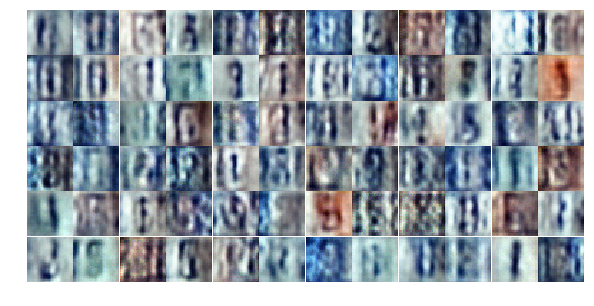

Epoch 3/25... Discriminator Loss: 0.5340... Generator Loss: 1.9093
Epoch 3/25... Discriminator Loss: 0.9268... Generator Loss: 1.4328
Epoch 3/25... Discriminator Loss: 1.0106... Generator Loss: 0.6624
Epoch 3/25... Discriminator Loss: 0.9217... Generator Loss: 1.0975
Epoch 3/25... Discriminator Loss: 0.3345... Generator Loss: 2.6173
Epoch 3/25... Discriminator Loss: 1.4230... Generator Loss: 0.8419
Epoch 3/25... Discriminator Loss: 1.3928... Generator Loss: 0.8771
Epoch 3/25... Discriminator Loss: 0.9728... Generator Loss: 1.0162
Epoch 3/25... Discriminator Loss: 1.3267... Generator Loss: 0.7570
Epoch 3/25... Discriminator Loss: 1.5350... Generator Loss: 0.6124


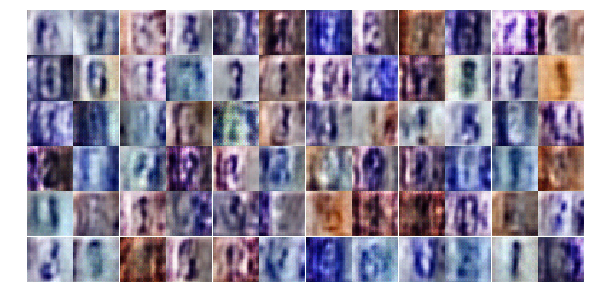

Epoch 3/25... Discriminator Loss: 1.4959... Generator Loss: 0.5104
Epoch 3/25... Discriminator Loss: 0.7875... Generator Loss: 1.6524
Epoch 3/25... Discriminator Loss: 0.7631... Generator Loss: 1.3166
Epoch 3/25... Discriminator Loss: 0.7299... Generator Loss: 1.1174
Epoch 3/25... Discriminator Loss: 0.8646... Generator Loss: 2.5426
Epoch 3/25... Discriminator Loss: 0.5393... Generator Loss: 1.5178
Epoch 3/25... Discriminator Loss: 1.0794... Generator Loss: 0.5461
Epoch 3/25... Discriminator Loss: 1.5946... Generator Loss: 0.2961
Epoch 3/25... Discriminator Loss: 0.4883... Generator Loss: 1.3423
Epoch 3/25... Discriminator Loss: 0.8858... Generator Loss: 0.9957


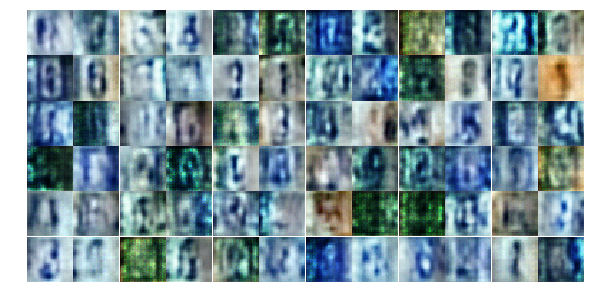

Epoch 3/25... Discriminator Loss: 0.8066... Generator Loss: 1.2797
Epoch 3/25... Discriminator Loss: 0.9791... Generator Loss: 1.0395
Epoch 3/25... Discriminator Loss: 0.7201... Generator Loss: 2.1249
Epoch 3/25... Discriminator Loss: 0.2758... Generator Loss: 2.3122
Epoch 3/25... Discriminator Loss: 0.4490... Generator Loss: 3.0354
Epoch 3/25... Discriminator Loss: 0.3331... Generator Loss: 2.7810
Epoch 3/25... Discriminator Loss: 0.9257... Generator Loss: 0.9797
Epoch 3/25... Discriminator Loss: 0.7654... Generator Loss: 2.0642
Epoch 3/25... Discriminator Loss: 0.3365... Generator Loss: 2.2207
Epoch 3/25... Discriminator Loss: 0.9598... Generator Loss: 0.7347


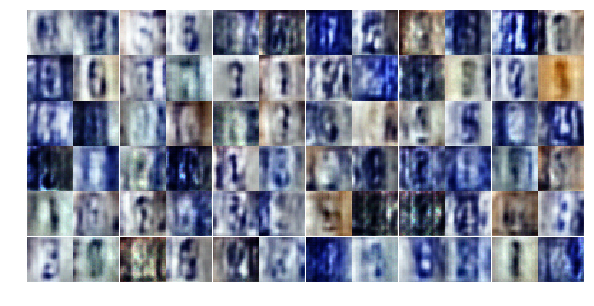

Epoch 3/25... Discriminator Loss: 2.0620... Generator Loss: 3.2215
Epoch 3/25... Discriminator Loss: 0.3324... Generator Loss: 2.6082
Epoch 3/25... Discriminator Loss: 0.7770... Generator Loss: 1.2804
Epoch 3/25... Discriminator Loss: 0.8301... Generator Loss: 0.8778
Epoch 3/25... Discriminator Loss: 0.5678... Generator Loss: 1.5567
Epoch 3/25... Discriminator Loss: 0.6956... Generator Loss: 1.0077
Epoch 3/25... Discriminator Loss: 0.6022... Generator Loss: 1.2487
Epoch 3/25... Discriminator Loss: 1.0279... Generator Loss: 0.8970
Epoch 3/25... Discriminator Loss: 0.8297... Generator Loss: 1.0683
Epoch 3/25... Discriminator Loss: 0.6903... Generator Loss: 1.1845


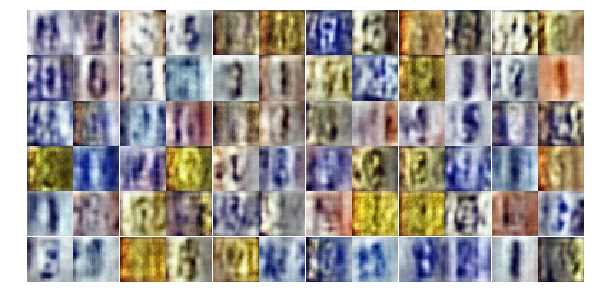

Epoch 3/25... Discriminator Loss: 0.8312... Generator Loss: 0.9302
Epoch 3/25... Discriminator Loss: 0.6153... Generator Loss: 1.3037
Epoch 3/25... Discriminator Loss: 1.6636... Generator Loss: 0.2761
Epoch 3/25... Discriminator Loss: 0.7201... Generator Loss: 1.1997
Epoch 3/25... Discriminator Loss: 1.4570... Generator Loss: 2.4480
Epoch 3/25... Discriminator Loss: 0.7785... Generator Loss: 0.8693
Epoch 3/25... Discriminator Loss: 0.7197... Generator Loss: 1.6853
Epoch 3/25... Discriminator Loss: 0.4121... Generator Loss: 2.9733
Epoch 3/25... Discriminator Loss: 0.6531... Generator Loss: 1.6473
Epoch 3/25... Discriminator Loss: 0.2702... Generator Loss: 2.5517


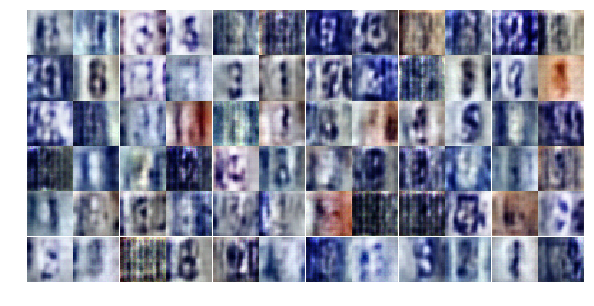

Epoch 3/25... Discriminator Loss: 0.7911... Generator Loss: 1.0544
Epoch 4/25... Discriminator Loss: 0.8711... Generator Loss: 1.8075
Epoch 4/25... Discriminator Loss: 0.7013... Generator Loss: 1.9819
Epoch 4/25... Discriminator Loss: 0.8629... Generator Loss: 0.7001
Epoch 4/25... Discriminator Loss: 1.0951... Generator Loss: 2.0056
Epoch 4/25... Discriminator Loss: 0.4651... Generator Loss: 1.9479
Epoch 4/25... Discriminator Loss: 0.7571... Generator Loss: 1.0261
Epoch 4/25... Discriminator Loss: 1.1412... Generator Loss: 0.6165
Epoch 4/25... Discriminator Loss: 2.5261... Generator Loss: 0.2079
Epoch 4/25... Discriminator Loss: 1.2589... Generator Loss: 0.8818


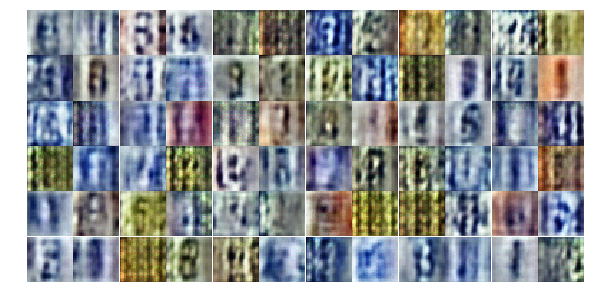

Epoch 4/25... Discriminator Loss: 0.5803... Generator Loss: 1.4452
Epoch 4/25... Discriminator Loss: 1.4309... Generator Loss: 0.3846
Epoch 4/25... Discriminator Loss: 1.2049... Generator Loss: 0.9233
Epoch 4/25... Discriminator Loss: 0.5971... Generator Loss: 2.5175
Epoch 4/25... Discriminator Loss: 0.9271... Generator Loss: 0.9942
Epoch 4/25... Discriminator Loss: 0.8746... Generator Loss: 1.1534
Epoch 4/25... Discriminator Loss: 0.7650... Generator Loss: 1.1199
Epoch 4/25... Discriminator Loss: 0.6564... Generator Loss: 1.3880
Epoch 4/25... Discriminator Loss: 0.7361... Generator Loss: 1.0947
Epoch 4/25... Discriminator Loss: 0.8539... Generator Loss: 1.4970


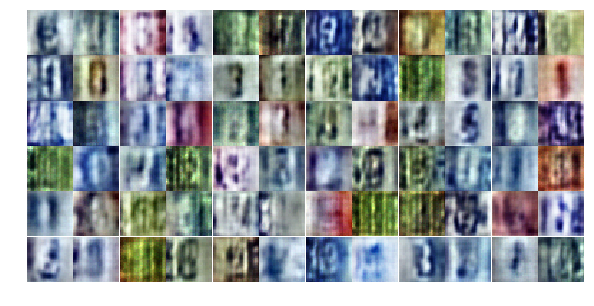

Epoch 4/25... Discriminator Loss: 0.6807... Generator Loss: 1.6686
Epoch 4/25... Discriminator Loss: 0.5198... Generator Loss: 1.8291
Epoch 4/25... Discriminator Loss: 0.7048... Generator Loss: 1.0023
Epoch 4/25... Discriminator Loss: 0.8577... Generator Loss: 1.3928
Epoch 4/25... Discriminator Loss: 0.6770... Generator Loss: 1.9555
Epoch 4/25... Discriminator Loss: 0.7787... Generator Loss: 1.1790
Epoch 4/25... Discriminator Loss: 1.6269... Generator Loss: 0.4030
Epoch 4/25... Discriminator Loss: 0.5254... Generator Loss: 1.9993
Epoch 4/25... Discriminator Loss: 0.5212... Generator Loss: 1.4730
Epoch 4/25... Discriminator Loss: 0.6221... Generator Loss: 1.2207


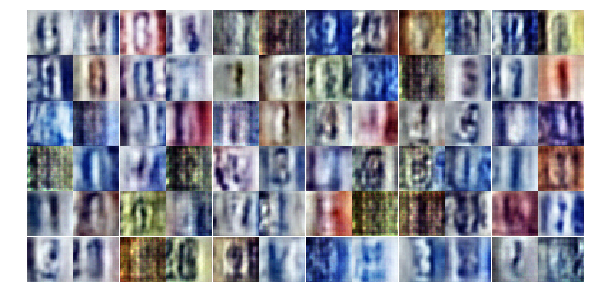

Epoch 4/25... Discriminator Loss: 0.8923... Generator Loss: 0.7888
Epoch 4/25... Discriminator Loss: 0.4617... Generator Loss: 1.9693
Epoch 4/25... Discriminator Loss: 0.7228... Generator Loss: 1.0886
Epoch 4/25... Discriminator Loss: 1.3137... Generator Loss: 0.5422
Epoch 4/25... Discriminator Loss: 0.4147... Generator Loss: 2.1403
Epoch 4/25... Discriminator Loss: 0.5635... Generator Loss: 1.3622
Epoch 4/25... Discriminator Loss: 0.8088... Generator Loss: 2.9209
Epoch 4/25... Discriminator Loss: 1.1198... Generator Loss: 0.5423
Epoch 4/25... Discriminator Loss: 0.3130... Generator Loss: 2.4676
Epoch 4/25... Discriminator Loss: 0.7175... Generator Loss: 1.0883


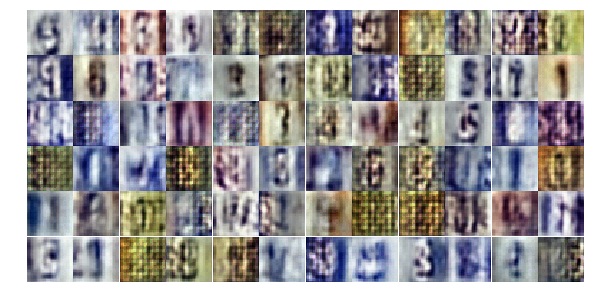

Epoch 4/25... Discriminator Loss: 1.1103... Generator Loss: 0.6642
Epoch 4/25... Discriminator Loss: 0.5014... Generator Loss: 1.3256
Epoch 4/25... Discriminator Loss: 1.0974... Generator Loss: 1.9103
Epoch 4/25... Discriminator Loss: 0.4111... Generator Loss: 1.7694
Epoch 4/25... Discriminator Loss: 0.5934... Generator Loss: 2.8596
Epoch 4/25... Discriminator Loss: 1.3092... Generator Loss: 0.7240
Epoch 4/25... Discriminator Loss: 0.6530... Generator Loss: 1.1860
Epoch 4/25... Discriminator Loss: 0.6696... Generator Loss: 1.1818
Epoch 4/25... Discriminator Loss: 0.7817... Generator Loss: 1.5341
Epoch 4/25... Discriminator Loss: 0.6873... Generator Loss: 1.5232


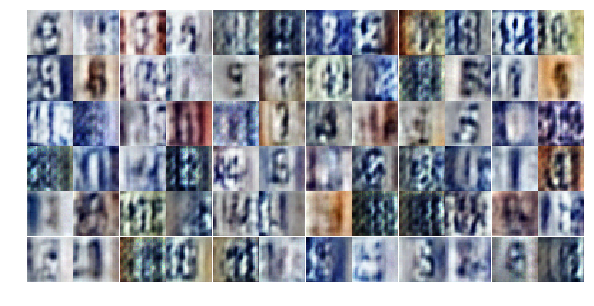

Epoch 4/25... Discriminator Loss: 0.6368... Generator Loss: 1.5483
Epoch 4/25... Discriminator Loss: 0.7464... Generator Loss: 1.6616
Epoch 4/25... Discriminator Loss: 0.5982... Generator Loss: 1.5058
Epoch 4/25... Discriminator Loss: 0.7168... Generator Loss: 1.1329
Epoch 4/25... Discriminator Loss: 0.6545... Generator Loss: 1.4173
Epoch 4/25... Discriminator Loss: 0.6390... Generator Loss: 1.2672
Epoch 4/25... Discriminator Loss: 0.3784... Generator Loss: 1.7746
Epoch 4/25... Discriminator Loss: 0.6192... Generator Loss: 1.4365
Epoch 4/25... Discriminator Loss: 0.6307... Generator Loss: 1.5489
Epoch 5/25... Discriminator Loss: 0.6157... Generator Loss: 1.7660


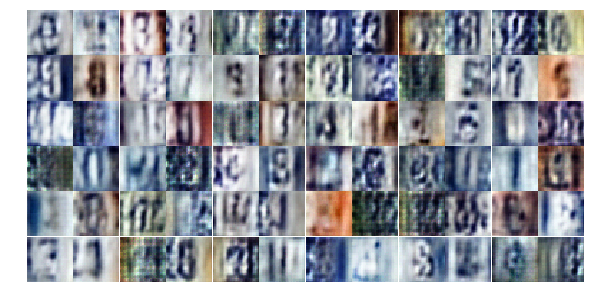

Epoch 5/25... Discriminator Loss: 0.5227... Generator Loss: 1.4245
Epoch 5/25... Discriminator Loss: 0.4026... Generator Loss: 1.6197
Epoch 5/25... Discriminator Loss: 0.5934... Generator Loss: 1.1099
Epoch 5/25... Discriminator Loss: 0.4145... Generator Loss: 1.3756
Epoch 5/25... Discriminator Loss: 0.6968... Generator Loss: 1.1601
Epoch 5/25... Discriminator Loss: 0.8524... Generator Loss: 0.9243
Epoch 5/25... Discriminator Loss: 0.6197... Generator Loss: 1.6111
Epoch 5/25... Discriminator Loss: 0.5026... Generator Loss: 1.6662
Epoch 5/25... Discriminator Loss: 0.7126... Generator Loss: 1.4317
Epoch 5/25... Discriminator Loss: 0.7975... Generator Loss: 1.1275


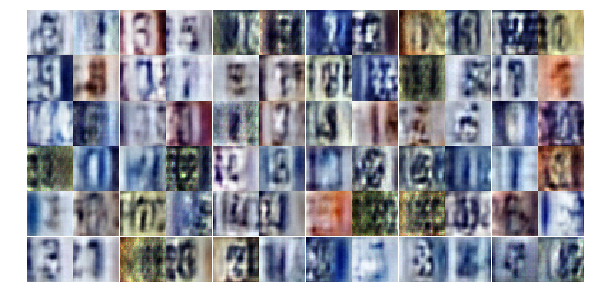

Epoch 5/25... Discriminator Loss: 0.6840... Generator Loss: 1.7000
Epoch 5/25... Discriminator Loss: 0.5949... Generator Loss: 1.3321
Epoch 5/25... Discriminator Loss: 0.4458... Generator Loss: 1.6833
Epoch 5/25... Discriminator Loss: 0.6995... Generator Loss: 1.1963
Epoch 5/25... Discriminator Loss: 0.9356... Generator Loss: 0.8097
Epoch 5/25... Discriminator Loss: 1.0678... Generator Loss: 0.6547
Epoch 5/25... Discriminator Loss: 0.7190... Generator Loss: 1.0346
Epoch 5/25... Discriminator Loss: 0.9791... Generator Loss: 0.7300
Epoch 5/25... Discriminator Loss: 0.3785... Generator Loss: 1.8289
Epoch 5/25... Discriminator Loss: 0.3248... Generator Loss: 2.6622


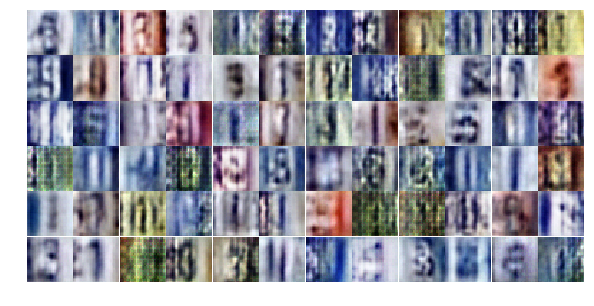

Epoch 5/25... Discriminator Loss: 0.5157... Generator Loss: 1.4555
Epoch 5/25... Discriminator Loss: 0.5721... Generator Loss: 2.1946
Epoch 5/25... Discriminator Loss: 0.6149... Generator Loss: 1.1720
Epoch 5/25... Discriminator Loss: 0.4918... Generator Loss: 1.9408
Epoch 5/25... Discriminator Loss: 1.4231... Generator Loss: 0.4750
Epoch 5/25... Discriminator Loss: 0.7341... Generator Loss: 0.8294
Epoch 5/25... Discriminator Loss: 0.5567... Generator Loss: 1.2965
Epoch 5/25... Discriminator Loss: 0.3827... Generator Loss: 2.4150
Epoch 5/25... Discriminator Loss: 0.6893... Generator Loss: 1.2723
Epoch 5/25... Discriminator Loss: 0.5210... Generator Loss: 1.4277


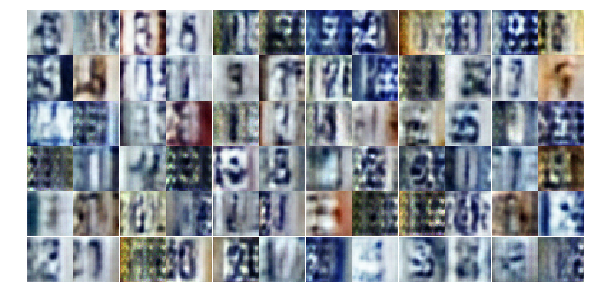

Epoch 5/25... Discriminator Loss: 0.5694... Generator Loss: 1.4613
Epoch 5/25... Discriminator Loss: 0.3309... Generator Loss: 1.8344
Epoch 5/25... Discriminator Loss: 0.5135... Generator Loss: 2.5371
Epoch 5/25... Discriminator Loss: 0.6249... Generator Loss: 2.0428
Epoch 5/25... Discriminator Loss: 0.5035... Generator Loss: 1.9151
Epoch 5/25... Discriminator Loss: 0.8186... Generator Loss: 2.8021
Epoch 5/25... Discriminator Loss: 0.7513... Generator Loss: 1.5574
Epoch 5/25... Discriminator Loss: 0.4674... Generator Loss: 1.7159
Epoch 5/25... Discriminator Loss: 0.8563... Generator Loss: 0.8341
Epoch 5/25... Discriminator Loss: 0.5424... Generator Loss: 1.2717


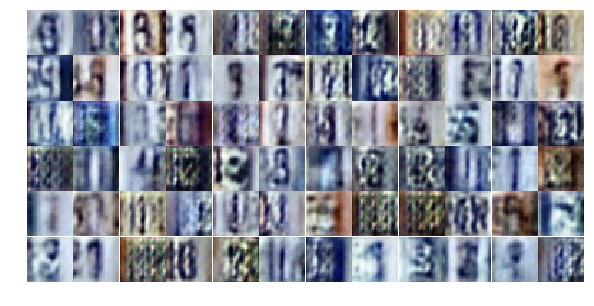

Epoch 5/25... Discriminator Loss: 0.3741... Generator Loss: 1.8120
Epoch 5/25... Discriminator Loss: 0.3621... Generator Loss: 2.0576
Epoch 5/25... Discriminator Loss: 1.2069... Generator Loss: 0.5498
Epoch 5/25... Discriminator Loss: 0.5647... Generator Loss: 1.2336
Epoch 5/25... Discriminator Loss: 0.7132... Generator Loss: 0.9777
Epoch 5/25... Discriminator Loss: 1.2916... Generator Loss: 0.4298
Epoch 5/25... Discriminator Loss: 0.6074... Generator Loss: 1.3855
Epoch 5/25... Discriminator Loss: 0.6013... Generator Loss: 2.0712
Epoch 5/25... Discriminator Loss: 0.5898... Generator Loss: 1.8288
Epoch 5/25... Discriminator Loss: 0.4481... Generator Loss: 1.6324


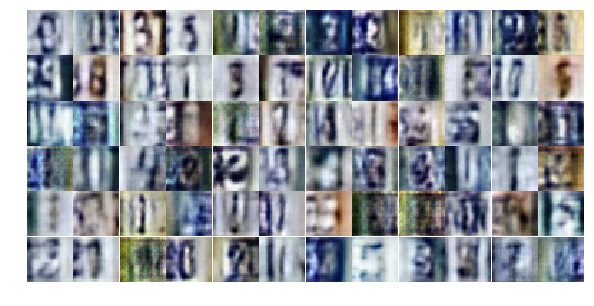

Epoch 5/25... Discriminator Loss: 0.6906... Generator Loss: 1.0019
Epoch 5/25... Discriminator Loss: 0.6309... Generator Loss: 1.4590
Epoch 5/25... Discriminator Loss: 0.6694... Generator Loss: 2.5458
Epoch 5/25... Discriminator Loss: 0.7663... Generator Loss: 3.1420
Epoch 5/25... Discriminator Loss: 0.3201... Generator Loss: 2.2242
Epoch 5/25... Discriminator Loss: 0.6644... Generator Loss: 1.9677
Epoch 6/25... Discriminator Loss: 0.5401... Generator Loss: 1.3344
Epoch 6/25... Discriminator Loss: 0.3642... Generator Loss: 1.6178
Epoch 6/25... Discriminator Loss: 0.2823... Generator Loss: 2.4813
Epoch 6/25... Discriminator Loss: 1.7787... Generator Loss: 0.2574


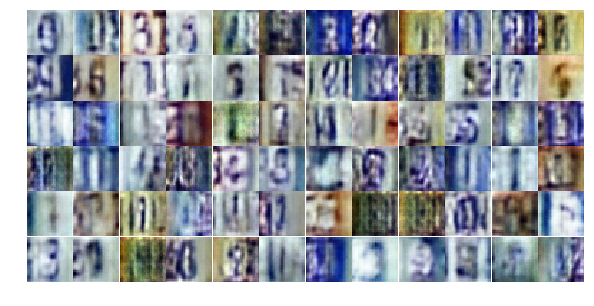

Epoch 6/25... Discriminator Loss: 0.6418... Generator Loss: 1.1051
Epoch 6/25... Discriminator Loss: 0.5421... Generator Loss: 2.3510
Epoch 6/25... Discriminator Loss: 0.5080... Generator Loss: 1.2766
Epoch 6/25... Discriminator Loss: 0.6073... Generator Loss: 1.1242
Epoch 6/25... Discriminator Loss: 0.5032... Generator Loss: 1.3809
Epoch 6/25... Discriminator Loss: 0.2787... Generator Loss: 1.9144
Epoch 6/25... Discriminator Loss: 0.4630... Generator Loss: 1.8334
Epoch 6/25... Discriminator Loss: 0.3908... Generator Loss: 1.6434
Epoch 6/25... Discriminator Loss: 1.9760... Generator Loss: 4.0859
Epoch 6/25... Discriminator Loss: 0.5594... Generator Loss: 1.1684


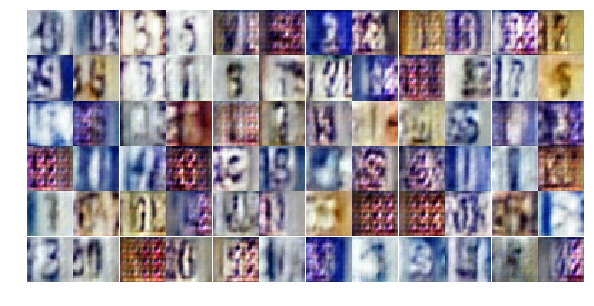

Epoch 6/25... Discriminator Loss: 0.5299... Generator Loss: 1.6788
Epoch 6/25... Discriminator Loss: 1.1441... Generator Loss: 1.9780
Epoch 6/25... Discriminator Loss: 1.4589... Generator Loss: 0.3844
Epoch 6/25... Discriminator Loss: 0.6137... Generator Loss: 1.1580
Epoch 6/25... Discriminator Loss: 0.4276... Generator Loss: 2.5382
Epoch 6/25... Discriminator Loss: 0.5658... Generator Loss: 1.6466
Epoch 6/25... Discriminator Loss: 0.4170... Generator Loss: 1.5544
Epoch 6/25... Discriminator Loss: 0.5701... Generator Loss: 1.1550
Epoch 6/25... Discriminator Loss: 0.5045... Generator Loss: 2.5697
Epoch 6/25... Discriminator Loss: 1.3570... Generator Loss: 0.5340


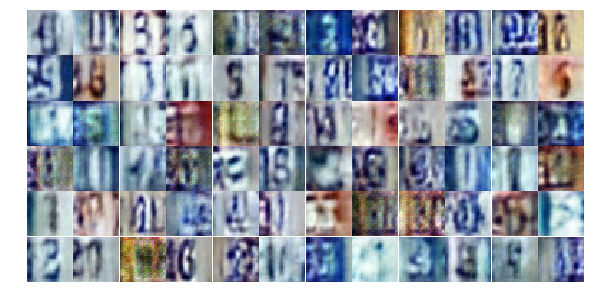

Epoch 6/25... Discriminator Loss: 0.8844... Generator Loss: 0.7186
Epoch 6/25... Discriminator Loss: 0.4985... Generator Loss: 1.6442
Epoch 6/25... Discriminator Loss: 0.5351... Generator Loss: 1.6323
Epoch 6/25... Discriminator Loss: 0.5392... Generator Loss: 1.3673
Epoch 6/25... Discriminator Loss: 0.7648... Generator Loss: 3.0585
Epoch 6/25... Discriminator Loss: 0.8106... Generator Loss: 1.4503
Epoch 6/25... Discriminator Loss: 0.5699... Generator Loss: 1.2179
Epoch 6/25... Discriminator Loss: 0.3445... Generator Loss: 1.8149
Epoch 6/25... Discriminator Loss: 0.3596... Generator Loss: 1.9139
Epoch 6/25... Discriminator Loss: 0.3611... Generator Loss: 1.9615


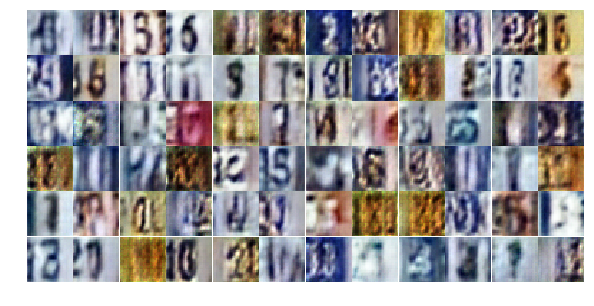

Epoch 6/25... Discriminator Loss: 1.2872... Generator Loss: 0.5163
Epoch 6/25... Discriminator Loss: 0.6615... Generator Loss: 2.1903
Epoch 6/25... Discriminator Loss: 0.5614... Generator Loss: 1.3580
Epoch 6/25... Discriminator Loss: 0.3441... Generator Loss: 2.1948
Epoch 6/25... Discriminator Loss: 0.3877... Generator Loss: 1.5856
Epoch 6/25... Discriminator Loss: 0.3526... Generator Loss: 1.9078
Epoch 6/25... Discriminator Loss: 0.5839... Generator Loss: 1.1896
Epoch 6/25... Discriminator Loss: 0.4601... Generator Loss: 2.5385
Epoch 6/25... Discriminator Loss: 1.3868... Generator Loss: 0.4694
Epoch 6/25... Discriminator Loss: 0.4394... Generator Loss: 1.4094


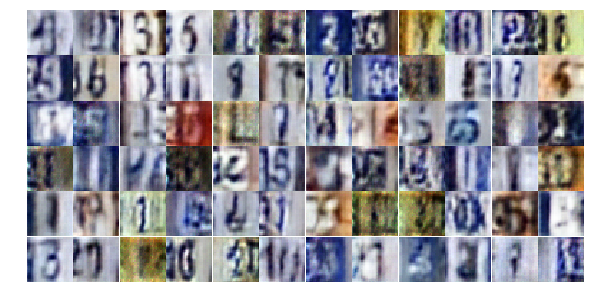

Epoch 6/25... Discriminator Loss: 2.7769... Generator Loss: 4.8494
Epoch 6/25... Discriminator Loss: 1.0047... Generator Loss: 1.2071
Epoch 6/25... Discriminator Loss: 0.9741... Generator Loss: 0.7198
Epoch 6/25... Discriminator Loss: 0.4413... Generator Loss: 1.6690
Epoch 6/25... Discriminator Loss: 0.4869... Generator Loss: 2.1238
Epoch 6/25... Discriminator Loss: 0.4299... Generator Loss: 1.4291
Epoch 6/25... Discriminator Loss: 0.9614... Generator Loss: 0.6823
Epoch 6/25... Discriminator Loss: 1.1873... Generator Loss: 0.5315
Epoch 6/25... Discriminator Loss: 0.7842... Generator Loss: 0.9015
Epoch 6/25... Discriminator Loss: 1.0462... Generator Loss: 1.1734


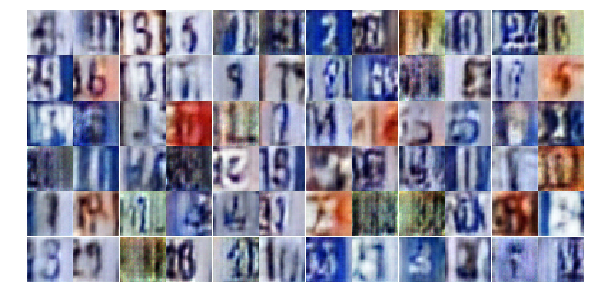

Epoch 6/25... Discriminator Loss: 0.4375... Generator Loss: 1.4777
Epoch 6/25... Discriminator Loss: 0.5085... Generator Loss: 1.2626
Epoch 6/25... Discriminator Loss: 0.4177... Generator Loss: 1.5920
Epoch 7/25... Discriminator Loss: 0.6314... Generator Loss: 2.0136
Epoch 7/25... Discriminator Loss: 0.8066... Generator Loss: 0.8266
Epoch 7/25... Discriminator Loss: 0.5638... Generator Loss: 1.7806
Epoch 7/25... Discriminator Loss: 0.6538... Generator Loss: 0.9919
Epoch 7/25... Discriminator Loss: 0.3326... Generator Loss: 1.8721
Epoch 7/25... Discriminator Loss: 1.0413... Generator Loss: 0.9153
Epoch 7/25... Discriminator Loss: 0.8102... Generator Loss: 0.9906


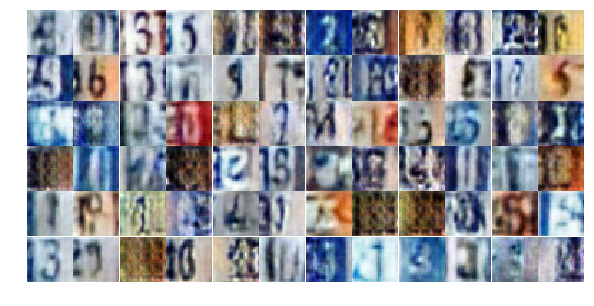

Epoch 7/25... Discriminator Loss: 0.5769... Generator Loss: 1.2318
Epoch 7/25... Discriminator Loss: 0.8406... Generator Loss: 0.7887
Epoch 7/25... Discriminator Loss: 0.7564... Generator Loss: 1.0132
Epoch 7/25... Discriminator Loss: 0.6582... Generator Loss: 1.1924
Epoch 7/25... Discriminator Loss: 0.4073... Generator Loss: 1.6640
Epoch 7/25... Discriminator Loss: 0.4779... Generator Loss: 1.5678
Epoch 7/25... Discriminator Loss: 0.5827... Generator Loss: 1.7315
Epoch 7/25... Discriminator Loss: 0.9130... Generator Loss: 2.3117
Epoch 7/25... Discriminator Loss: 1.1845... Generator Loss: 2.8318
Epoch 7/25... Discriminator Loss: 0.5103... Generator Loss: 1.9130


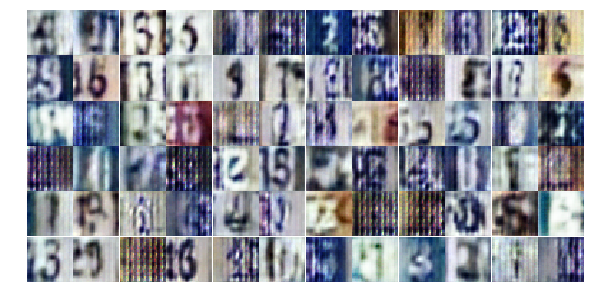

Epoch 7/25... Discriminator Loss: 0.6872... Generator Loss: 1.5146
Epoch 7/25... Discriminator Loss: 0.5554... Generator Loss: 1.3781
Epoch 7/25... Discriminator Loss: 0.9027... Generator Loss: 0.6965
Epoch 7/25... Discriminator Loss: 0.5886... Generator Loss: 1.2428
Epoch 7/25... Discriminator Loss: 0.5537... Generator Loss: 1.5115
Epoch 7/25... Discriminator Loss: 0.5805... Generator Loss: 1.2710
Epoch 7/25... Discriminator Loss: 0.7281... Generator Loss: 0.9144
Epoch 7/25... Discriminator Loss: 1.5776... Generator Loss: 0.3139
Epoch 7/25... Discriminator Loss: 0.4257... Generator Loss: 1.8739
Epoch 7/25... Discriminator Loss: 0.4558... Generator Loss: 1.8653


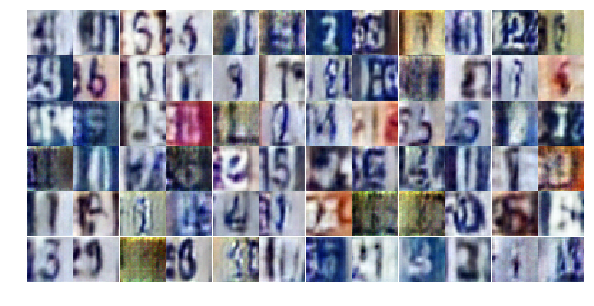

Epoch 7/25... Discriminator Loss: 0.7775... Generator Loss: 0.8823
Epoch 7/25... Discriminator Loss: 1.0216... Generator Loss: 0.6137
Epoch 7/25... Discriminator Loss: 0.5257... Generator Loss: 1.4815
Epoch 7/25... Discriminator Loss: 0.7123... Generator Loss: 0.9523
Epoch 7/25... Discriminator Loss: 0.8027... Generator Loss: 0.8213
Epoch 7/25... Discriminator Loss: 1.3687... Generator Loss: 0.4580
Epoch 7/25... Discriminator Loss: 0.9548... Generator Loss: 0.6483
Epoch 7/25... Discriminator Loss: 0.4885... Generator Loss: 1.6222
Epoch 7/25... Discriminator Loss: 0.8007... Generator Loss: 0.9051
Epoch 7/25... Discriminator Loss: 0.5698... Generator Loss: 2.5600


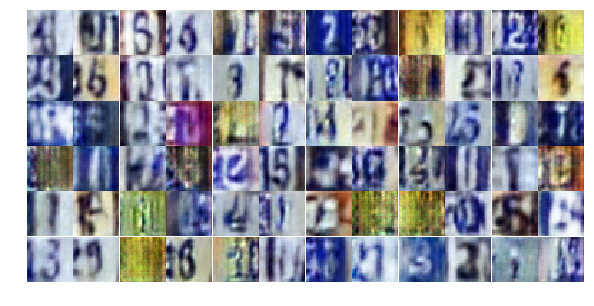

Epoch 7/25... Discriminator Loss: 0.9782... Generator Loss: 1.2242
Epoch 7/25... Discriminator Loss: 0.7214... Generator Loss: 1.2364
Epoch 7/25... Discriminator Loss: 0.3956... Generator Loss: 1.6377
Epoch 7/25... Discriminator Loss: 0.6398... Generator Loss: 1.6565
Epoch 7/25... Discriminator Loss: 0.7688... Generator Loss: 0.8385
Epoch 7/25... Discriminator Loss: 0.4063... Generator Loss: 1.6156
Epoch 7/25... Discriminator Loss: 0.7942... Generator Loss: 0.8618
Epoch 7/25... Discriminator Loss: 0.9194... Generator Loss: 1.0566
Epoch 7/25... Discriminator Loss: 0.3980... Generator Loss: 1.8886
Epoch 7/25... Discriminator Loss: 0.6693... Generator Loss: 1.1201


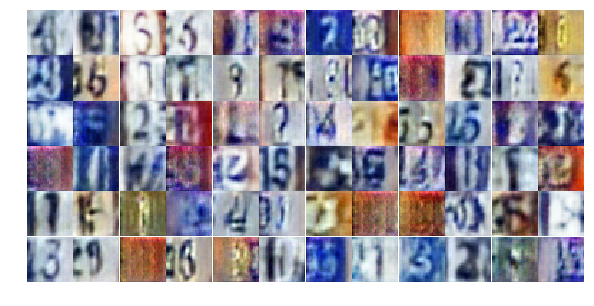

Epoch 7/25... Discriminator Loss: 0.4738... Generator Loss: 1.9881
Epoch 7/25... Discriminator Loss: 0.9338... Generator Loss: 1.5521
Epoch 7/25... Discriminator Loss: 0.9171... Generator Loss: 0.8711
Epoch 7/25... Discriminator Loss: 0.5206... Generator Loss: 1.3008
Epoch 7/25... Discriminator Loss: 0.5950... Generator Loss: 1.2621
Epoch 7/25... Discriminator Loss: 0.7043... Generator Loss: 1.3806
Epoch 7/25... Discriminator Loss: 1.2582... Generator Loss: 0.4450
Epoch 7/25... Discriminator Loss: 0.6205... Generator Loss: 1.6981
Epoch 7/25... Discriminator Loss: 0.6524... Generator Loss: 2.2267
Epoch 7/25... Discriminator Loss: 0.5686... Generator Loss: 1.3469


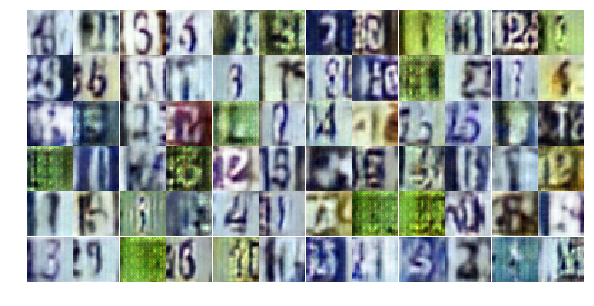

Epoch 7/25... Discriminator Loss: 0.5157... Generator Loss: 1.5372
Epoch 8/25... Discriminator Loss: 0.6228... Generator Loss: 1.1915
Epoch 8/25... Discriminator Loss: 0.8533... Generator Loss: 0.7147
Epoch 8/25... Discriminator Loss: 0.5397... Generator Loss: 1.2913
Epoch 8/25... Discriminator Loss: 1.1987... Generator Loss: 3.4107
Epoch 8/25... Discriminator Loss: 0.7542... Generator Loss: 1.0542
Epoch 8/25... Discriminator Loss: 0.7620... Generator Loss: 0.8641
Epoch 8/25... Discriminator Loss: 0.4004... Generator Loss: 1.5869
Epoch 8/25... Discriminator Loss: 0.8372... Generator Loss: 0.8105
Epoch 8/25... Discriminator Loss: 0.5062... Generator Loss: 1.3986


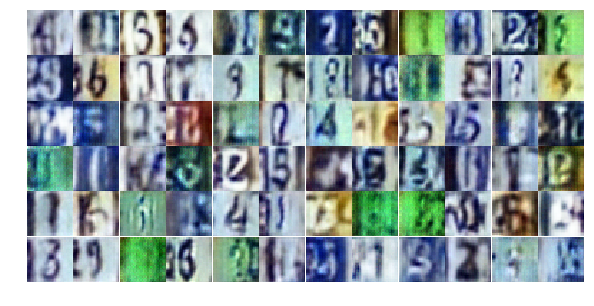

Epoch 8/25... Discriminator Loss: 0.4054... Generator Loss: 1.9261
Epoch 8/25... Discriminator Loss: 0.9229... Generator Loss: 3.0889
Epoch 8/25... Discriminator Loss: 1.0001... Generator Loss: 0.6488
Epoch 8/25... Discriminator Loss: 0.3865... Generator Loss: 2.1327
Epoch 8/25... Discriminator Loss: 2.8285... Generator Loss: 0.1613
Epoch 8/25... Discriminator Loss: 1.2979... Generator Loss: 0.4850
Epoch 8/25... Discriminator Loss: 0.8738... Generator Loss: 0.8388
Epoch 8/25... Discriminator Loss: 0.5742... Generator Loss: 1.5185
Epoch 8/25... Discriminator Loss: 0.6740... Generator Loss: 1.0474
Epoch 8/25... Discriminator Loss: 1.2541... Generator Loss: 0.4804


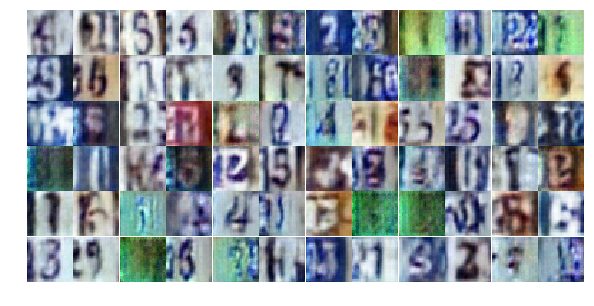

Epoch 8/25... Discriminator Loss: 0.5164... Generator Loss: 1.5981
Epoch 8/25... Discriminator Loss: 0.4697... Generator Loss: 1.5555
Epoch 8/25... Discriminator Loss: 0.7436... Generator Loss: 1.0071
Epoch 8/25... Discriminator Loss: 0.5806... Generator Loss: 1.2348
Epoch 8/25... Discriminator Loss: 0.4588... Generator Loss: 1.9446
Epoch 8/25... Discriminator Loss: 0.7326... Generator Loss: 2.2451
Epoch 8/25... Discriminator Loss: 0.5413... Generator Loss: 1.2938
Epoch 8/25... Discriminator Loss: 0.4369... Generator Loss: 1.4824
Epoch 8/25... Discriminator Loss: 0.9822... Generator Loss: 2.6716
Epoch 8/25... Discriminator Loss: 0.6086... Generator Loss: 1.2554


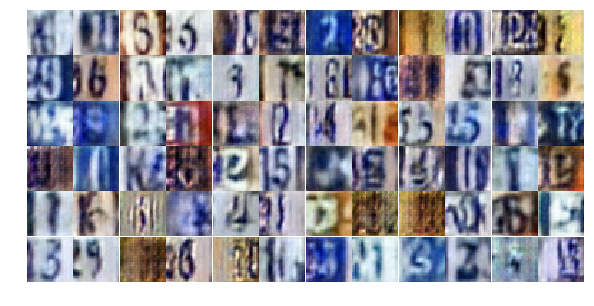

Epoch 8/25... Discriminator Loss: 1.4400... Generator Loss: 0.3884
Epoch 8/25... Discriminator Loss: 1.1838... Generator Loss: 0.5018
Epoch 8/25... Discriminator Loss: 0.5597... Generator Loss: 1.7000
Epoch 8/25... Discriminator Loss: 0.8234... Generator Loss: 0.8287
Epoch 8/25... Discriminator Loss: 0.5309... Generator Loss: 1.4462
Epoch 8/25... Discriminator Loss: 0.6160... Generator Loss: 1.3544
Epoch 8/25... Discriminator Loss: 0.3816... Generator Loss: 2.0206
Epoch 8/25... Discriminator Loss: 0.5088... Generator Loss: 1.4655
Epoch 8/25... Discriminator Loss: 0.5203... Generator Loss: 1.4152
Epoch 8/25... Discriminator Loss: 0.6003... Generator Loss: 1.2730


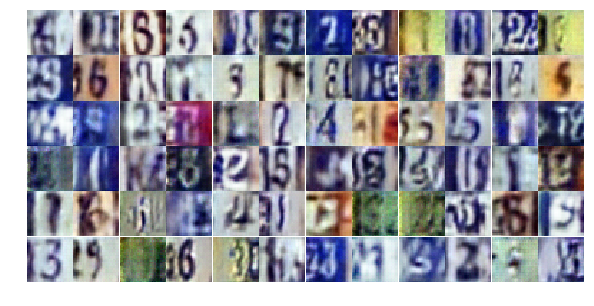

Epoch 8/25... Discriminator Loss: 0.4772... Generator Loss: 1.5828
Epoch 8/25... Discriminator Loss: 0.9208... Generator Loss: 0.7312
Epoch 8/25... Discriminator Loss: 0.4938... Generator Loss: 1.2806
Epoch 8/25... Discriminator Loss: 0.3419... Generator Loss: 1.8255
Epoch 8/25... Discriminator Loss: 2.0272... Generator Loss: 2.9013
Epoch 8/25... Discriminator Loss: 0.8098... Generator Loss: 0.8090
Epoch 8/25... Discriminator Loss: 0.4195... Generator Loss: 1.6239
Epoch 8/25... Discriminator Loss: 0.4061... Generator Loss: 1.7862
Epoch 8/25... Discriminator Loss: 0.6478... Generator Loss: 1.3174
Epoch 8/25... Discriminator Loss: 0.7790... Generator Loss: 1.2320


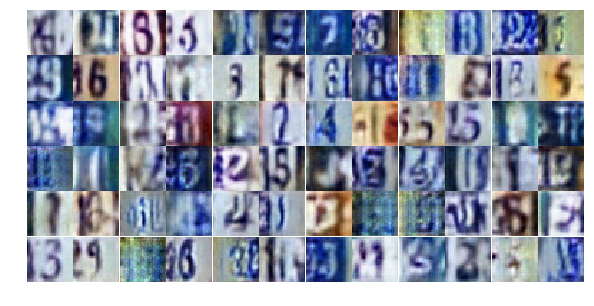

Epoch 8/25... Discriminator Loss: 0.3610... Generator Loss: 2.1012
Epoch 8/25... Discriminator Loss: 0.5393... Generator Loss: 1.2531
Epoch 8/25... Discriminator Loss: 0.4171... Generator Loss: 1.4471
Epoch 8/25... Discriminator Loss: 1.3161... Generator Loss: 0.5117
Epoch 8/25... Discriminator Loss: 0.4235... Generator Loss: 1.5850
Epoch 8/25... Discriminator Loss: 1.0255... Generator Loss: 0.6145
Epoch 8/25... Discriminator Loss: 0.5503... Generator Loss: 1.2252
Epoch 8/25... Discriminator Loss: 0.5487... Generator Loss: 1.6073
Epoch 9/25... Discriminator Loss: 0.7955... Generator Loss: 1.2519
Epoch 9/25... Discriminator Loss: 0.6664... Generator Loss: 0.9795


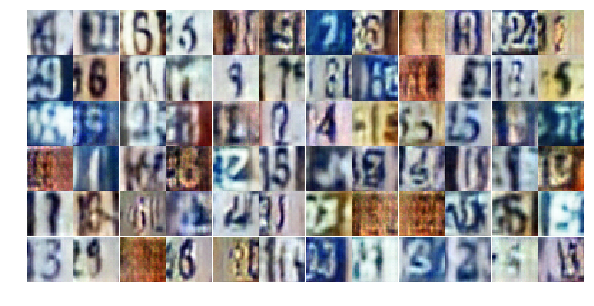

Epoch 9/25... Discriminator Loss: 0.8823... Generator Loss: 0.7598
Epoch 9/25... Discriminator Loss: 0.5196... Generator Loss: 1.2164
Epoch 9/25... Discriminator Loss: 0.8731... Generator Loss: 1.7054
Epoch 9/25... Discriminator Loss: 0.6636... Generator Loss: 1.0692
Epoch 9/25... Discriminator Loss: 0.8324... Generator Loss: 0.8356
Epoch 9/25... Discriminator Loss: 0.4961... Generator Loss: 2.5436
Epoch 9/25... Discriminator Loss: 0.6325... Generator Loss: 1.4261
Epoch 9/25... Discriminator Loss: 0.5040... Generator Loss: 1.4037
Epoch 9/25... Discriminator Loss: 0.8381... Generator Loss: 0.8209
Epoch 9/25... Discriminator Loss: 0.7089... Generator Loss: 1.4721


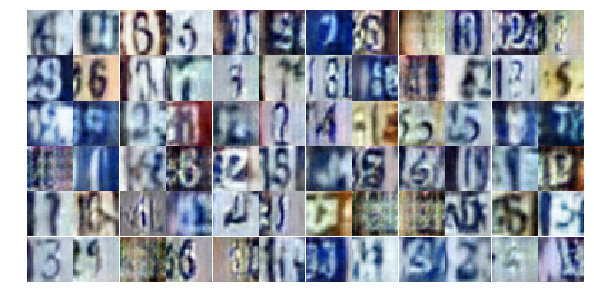

Epoch 9/25... Discriminator Loss: 0.6032... Generator Loss: 1.2752
Epoch 9/25... Discriminator Loss: 1.5179... Generator Loss: 0.3644
Epoch 9/25... Discriminator Loss: 0.8646... Generator Loss: 1.1299
Epoch 9/25... Discriminator Loss: 1.1218... Generator Loss: 0.5810
Epoch 9/25... Discriminator Loss: 0.5738... Generator Loss: 1.7502
Epoch 9/25... Discriminator Loss: 0.8116... Generator Loss: 0.9590
Epoch 9/25... Discriminator Loss: 1.1174... Generator Loss: 0.5821
Epoch 9/25... Discriminator Loss: 0.4669... Generator Loss: 1.4205
Epoch 9/25... Discriminator Loss: 1.2110... Generator Loss: 0.4828
Epoch 9/25... Discriminator Loss: 0.7373... Generator Loss: 1.2320


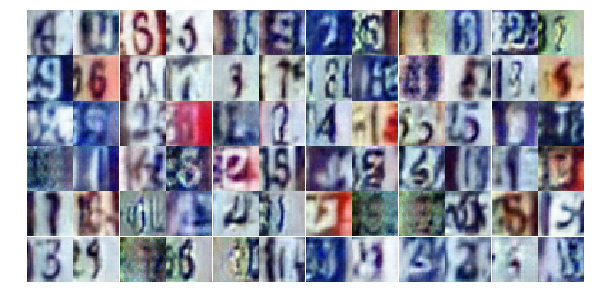

Epoch 9/25... Discriminator Loss: 1.0638... Generator Loss: 0.6630
Epoch 9/25... Discriminator Loss: 0.9547... Generator Loss: 0.7546
Epoch 9/25... Discriminator Loss: 0.4926... Generator Loss: 1.4761
Epoch 9/25... Discriminator Loss: 0.5293... Generator Loss: 1.2671
Epoch 9/25... Discriminator Loss: 0.6132... Generator Loss: 1.2379
Epoch 9/25... Discriminator Loss: 0.4604... Generator Loss: 1.5260
Epoch 9/25... Discriminator Loss: 0.5336... Generator Loss: 2.0565
Epoch 9/25... Discriminator Loss: 0.5242... Generator Loss: 1.4563
Epoch 9/25... Discriminator Loss: 0.4856... Generator Loss: 1.8661
Epoch 9/25... Discriminator Loss: 0.3175... Generator Loss: 1.8368


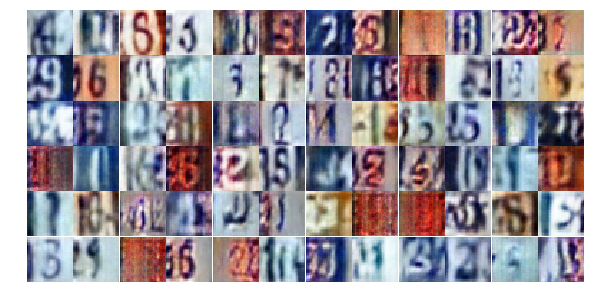

Epoch 9/25... Discriminator Loss: 0.5966... Generator Loss: 1.4412
Epoch 9/25... Discriminator Loss: 0.7747... Generator Loss: 0.8536
Epoch 9/25... Discriminator Loss: 0.8403... Generator Loss: 0.7744
Epoch 9/25... Discriminator Loss: 0.5127... Generator Loss: 1.6385
Epoch 9/25... Discriminator Loss: 0.7589... Generator Loss: 1.2850
Epoch 9/25... Discriminator Loss: 0.6669... Generator Loss: 1.7312
Epoch 9/25... Discriminator Loss: 0.9527... Generator Loss: 2.5028
Epoch 9/25... Discriminator Loss: 0.4361... Generator Loss: 1.5250
Epoch 9/25... Discriminator Loss: 1.0652... Generator Loss: 0.6163
Epoch 9/25... Discriminator Loss: 0.7882... Generator Loss: 0.8824


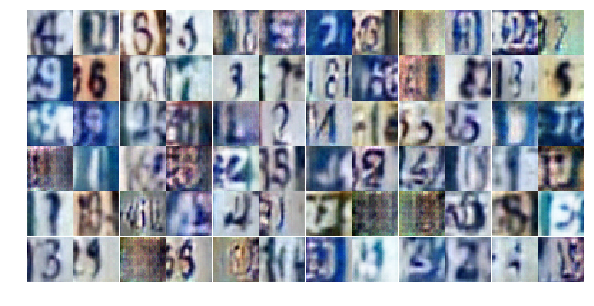

Epoch 9/25... Discriminator Loss: 0.5924... Generator Loss: 1.1188
Epoch 9/25... Discriminator Loss: 0.4381... Generator Loss: 1.5520
Epoch 9/25... Discriminator Loss: 2.0854... Generator Loss: 0.1796
Epoch 9/25... Discriminator Loss: 0.5795... Generator Loss: 1.6302
Epoch 9/25... Discriminator Loss: 0.5676... Generator Loss: 1.4946
Epoch 9/25... Discriminator Loss: 0.7941... Generator Loss: 0.8876
Epoch 9/25... Discriminator Loss: 0.7327... Generator Loss: 1.1867
Epoch 9/25... Discriminator Loss: 0.8472... Generator Loss: 0.8002
Epoch 9/25... Discriminator Loss: 0.6416... Generator Loss: 1.2052
Epoch 9/25... Discriminator Loss: 0.4727... Generator Loss: 1.8440


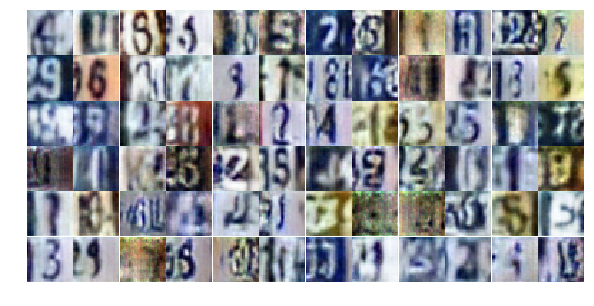

Epoch 9/25... Discriminator Loss: 0.9315... Generator Loss: 0.7218
Epoch 9/25... Discriminator Loss: 0.7476... Generator Loss: 1.9879
Epoch 9/25... Discriminator Loss: 0.6131... Generator Loss: 1.4634
Epoch 9/25... Discriminator Loss: 1.2233... Generator Loss: 0.4618
Epoch 9/25... Discriminator Loss: 0.5226... Generator Loss: 1.3261
Epoch 10/25... Discriminator Loss: 0.5211... Generator Loss: 1.2678
Epoch 10/25... Discriminator Loss: 0.5058... Generator Loss: 1.3209
Epoch 10/25... Discriminator Loss: 0.7438... Generator Loss: 0.8847
Epoch 10/25... Discriminator Loss: 0.7136... Generator Loss: 0.9928
Epoch 10/25... Discriminator Loss: 1.5523... Generator Loss: 0.3067


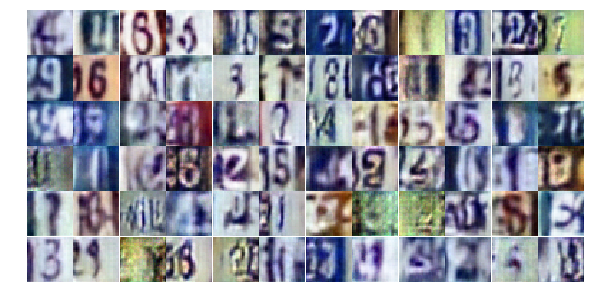

Epoch 10/25... Discriminator Loss: 0.8171... Generator Loss: 0.8088
Epoch 10/25... Discriminator Loss: 0.6715... Generator Loss: 0.9661
Epoch 10/25... Discriminator Loss: 0.5756... Generator Loss: 1.2345
Epoch 10/25... Discriminator Loss: 0.5181... Generator Loss: 1.3589
Epoch 10/25... Discriminator Loss: 0.9605... Generator Loss: 3.3085
Epoch 10/25... Discriminator Loss: 0.8918... Generator Loss: 0.7751
Epoch 10/25... Discriminator Loss: 0.5155... Generator Loss: 1.3889
Epoch 10/25... Discriminator Loss: 1.0961... Generator Loss: 0.6030
Epoch 10/25... Discriminator Loss: 0.9544... Generator Loss: 0.7733
Epoch 10/25... Discriminator Loss: 0.3756... Generator Loss: 1.7018


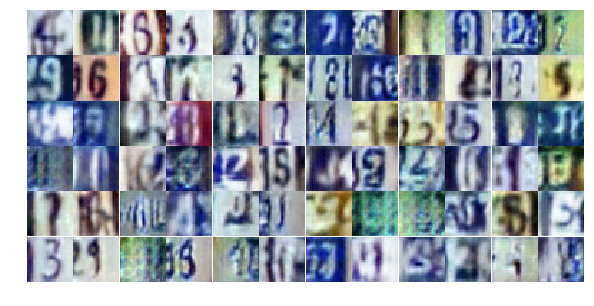

Epoch 10/25... Discriminator Loss: 0.5459... Generator Loss: 1.3473
Epoch 10/25... Discriminator Loss: 0.9234... Generator Loss: 0.7088
Epoch 10/25... Discriminator Loss: 0.7898... Generator Loss: 0.8047
Epoch 10/25... Discriminator Loss: 1.1710... Generator Loss: 0.5280
Epoch 10/25... Discriminator Loss: 0.5996... Generator Loss: 1.3789
Epoch 10/25... Discriminator Loss: 0.6118... Generator Loss: 1.1260
Epoch 10/25... Discriminator Loss: 1.0294... Generator Loss: 0.6447
Epoch 10/25... Discriminator Loss: 0.6388... Generator Loss: 1.4229
Epoch 10/25... Discriminator Loss: 0.5541... Generator Loss: 1.2489
Epoch 10/25... Discriminator Loss: 0.4344... Generator Loss: 2.6160


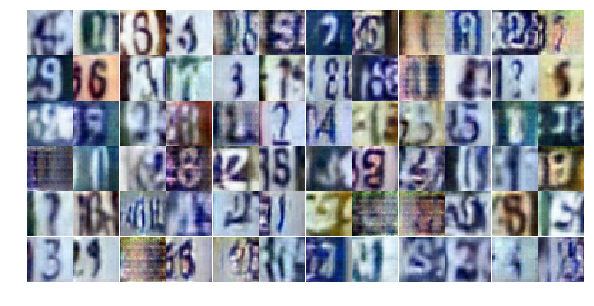

Epoch 10/25... Discriminator Loss: 0.7017... Generator Loss: 1.1393
Epoch 10/25... Discriminator Loss: 0.8292... Generator Loss: 0.8035
Epoch 10/25... Discriminator Loss: 0.3317... Generator Loss: 1.6722
Epoch 10/25... Discriminator Loss: 0.3827... Generator Loss: 2.4303
Epoch 10/25... Discriminator Loss: 1.4134... Generator Loss: 0.4130
Epoch 10/25... Discriminator Loss: 0.6891... Generator Loss: 1.0520
Epoch 10/25... Discriminator Loss: 0.4202... Generator Loss: 1.9196
Epoch 10/25... Discriminator Loss: 0.5470... Generator Loss: 1.4070
Epoch 10/25... Discriminator Loss: 1.0740... Generator Loss: 0.5925
Epoch 10/25... Discriminator Loss: 1.6793... Generator Loss: 0.3987


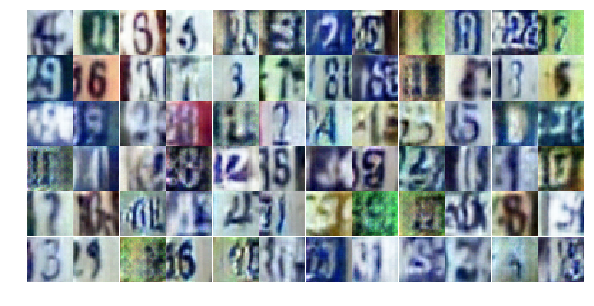

Epoch 10/25... Discriminator Loss: 0.7671... Generator Loss: 0.9402
Epoch 10/25... Discriminator Loss: 0.6625... Generator Loss: 1.4031
Epoch 10/25... Discriminator Loss: 0.5774... Generator Loss: 1.5849
Epoch 10/25... Discriminator Loss: 0.4845... Generator Loss: 1.8853
Epoch 10/25... Discriminator Loss: 0.8267... Generator Loss: 0.7811
Epoch 10/25... Discriminator Loss: 0.6460... Generator Loss: 1.4375
Epoch 10/25... Discriminator Loss: 0.7854... Generator Loss: 0.9088
Epoch 10/25... Discriminator Loss: 1.0000... Generator Loss: 0.7364
Epoch 10/25... Discriminator Loss: 0.4867... Generator Loss: 1.4025
Epoch 10/25... Discriminator Loss: 0.4554... Generator Loss: 1.7073


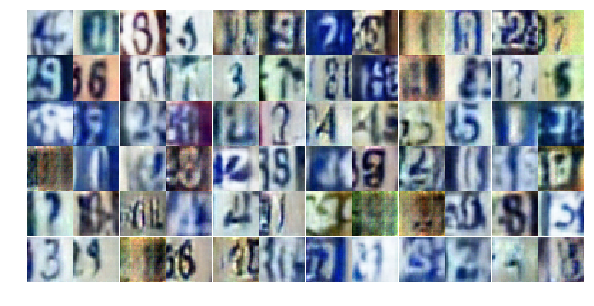

Epoch 10/25... Discriminator Loss: 0.7302... Generator Loss: 1.0162
Epoch 10/25... Discriminator Loss: 1.6928... Generator Loss: 0.4489
Epoch 10/25... Discriminator Loss: 0.7426... Generator Loss: 1.0335
Epoch 10/25... Discriminator Loss: 0.7287... Generator Loss: 1.6013
Epoch 10/25... Discriminator Loss: 0.6222... Generator Loss: 1.3534
Epoch 10/25... Discriminator Loss: 0.8490... Generator Loss: 0.8024
Epoch 10/25... Discriminator Loss: 0.3837... Generator Loss: 1.5895
Epoch 10/25... Discriminator Loss: 0.6943... Generator Loss: 1.0070
Epoch 10/25... Discriminator Loss: 0.6576... Generator Loss: 1.9202
Epoch 10/25... Discriminator Loss: 0.6662... Generator Loss: 1.3588


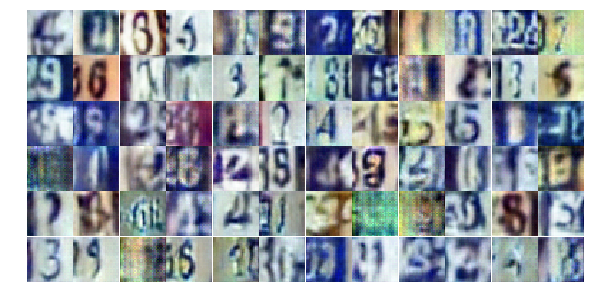

Epoch 10/25... Discriminator Loss: 0.7434... Generator Loss: 1.2050
Epoch 10/25... Discriminator Loss: 0.5723... Generator Loss: 1.1397
Epoch 10/25... Discriminator Loss: 0.3925... Generator Loss: 1.7652
Epoch 11/25... Discriminator Loss: 0.6337... Generator Loss: 1.1587
Epoch 11/25... Discriminator Loss: 0.7250... Generator Loss: 0.8804
Epoch 11/25... Discriminator Loss: 1.2645... Generator Loss: 0.4558
Epoch 11/25... Discriminator Loss: 0.5823... Generator Loss: 1.2839
Epoch 11/25... Discriminator Loss: 0.6829... Generator Loss: 1.0805
Epoch 11/25... Discriminator Loss: 1.6971... Generator Loss: 0.2821
Epoch 11/25... Discriminator Loss: 0.4787... Generator Loss: 1.5789


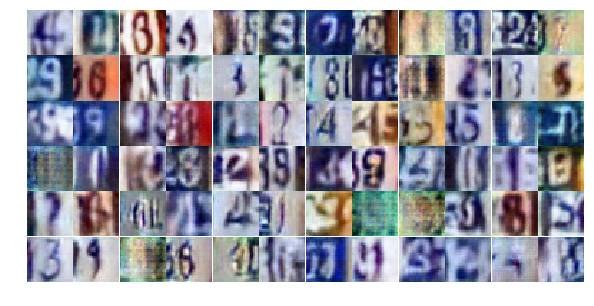

Epoch 11/25... Discriminator Loss: 0.4563... Generator Loss: 1.4543
Epoch 11/25... Discriminator Loss: 0.7022... Generator Loss: 0.9544
Epoch 11/25... Discriminator Loss: 0.6802... Generator Loss: 1.0807
Epoch 11/25... Discriminator Loss: 0.6549... Generator Loss: 1.0119
Epoch 11/25... Discriminator Loss: 0.7453... Generator Loss: 0.9157
Epoch 11/25... Discriminator Loss: 0.3243... Generator Loss: 2.0990
Epoch 11/25... Discriminator Loss: 0.5817... Generator Loss: 1.1032
Epoch 11/25... Discriminator Loss: 0.3242... Generator Loss: 2.2806
Epoch 11/25... Discriminator Loss: 0.7257... Generator Loss: 0.8759
Epoch 11/25... Discriminator Loss: 1.3242... Generator Loss: 0.4557


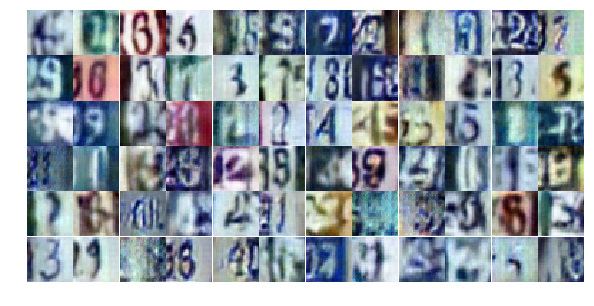

Epoch 11/25... Discriminator Loss: 1.1259... Generator Loss: 0.5176
Epoch 11/25... Discriminator Loss: 0.4854... Generator Loss: 2.6803
Epoch 11/25... Discriminator Loss: 0.8459... Generator Loss: 0.7369
Epoch 11/25... Discriminator Loss: 0.7530... Generator Loss: 0.8760
Epoch 11/25... Discriminator Loss: 0.3668... Generator Loss: 1.8842
Epoch 11/25... Discriminator Loss: 0.3635... Generator Loss: 1.7961
Epoch 11/25... Discriminator Loss: 0.5635... Generator Loss: 1.2347
Epoch 11/25... Discriminator Loss: 0.7861... Generator Loss: 0.8458
Epoch 11/25... Discriminator Loss: 0.3652... Generator Loss: 2.0340
Epoch 11/25... Discriminator Loss: 1.3029... Generator Loss: 0.4539


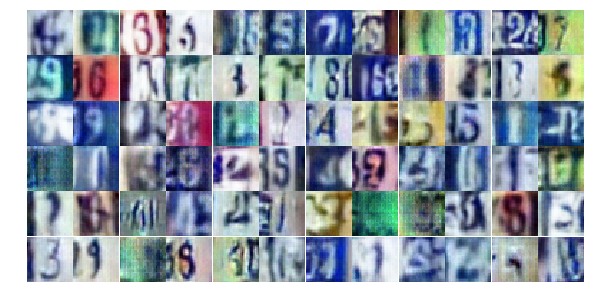

Epoch 11/25... Discriminator Loss: 1.4398... Generator Loss: 0.4715
Epoch 11/25... Discriminator Loss: 0.7215... Generator Loss: 1.1836
Epoch 11/25... Discriminator Loss: 0.8731... Generator Loss: 0.7381
Epoch 11/25... Discriminator Loss: 0.3873... Generator Loss: 1.6869
Epoch 11/25... Discriminator Loss: 0.7849... Generator Loss: 0.8241
Epoch 11/25... Discriminator Loss: 0.6285... Generator Loss: 1.1409
Epoch 11/25... Discriminator Loss: 0.9282... Generator Loss: 0.7181
Epoch 11/25... Discriminator Loss: 0.9095... Generator Loss: 0.6880
Epoch 11/25... Discriminator Loss: 0.5619... Generator Loss: 1.3046
Epoch 11/25... Discriminator Loss: 1.0334... Generator Loss: 0.6032


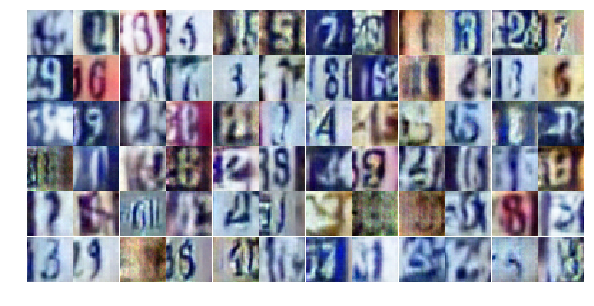

Epoch 11/25... Discriminator Loss: 0.3818... Generator Loss: 2.0194
Epoch 11/25... Discriminator Loss: 0.5383... Generator Loss: 1.2705
Epoch 11/25... Discriminator Loss: 1.0804... Generator Loss: 0.5953
Epoch 11/25... Discriminator Loss: 0.5659... Generator Loss: 2.0429
Epoch 11/25... Discriminator Loss: 0.5493... Generator Loss: 1.3154
Epoch 11/25... Discriminator Loss: 0.5516... Generator Loss: 1.1309
Epoch 11/25... Discriminator Loss: 0.3365... Generator Loss: 1.9459
Epoch 11/25... Discriminator Loss: 0.9194... Generator Loss: 1.8009
Epoch 11/25... Discriminator Loss: 1.7697... Generator Loss: 0.2895
Epoch 11/25... Discriminator Loss: 0.6585... Generator Loss: 1.1038


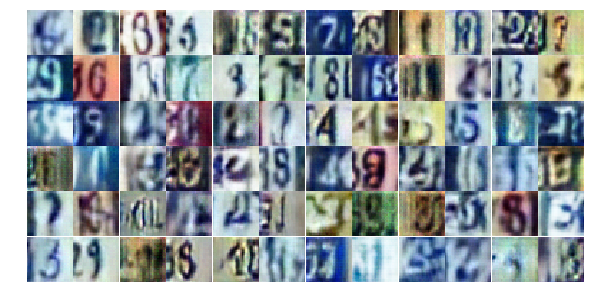

Epoch 11/25... Discriminator Loss: 0.7220... Generator Loss: 0.9636
Epoch 11/25... Discriminator Loss: 0.5363... Generator Loss: 1.3990
Epoch 11/25... Discriminator Loss: 0.5431... Generator Loss: 1.1753
Epoch 11/25... Discriminator Loss: 0.6477... Generator Loss: 1.0144
Epoch 11/25... Discriminator Loss: 1.3290... Generator Loss: 0.4358
Epoch 11/25... Discriminator Loss: 0.6721... Generator Loss: 1.8856
Epoch 11/25... Discriminator Loss: 1.2043... Generator Loss: 0.5330
Epoch 11/25... Discriminator Loss: 0.5739... Generator Loss: 2.3325
Epoch 11/25... Discriminator Loss: 0.9234... Generator Loss: 0.7785
Epoch 11/25... Discriminator Loss: 1.2885... Generator Loss: 0.4467


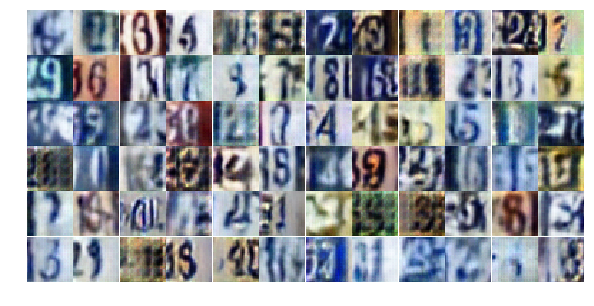

Epoch 12/25... Discriminator Loss: 0.6219... Generator Loss: 1.5716
Epoch 12/25... Discriminator Loss: 0.6505... Generator Loss: 1.1683
Epoch 12/25... Discriminator Loss: 0.7051... Generator Loss: 1.0763
Epoch 12/25... Discriminator Loss: 0.4427... Generator Loss: 1.4707
Epoch 12/25... Discriminator Loss: 0.6033... Generator Loss: 1.0133
Epoch 12/25... Discriminator Loss: 1.2920... Generator Loss: 0.4595
Epoch 12/25... Discriminator Loss: 0.5101... Generator Loss: 1.9443
Epoch 12/25... Discriminator Loss: 0.6463... Generator Loss: 1.2618
Epoch 12/25... Discriminator Loss: 0.6278... Generator Loss: 1.4903
Epoch 12/25... Discriminator Loss: 0.9640... Generator Loss: 0.7132


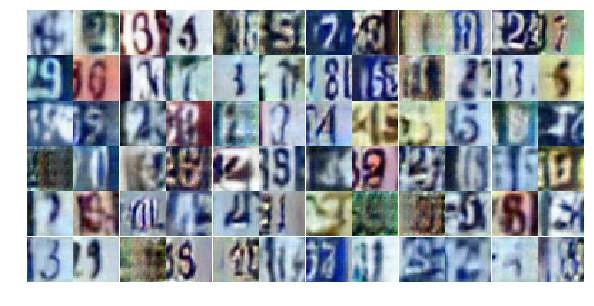

Epoch 12/25... Discriminator Loss: 0.6655... Generator Loss: 1.0486
Epoch 12/25... Discriminator Loss: 1.0129... Generator Loss: 0.5996
Epoch 12/25... Discriminator Loss: 0.4991... Generator Loss: 1.6584
Epoch 12/25... Discriminator Loss: 0.7757... Generator Loss: 1.1884
Epoch 12/25... Discriminator Loss: 0.5405... Generator Loss: 2.1452
Epoch 12/25... Discriminator Loss: 0.9532... Generator Loss: 0.7356
Epoch 12/25... Discriminator Loss: 0.9544... Generator Loss: 0.6590
Epoch 12/25... Discriminator Loss: 0.5358... Generator Loss: 1.4640
Epoch 12/25... Discriminator Loss: 0.5347... Generator Loss: 1.1769
Epoch 12/25... Discriminator Loss: 0.6834... Generator Loss: 1.4072


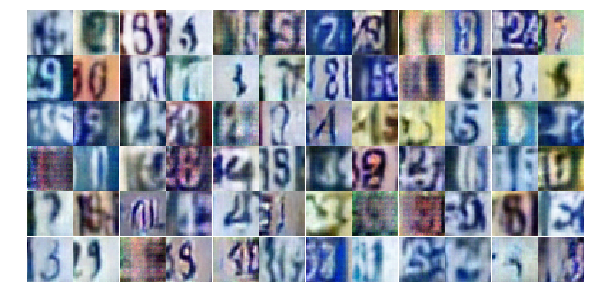

Epoch 12/25... Discriminator Loss: 0.3703... Generator Loss: 1.9097
Epoch 12/25... Discriminator Loss: 0.3912... Generator Loss: 1.5616
Epoch 12/25... Discriminator Loss: 0.5132... Generator Loss: 1.1832
Epoch 12/25... Discriminator Loss: 0.3842... Generator Loss: 1.6859
Epoch 12/25... Discriminator Loss: 0.4153... Generator Loss: 1.7154
Epoch 12/25... Discriminator Loss: 0.5224... Generator Loss: 1.2077
Epoch 12/25... Discriminator Loss: 0.7176... Generator Loss: 0.9002
Epoch 12/25... Discriminator Loss: 0.3417... Generator Loss: 2.0236
Epoch 12/25... Discriminator Loss: 0.5675... Generator Loss: 1.4067
Epoch 12/25... Discriminator Loss: 0.6990... Generator Loss: 1.3189


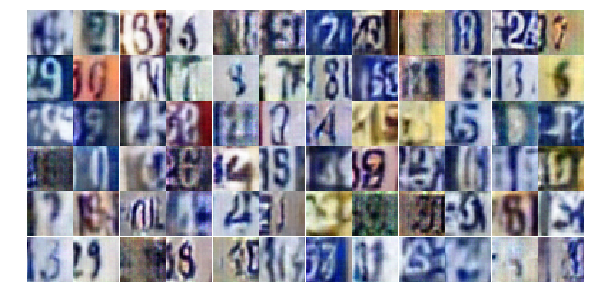

Epoch 12/25... Discriminator Loss: 0.6265... Generator Loss: 1.1432
Epoch 12/25... Discriminator Loss: 0.8870... Generator Loss: 0.7365
Epoch 12/25... Discriminator Loss: 0.7383... Generator Loss: 0.8478
Epoch 12/25... Discriminator Loss: 1.5128... Generator Loss: 0.3434
Epoch 12/25... Discriminator Loss: 0.6049... Generator Loss: 1.3266
Epoch 12/25... Discriminator Loss: 0.6760... Generator Loss: 1.0256
Epoch 12/25... Discriminator Loss: 0.7807... Generator Loss: 0.9465
Epoch 12/25... Discriminator Loss: 0.9034... Generator Loss: 0.9119
Epoch 12/25... Discriminator Loss: 0.6110... Generator Loss: 1.6378
Epoch 12/25... Discriminator Loss: 0.3014... Generator Loss: 1.7157


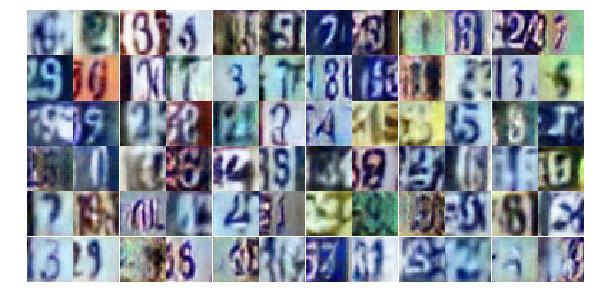

Epoch 12/25... Discriminator Loss: 0.6732... Generator Loss: 1.0503
Epoch 12/25... Discriminator Loss: 0.5098... Generator Loss: 1.6446
Epoch 12/25... Discriminator Loss: 0.5982... Generator Loss: 1.0730
Epoch 12/25... Discriminator Loss: 0.7429... Generator Loss: 1.3647
Epoch 12/25... Discriminator Loss: 1.1264... Generator Loss: 2.1903
Epoch 12/25... Discriminator Loss: 3.0285... Generator Loss: 0.1062
Epoch 12/25... Discriminator Loss: 1.2182... Generator Loss: 0.5072
Epoch 12/25... Discriminator Loss: 1.1430... Generator Loss: 0.5466
Epoch 12/25... Discriminator Loss: 0.5538... Generator Loss: 1.8902
Epoch 12/25... Discriminator Loss: 0.7299... Generator Loss: 0.9558


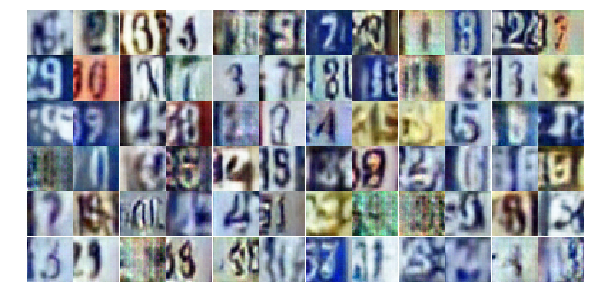

Epoch 12/25... Discriminator Loss: 0.7799... Generator Loss: 0.9596
Epoch 12/25... Discriminator Loss: 0.4727... Generator Loss: 1.5752
Epoch 12/25... Discriminator Loss: 0.6319... Generator Loss: 1.4902
Epoch 12/25... Discriminator Loss: 0.8160... Generator Loss: 1.3521
Epoch 12/25... Discriminator Loss: 0.4676... Generator Loss: 1.4262
Epoch 12/25... Discriminator Loss: 0.8081... Generator Loss: 2.2639
Epoch 12/25... Discriminator Loss: 0.9993... Generator Loss: 0.6649
Epoch 13/25... Discriminator Loss: 0.5888... Generator Loss: 1.3029
Epoch 13/25... Discriminator Loss: 0.4335... Generator Loss: 1.4207
Epoch 13/25... Discriminator Loss: 0.9190... Generator Loss: 0.7292


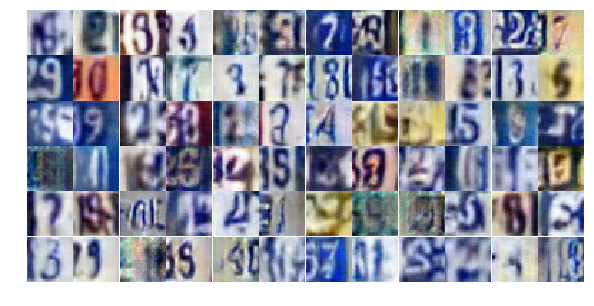

Epoch 13/25... Discriminator Loss: 0.5840... Generator Loss: 1.1513
Epoch 13/25... Discriminator Loss: 0.7586... Generator Loss: 2.2699
Epoch 13/25... Discriminator Loss: 1.4766... Generator Loss: 0.3652
Epoch 13/25... Discriminator Loss: 2.2125... Generator Loss: 0.3075
Epoch 13/25... Discriminator Loss: 0.8010... Generator Loss: 1.1518
Epoch 13/25... Discriminator Loss: 0.5818... Generator Loss: 1.3240
Epoch 13/25... Discriminator Loss: 0.4838... Generator Loss: 1.5769
Epoch 13/25... Discriminator Loss: 0.7180... Generator Loss: 1.0356
Epoch 13/25... Discriminator Loss: 0.4931... Generator Loss: 1.2276
Epoch 13/25... Discriminator Loss: 0.7301... Generator Loss: 0.8717


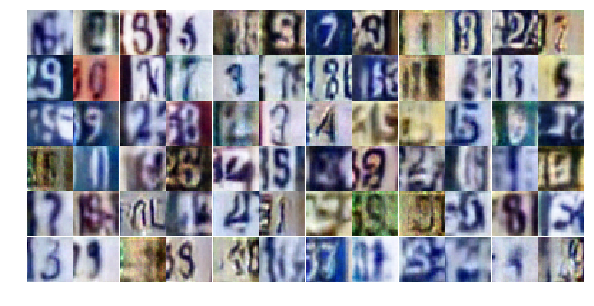

Epoch 13/25... Discriminator Loss: 0.6513... Generator Loss: 1.0858
Epoch 13/25... Discriminator Loss: 0.5008... Generator Loss: 1.3163
Epoch 13/25... Discriminator Loss: 0.7300... Generator Loss: 0.8972
Epoch 13/25... Discriminator Loss: 0.7147... Generator Loss: 0.9577
Epoch 13/25... Discriminator Loss: 0.7231... Generator Loss: 1.0271
Epoch 13/25... Discriminator Loss: 0.8657... Generator Loss: 0.7935
Epoch 13/25... Discriminator Loss: 0.9487... Generator Loss: 0.6726
Epoch 13/25... Discriminator Loss: 0.9399... Generator Loss: 0.6644
Epoch 13/25... Discriminator Loss: 0.6929... Generator Loss: 1.0213
Epoch 13/25... Discriminator Loss: 1.1397... Generator Loss: 0.4944


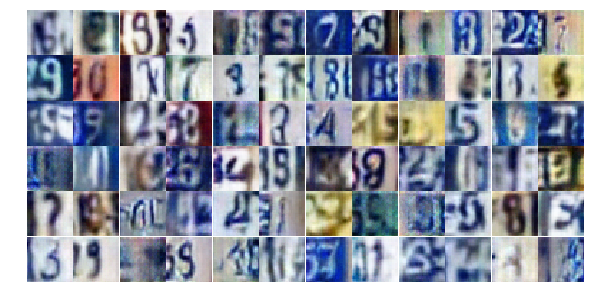

Epoch 13/25... Discriminator Loss: 0.7630... Generator Loss: 0.8633
Epoch 13/25... Discriminator Loss: 0.4823... Generator Loss: 1.7611
Epoch 13/25... Discriminator Loss: 0.5253... Generator Loss: 1.3633
Epoch 13/25... Discriminator Loss: 0.6158... Generator Loss: 1.0275
Epoch 13/25... Discriminator Loss: 0.8651... Generator Loss: 0.7796
Epoch 13/25... Discriminator Loss: 0.6030... Generator Loss: 1.2148
Epoch 13/25... Discriminator Loss: 1.0194... Generator Loss: 2.0357
Epoch 13/25... Discriminator Loss: 0.4977... Generator Loss: 1.2448
Epoch 13/25... Discriminator Loss: 0.7027... Generator Loss: 1.1068
Epoch 13/25... Discriminator Loss: 0.5765... Generator Loss: 1.1935


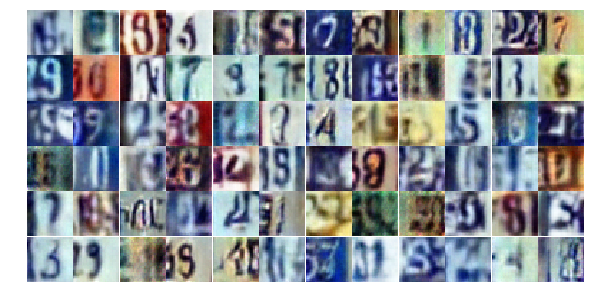

Epoch 13/25... Discriminator Loss: 1.0361... Generator Loss: 0.5617
Epoch 13/25... Discriminator Loss: 0.8219... Generator Loss: 1.1167
Epoch 13/25... Discriminator Loss: 0.7615... Generator Loss: 0.9425
Epoch 13/25... Discriminator Loss: 0.9640... Generator Loss: 0.6506
Epoch 13/25... Discriminator Loss: 0.6367... Generator Loss: 1.0438
Epoch 13/25... Discriminator Loss: 0.2934... Generator Loss: 1.9848
Epoch 13/25... Discriminator Loss: 0.5157... Generator Loss: 1.1809
Epoch 13/25... Discriminator Loss: 0.7148... Generator Loss: 0.9062
Epoch 13/25... Discriminator Loss: 0.6284... Generator Loss: 1.1027
Epoch 13/25... Discriminator Loss: 0.5866... Generator Loss: 1.3794


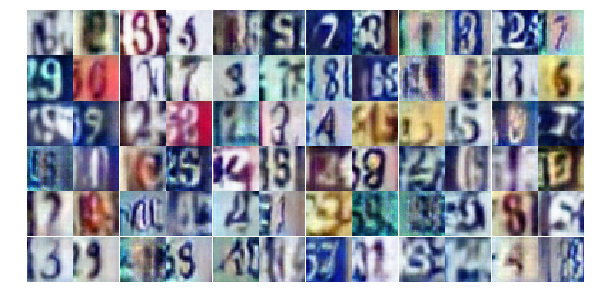

Epoch 13/25... Discriminator Loss: 0.3546... Generator Loss: 1.7846
Epoch 13/25... Discriminator Loss: 0.6645... Generator Loss: 1.4183
Epoch 13/25... Discriminator Loss: 0.5967... Generator Loss: 1.2462
Epoch 13/25... Discriminator Loss: 0.6700... Generator Loss: 1.1344
Epoch 13/25... Discriminator Loss: 1.1298... Generator Loss: 0.5660
Epoch 13/25... Discriminator Loss: 0.5707... Generator Loss: 1.4219
Epoch 13/25... Discriminator Loss: 0.7621... Generator Loss: 1.0297
Epoch 13/25... Discriminator Loss: 0.5821... Generator Loss: 1.2131
Epoch 13/25... Discriminator Loss: 0.8158... Generator Loss: 0.7404
Epoch 13/25... Discriminator Loss: 2.4592... Generator Loss: 0.1418


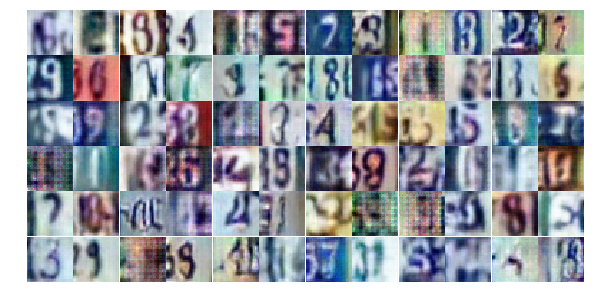

Epoch 13/25... Discriminator Loss: 0.5265... Generator Loss: 1.6588
Epoch 13/25... Discriminator Loss: 0.9937... Generator Loss: 0.6352
Epoch 13/25... Discriminator Loss: 0.6942... Generator Loss: 1.7819
Epoch 13/25... Discriminator Loss: 0.8266... Generator Loss: 0.8006
Epoch 14/25... Discriminator Loss: 1.1608... Generator Loss: 0.5601
Epoch 14/25... Discriminator Loss: 0.6949... Generator Loss: 1.3335
Epoch 14/25... Discriminator Loss: 0.8718... Generator Loss: 0.7698
Epoch 14/25... Discriminator Loss: 0.5422... Generator Loss: 1.6182
Epoch 14/25... Discriminator Loss: 0.6221... Generator Loss: 1.1081
Epoch 14/25... Discriminator Loss: 0.6914... Generator Loss: 0.9970


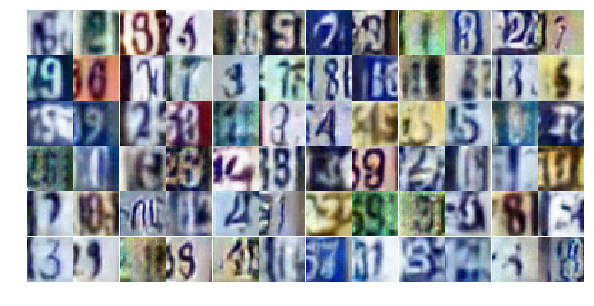

Epoch 14/25... Discriminator Loss: 0.6198... Generator Loss: 1.9285
Epoch 14/25... Discriminator Loss: 0.5559... Generator Loss: 1.2231
Epoch 14/25... Discriminator Loss: 0.5582... Generator Loss: 1.2387
Epoch 14/25... Discriminator Loss: 0.6679... Generator Loss: 1.0018
Epoch 14/25... Discriminator Loss: 1.1990... Generator Loss: 0.4780
Epoch 14/25... Discriminator Loss: 0.5620... Generator Loss: 1.0648
Epoch 14/25... Discriminator Loss: 0.3817... Generator Loss: 1.5284
Epoch 14/25... Discriminator Loss: 1.6989... Generator Loss: 0.2784
Epoch 14/25... Discriminator Loss: 1.7412... Generator Loss: 0.2491
Epoch 14/25... Discriminator Loss: 1.5653... Generator Loss: 0.3639


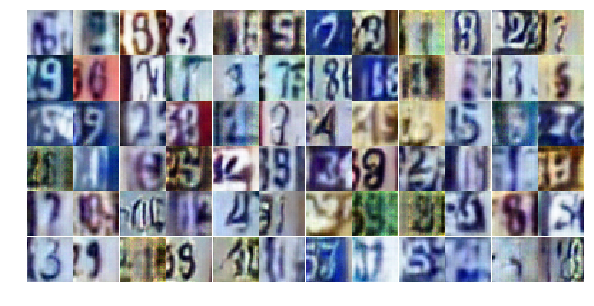

Epoch 14/25... Discriminator Loss: 0.6895... Generator Loss: 1.0212
Epoch 14/25... Discriminator Loss: 0.4780... Generator Loss: 1.4510
Epoch 14/25... Discriminator Loss: 1.0569... Generator Loss: 0.5798
Epoch 14/25... Discriminator Loss: 0.3931... Generator Loss: 1.7066
Epoch 14/25... Discriminator Loss: 0.8554... Generator Loss: 1.0370
Epoch 14/25... Discriminator Loss: 0.4781... Generator Loss: 1.6038
Epoch 14/25... Discriminator Loss: 0.9191... Generator Loss: 0.6969
Epoch 14/25... Discriminator Loss: 0.6968... Generator Loss: 0.9926
Epoch 14/25... Discriminator Loss: 0.6380... Generator Loss: 1.3976
Epoch 14/25... Discriminator Loss: 0.8010... Generator Loss: 0.8135


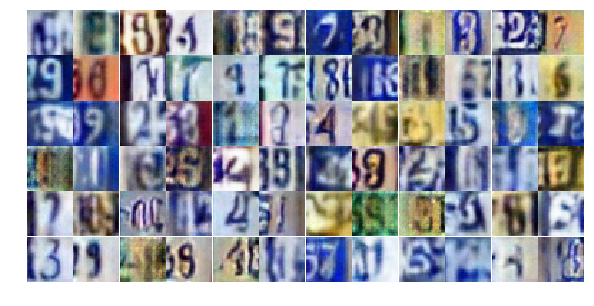

Epoch 14/25... Discriminator Loss: 1.1070... Generator Loss: 0.6421
Epoch 14/25... Discriminator Loss: 0.4554... Generator Loss: 1.3548
Epoch 14/25... Discriminator Loss: 0.3745... Generator Loss: 2.2587
Epoch 14/25... Discriminator Loss: 0.5480... Generator Loss: 3.4643
Epoch 14/25... Discriminator Loss: 0.5959... Generator Loss: 1.3874
Epoch 14/25... Discriminator Loss: 0.5621... Generator Loss: 1.3731
Epoch 14/25... Discriminator Loss: 0.8055... Generator Loss: 0.8611
Epoch 14/25... Discriminator Loss: 0.4958... Generator Loss: 1.3206
Epoch 14/25... Discriminator Loss: 0.3881... Generator Loss: 1.8795
Epoch 14/25... Discriminator Loss: 1.0550... Generator Loss: 0.6056


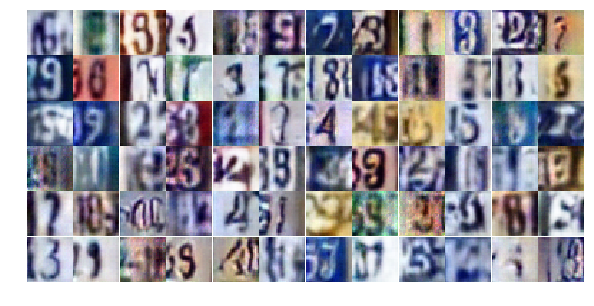

Epoch 14/25... Discriminator Loss: 1.4054... Generator Loss: 0.4029
Epoch 14/25... Discriminator Loss: 0.6640... Generator Loss: 1.2554
Epoch 14/25... Discriminator Loss: 0.9289... Generator Loss: 0.7347
Epoch 14/25... Discriminator Loss: 1.2410... Generator Loss: 0.4720
Epoch 14/25... Discriminator Loss: 1.0929... Generator Loss: 0.5714
Epoch 14/25... Discriminator Loss: 0.5883... Generator Loss: 1.1418
Epoch 14/25... Discriminator Loss: 0.7630... Generator Loss: 0.8904
Epoch 14/25... Discriminator Loss: 0.4102... Generator Loss: 1.6135
Epoch 14/25... Discriminator Loss: 1.4764... Generator Loss: 0.3949
Epoch 14/25... Discriminator Loss: 0.9424... Generator Loss: 0.6849


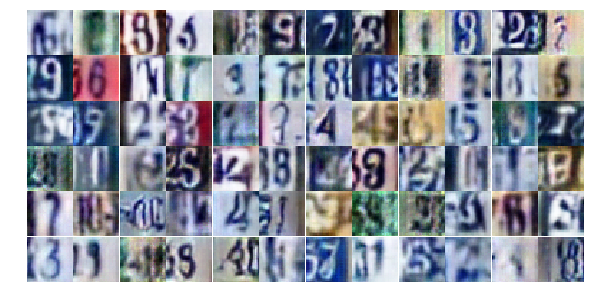

Epoch 14/25... Discriminator Loss: 0.8028... Generator Loss: 1.1205
Epoch 14/25... Discriminator Loss: 1.5764... Generator Loss: 0.3095
Epoch 14/25... Discriminator Loss: 0.7831... Generator Loss: 0.8815
Epoch 14/25... Discriminator Loss: 1.1591... Generator Loss: 0.5337
Epoch 14/25... Discriminator Loss: 0.5900... Generator Loss: 1.1478
Epoch 14/25... Discriminator Loss: 0.5478... Generator Loss: 1.3663
Epoch 14/25... Discriminator Loss: 0.7574... Generator Loss: 1.2139
Epoch 14/25... Discriminator Loss: 0.7552... Generator Loss: 0.9493
Epoch 14/25... Discriminator Loss: 1.0923... Generator Loss: 0.6794
Epoch 14/25... Discriminator Loss: 1.5328... Generator Loss: 0.3100


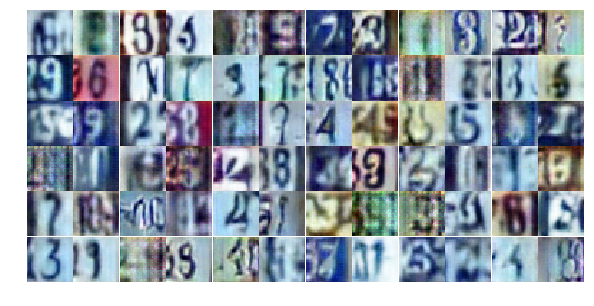

Epoch 14/25... Discriminator Loss: 0.5956... Generator Loss: 2.0768
Epoch 14/25... Discriminator Loss: 1.1602... Generator Loss: 0.5493
Epoch 15/25... Discriminator Loss: 0.6133... Generator Loss: 1.1460
Epoch 15/25... Discriminator Loss: 0.5180... Generator Loss: 1.5386
Epoch 15/25... Discriminator Loss: 0.7727... Generator Loss: 0.8363
Epoch 15/25... Discriminator Loss: 1.1432... Generator Loss: 0.5384
Epoch 15/25... Discriminator Loss: 0.6398... Generator Loss: 1.0267
Epoch 15/25... Discriminator Loss: 0.8061... Generator Loss: 0.7956
Epoch 15/25... Discriminator Loss: 1.0799... Generator Loss: 0.6598
Epoch 15/25... Discriminator Loss: 0.9918... Generator Loss: 0.6122


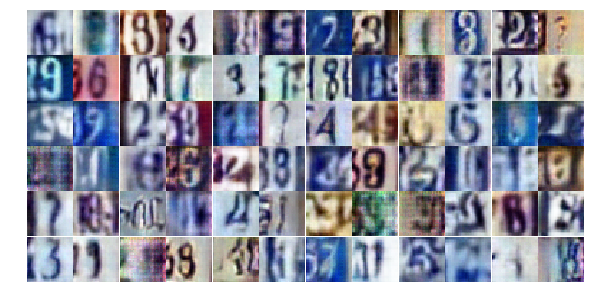

Epoch 15/25... Discriminator Loss: 0.6754... Generator Loss: 1.0079
Epoch 15/25... Discriminator Loss: 0.5506... Generator Loss: 1.4275
Epoch 15/25... Discriminator Loss: 0.7708... Generator Loss: 0.8863
Epoch 15/25... Discriminator Loss: 0.6022... Generator Loss: 1.5335
Epoch 15/25... Discriminator Loss: 0.8690... Generator Loss: 0.8474
Epoch 15/25... Discriminator Loss: 0.4757... Generator Loss: 1.4153
Epoch 15/25... Discriminator Loss: 1.4631... Generator Loss: 0.3535
Epoch 15/25... Discriminator Loss: 0.6529... Generator Loss: 1.5961
Epoch 15/25... Discriminator Loss: 0.4785... Generator Loss: 2.3246
Epoch 15/25... Discriminator Loss: 1.3372... Generator Loss: 0.4613


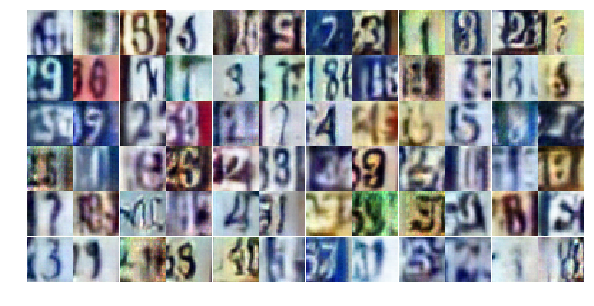

Epoch 15/25... Discriminator Loss: 1.2798... Generator Loss: 0.4701
Epoch 15/25... Discriminator Loss: 0.5595... Generator Loss: 1.3471
Epoch 15/25... Discriminator Loss: 0.4854... Generator Loss: 1.7302
Epoch 15/25... Discriminator Loss: 0.8280... Generator Loss: 0.8589
Epoch 15/25... Discriminator Loss: 1.2547... Generator Loss: 0.4693
Epoch 15/25... Discriminator Loss: 0.7557... Generator Loss: 0.9376
Epoch 15/25... Discriminator Loss: 0.8676... Generator Loss: 0.8642
Epoch 15/25... Discriminator Loss: 1.6967... Generator Loss: 0.5030
Epoch 15/25... Discriminator Loss: 0.5899... Generator Loss: 1.2387
Epoch 15/25... Discriminator Loss: 1.0059... Generator Loss: 0.7015


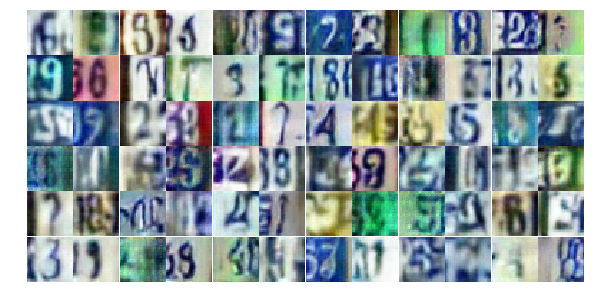

Epoch 15/25... Discriminator Loss: 1.0170... Generator Loss: 0.7025
Epoch 15/25... Discriminator Loss: 0.7516... Generator Loss: 0.9151
Epoch 15/25... Discriminator Loss: 0.5167... Generator Loss: 1.3064
Epoch 15/25... Discriminator Loss: 0.6503... Generator Loss: 1.1320
Epoch 15/25... Discriminator Loss: 0.5695... Generator Loss: 1.1659
Epoch 15/25... Discriminator Loss: 1.0635... Generator Loss: 2.9082
Epoch 15/25... Discriminator Loss: 0.5672... Generator Loss: 1.3478
Epoch 15/25... Discriminator Loss: 0.7021... Generator Loss: 1.0594
Epoch 15/25... Discriminator Loss: 0.6225... Generator Loss: 1.0488
Epoch 15/25... Discriminator Loss: 0.6076... Generator Loss: 1.1324


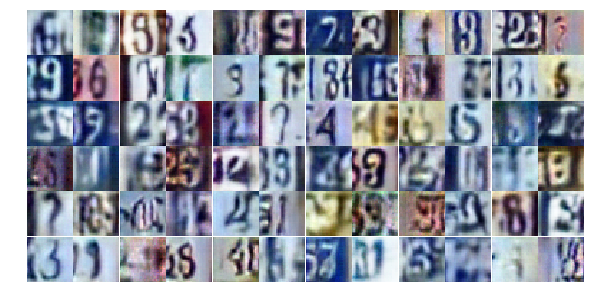

Epoch 15/25... Discriminator Loss: 0.7185... Generator Loss: 0.9625
Epoch 15/25... Discriminator Loss: 1.8218... Generator Loss: 0.2421
Epoch 15/25... Discriminator Loss: 1.1023... Generator Loss: 0.5580
Epoch 15/25... Discriminator Loss: 0.4916... Generator Loss: 1.6233
Epoch 15/25... Discriminator Loss: 0.4243... Generator Loss: 1.6845
Epoch 15/25... Discriminator Loss: 2.0802... Generator Loss: 0.2117
Epoch 15/25... Discriminator Loss: 0.6033... Generator Loss: 1.3791
Epoch 15/25... Discriminator Loss: 0.5892... Generator Loss: 1.5363
Epoch 15/25... Discriminator Loss: 0.9877... Generator Loss: 0.6473
Epoch 15/25... Discriminator Loss: 0.7509... Generator Loss: 0.9679


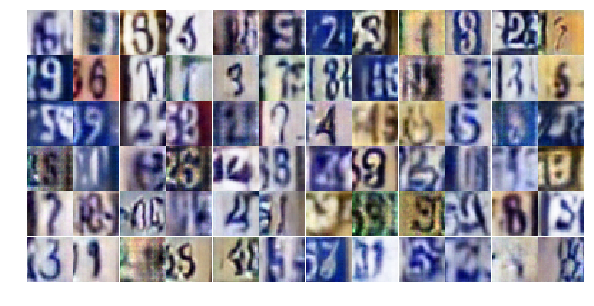

Epoch 15/25... Discriminator Loss: 0.6811... Generator Loss: 1.0203
Epoch 15/25... Discriminator Loss: 0.9219... Generator Loss: 0.7393
Epoch 15/25... Discriminator Loss: 0.5349... Generator Loss: 1.1765
Epoch 15/25... Discriminator Loss: 1.7361... Generator Loss: 0.3028
Epoch 15/25... Discriminator Loss: 0.6926... Generator Loss: 0.9926
Epoch 15/25... Discriminator Loss: 0.7898... Generator Loss: 2.3182
Epoch 15/25... Discriminator Loss: 1.2628... Generator Loss: 0.5007
Epoch 15/25... Discriminator Loss: 0.6268... Generator Loss: 1.4065
Epoch 15/25... Discriminator Loss: 1.1980... Generator Loss: 0.5545
Epoch 16/25... Discriminator Loss: 1.0890... Generator Loss: 0.5581


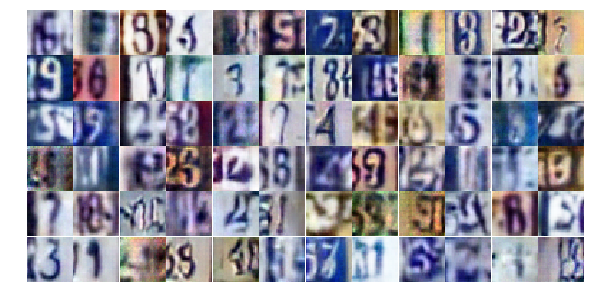

Epoch 16/25... Discriminator Loss: 0.5144... Generator Loss: 1.3192
Epoch 16/25... Discriminator Loss: 0.7517... Generator Loss: 0.9049
Epoch 16/25... Discriminator Loss: 1.2915... Generator Loss: 0.4691
Epoch 16/25... Discriminator Loss: 0.9081... Generator Loss: 0.7495
Epoch 16/25... Discriminator Loss: 0.6437... Generator Loss: 1.6604
Epoch 16/25... Discriminator Loss: 0.8478... Generator Loss: 0.8747
Epoch 16/25... Discriminator Loss: 1.5434... Generator Loss: 0.3263
Epoch 16/25... Discriminator Loss: 1.0237... Generator Loss: 0.6040
Epoch 16/25... Discriminator Loss: 0.6163... Generator Loss: 1.0638
Epoch 16/25... Discriminator Loss: 0.6410... Generator Loss: 1.0527


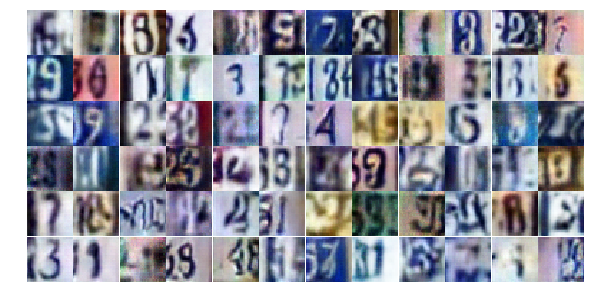

Epoch 16/25... Discriminator Loss: 0.8413... Generator Loss: 0.7978
Epoch 16/25... Discriminator Loss: 0.4791... Generator Loss: 1.5254
Epoch 16/25... Discriminator Loss: 0.4969... Generator Loss: 1.4614
Epoch 16/25... Discriminator Loss: 1.1200... Generator Loss: 0.5149
Epoch 16/25... Discriminator Loss: 0.5354... Generator Loss: 1.1423
Epoch 16/25... Discriminator Loss: 0.6088... Generator Loss: 1.7392
Epoch 16/25... Discriminator Loss: 2.6377... Generator Loss: 3.9887
Epoch 16/25... Discriminator Loss: 0.8375... Generator Loss: 1.2811
Epoch 16/25... Discriminator Loss: 0.6602... Generator Loss: 1.1909
Epoch 16/25... Discriminator Loss: 0.9624... Generator Loss: 0.6933


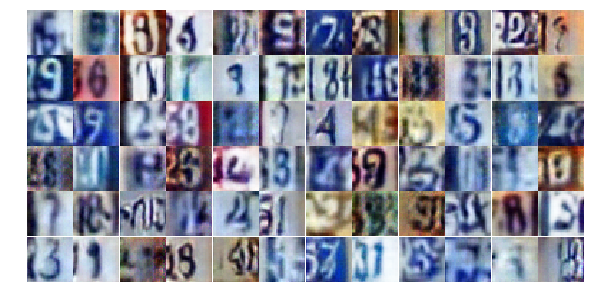

Epoch 16/25... Discriminator Loss: 0.5490... Generator Loss: 1.3594
Epoch 16/25... Discriminator Loss: 0.6286... Generator Loss: 1.2102
Epoch 16/25... Discriminator Loss: 1.1064... Generator Loss: 0.5674
Epoch 16/25... Discriminator Loss: 0.9834... Generator Loss: 0.6010
Epoch 16/25... Discriminator Loss: 0.5515... Generator Loss: 1.5252
Epoch 16/25... Discriminator Loss: 0.7075... Generator Loss: 0.9925
Epoch 16/25... Discriminator Loss: 0.7504... Generator Loss: 0.8273
Epoch 16/25... Discriminator Loss: 0.5236... Generator Loss: 1.2730
Epoch 16/25... Discriminator Loss: 0.8943... Generator Loss: 0.8348
Epoch 16/25... Discriminator Loss: 0.8672... Generator Loss: 0.7416


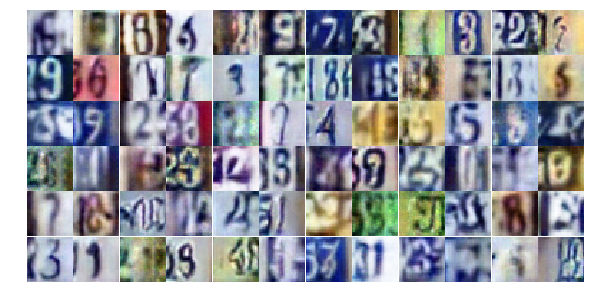

Epoch 16/25... Discriminator Loss: 0.8367... Generator Loss: 0.7416
Epoch 16/25... Discriminator Loss: 0.5666... Generator Loss: 1.1390
Epoch 16/25... Discriminator Loss: 0.7475... Generator Loss: 1.8270
Epoch 16/25... Discriminator Loss: 0.6292... Generator Loss: 1.2872
Epoch 16/25... Discriminator Loss: 0.8722... Generator Loss: 0.8962
Epoch 16/25... Discriminator Loss: 0.7863... Generator Loss: 0.8792
Epoch 16/25... Discriminator Loss: 0.7686... Generator Loss: 0.9014
Epoch 16/25... Discriminator Loss: 1.3615... Generator Loss: 0.4352
Epoch 16/25... Discriminator Loss: 0.6567... Generator Loss: 1.0041
Epoch 16/25... Discriminator Loss: 0.5227... Generator Loss: 1.7619


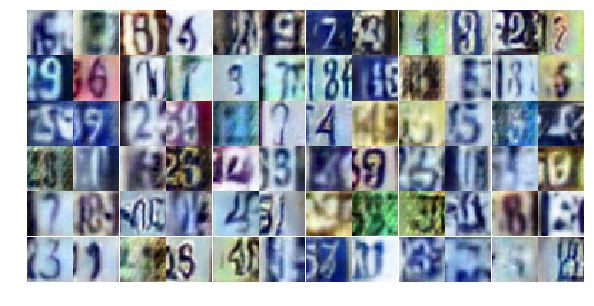

Epoch 16/25... Discriminator Loss: 0.5055... Generator Loss: 1.5158
Epoch 16/25... Discriminator Loss: 0.4869... Generator Loss: 1.6292
Epoch 16/25... Discriminator Loss: 0.5601... Generator Loss: 1.2601
Epoch 16/25... Discriminator Loss: 0.5927... Generator Loss: 1.3072
Epoch 16/25... Discriminator Loss: 0.9434... Generator Loss: 0.7229
Epoch 16/25... Discriminator Loss: 1.1350... Generator Loss: 0.5654
Epoch 16/25... Discriminator Loss: 0.5328... Generator Loss: 1.4418
Epoch 16/25... Discriminator Loss: 0.8428... Generator Loss: 0.7354
Epoch 16/25... Discriminator Loss: 0.3307... Generator Loss: 1.5667
Epoch 16/25... Discriminator Loss: 0.6663... Generator Loss: 0.9627


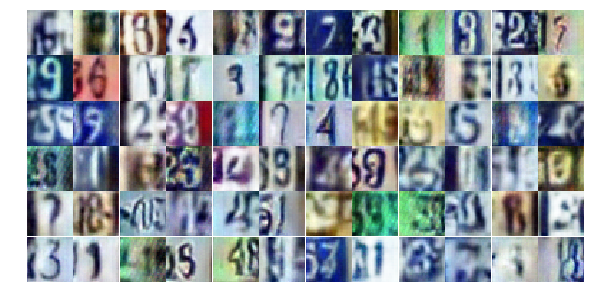

Epoch 16/25... Discriminator Loss: 1.1748... Generator Loss: 0.5013
Epoch 16/25... Discriminator Loss: 0.6549... Generator Loss: 1.0721
Epoch 16/25... Discriminator Loss: 1.4430... Generator Loss: 0.4690
Epoch 16/25... Discriminator Loss: 0.7438... Generator Loss: 1.6747
Epoch 16/25... Discriminator Loss: 0.6850... Generator Loss: 0.9846
Epoch 16/25... Discriminator Loss: 0.5196... Generator Loss: 1.2401
Epoch 17/25... Discriminator Loss: 0.6326... Generator Loss: 1.4869
Epoch 17/25... Discriminator Loss: 0.8103... Generator Loss: 0.8386
Epoch 17/25... Discriminator Loss: 0.6681... Generator Loss: 1.1569
Epoch 17/25... Discriminator Loss: 0.8187... Generator Loss: 0.8927


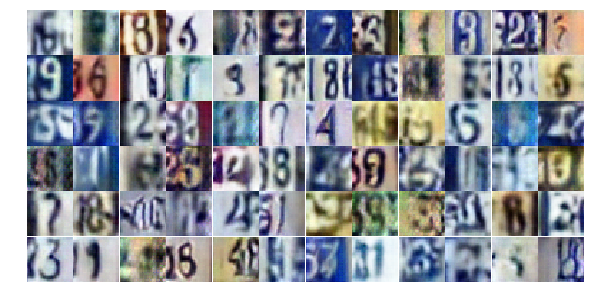

Epoch 17/25... Discriminator Loss: 0.4687... Generator Loss: 1.3386
Epoch 17/25... Discriminator Loss: 0.4905... Generator Loss: 1.5669
Epoch 17/25... Discriminator Loss: 0.7789... Generator Loss: 0.9382
Epoch 17/25... Discriminator Loss: 0.5932... Generator Loss: 1.0752
Epoch 17/25... Discriminator Loss: 1.6129... Generator Loss: 0.3134
Epoch 17/25... Discriminator Loss: 1.3778... Generator Loss: 0.4429
Epoch 17/25... Discriminator Loss: 0.8969... Generator Loss: 2.1860
Epoch 17/25... Discriminator Loss: 1.0491... Generator Loss: 0.5886
Epoch 17/25... Discriminator Loss: 0.3391... Generator Loss: 1.8537
Epoch 17/25... Discriminator Loss: 0.6333... Generator Loss: 1.2493


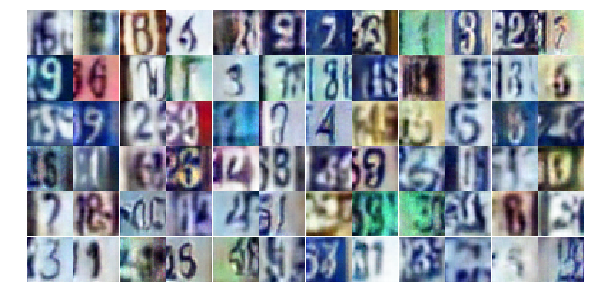

Epoch 17/25... Discriminator Loss: 0.7853... Generator Loss: 0.9159
Epoch 17/25... Discriminator Loss: 0.8229... Generator Loss: 3.1031
Epoch 17/25... Discriminator Loss: 0.9272... Generator Loss: 0.6910
Epoch 17/25... Discriminator Loss: 0.5359... Generator Loss: 1.3123
Epoch 17/25... Discriminator Loss: 0.6473... Generator Loss: 2.0755
Epoch 17/25... Discriminator Loss: 1.3981... Generator Loss: 0.4231
Epoch 17/25... Discriminator Loss: 0.4731... Generator Loss: 1.8882
Epoch 17/25... Discriminator Loss: 0.4572... Generator Loss: 1.6921
Epoch 17/25... Discriminator Loss: 0.6331... Generator Loss: 1.0608
Epoch 17/25... Discriminator Loss: 0.5769... Generator Loss: 1.8676


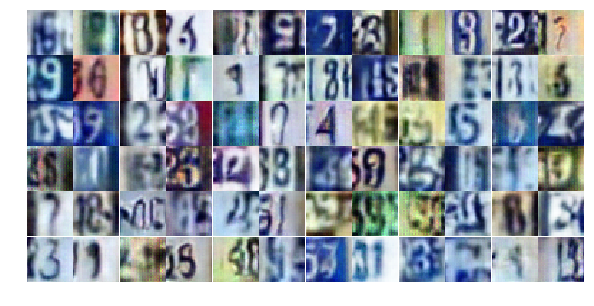

Epoch 17/25... Discriminator Loss: 1.3634... Generator Loss: 0.4347
Epoch 17/25... Discriminator Loss: 0.5060... Generator Loss: 1.3297
Epoch 17/25... Discriminator Loss: 0.3045... Generator Loss: 2.0866
Epoch 17/25... Discriminator Loss: 0.8897... Generator Loss: 0.7814
Epoch 17/25... Discriminator Loss: 1.6312... Generator Loss: 0.3343
Epoch 17/25... Discriminator Loss: 0.4960... Generator Loss: 1.3664
Epoch 17/25... Discriminator Loss: 0.7138... Generator Loss: 0.9504
Epoch 17/25... Discriminator Loss: 0.8360... Generator Loss: 0.8436
Epoch 17/25... Discriminator Loss: 1.1545... Generator Loss: 0.5270
Epoch 17/25... Discriminator Loss: 0.3111... Generator Loss: 2.1593


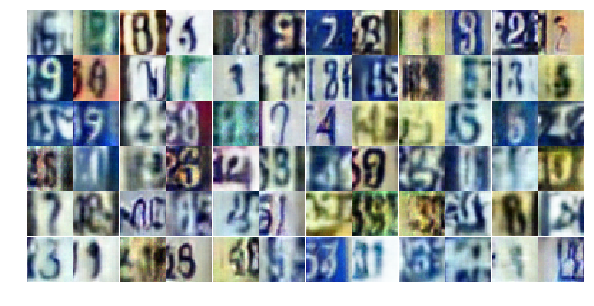

Epoch 17/25... Discriminator Loss: 0.5014... Generator Loss: 1.5827
Epoch 17/25... Discriminator Loss: 1.0039... Generator Loss: 0.6750
Epoch 17/25... Discriminator Loss: 0.6112... Generator Loss: 1.5540
Epoch 17/25... Discriminator Loss: 0.7273... Generator Loss: 0.9675
Epoch 17/25... Discriminator Loss: 0.8576... Generator Loss: 0.7979
Epoch 17/25... Discriminator Loss: 0.6260... Generator Loss: 1.0355
Epoch 17/25... Discriminator Loss: 0.6606... Generator Loss: 1.3031
Epoch 17/25... Discriminator Loss: 0.6032... Generator Loss: 1.1481
Epoch 17/25... Discriminator Loss: 0.4388... Generator Loss: 1.5349
Epoch 17/25... Discriminator Loss: 1.1341... Generator Loss: 0.5780


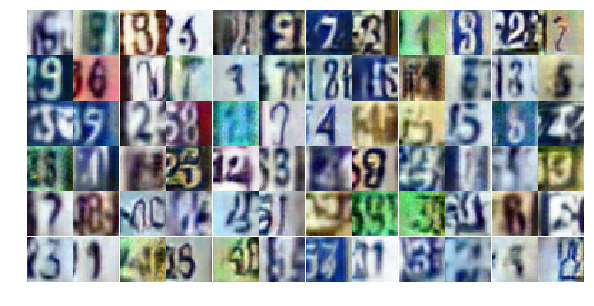

Epoch 17/25... Discriminator Loss: 1.3086... Generator Loss: 1.5485
Epoch 17/25... Discriminator Loss: 0.2690... Generator Loss: 2.1471
Epoch 17/25... Discriminator Loss: 1.0665... Generator Loss: 0.6941
Epoch 17/25... Discriminator Loss: 0.4039... Generator Loss: 1.5069
Epoch 17/25... Discriminator Loss: 1.2077... Generator Loss: 0.5522
Epoch 17/25... Discriminator Loss: 0.8972... Generator Loss: 0.7566
Epoch 17/25... Discriminator Loss: 0.9579... Generator Loss: 0.6997
Epoch 17/25... Discriminator Loss: 0.5753... Generator Loss: 1.2699
Epoch 17/25... Discriminator Loss: 0.5180... Generator Loss: 1.3719
Epoch 17/25... Discriminator Loss: 1.6028... Generator Loss: 0.2947


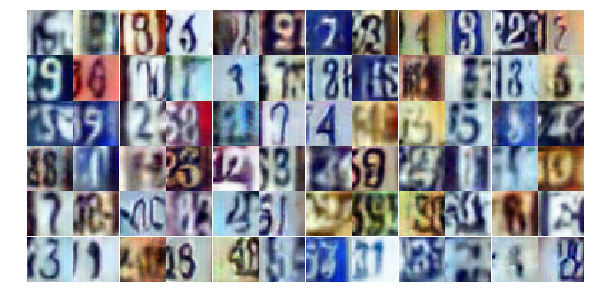

Epoch 17/25... Discriminator Loss: 2.1361... Generator Loss: 3.2386
Epoch 17/25... Discriminator Loss: 2.3056... Generator Loss: 3.3444
Epoch 17/25... Discriminator Loss: 0.5259... Generator Loss: 1.4509
Epoch 17/25... Discriminator Loss: 0.8553... Generator Loss: 0.7685
Epoch 18/25... Discriminator Loss: 0.8180... Generator Loss: 0.8358
Epoch 18/25... Discriminator Loss: 0.6324... Generator Loss: 1.0880
Epoch 18/25... Discriminator Loss: 0.9357... Generator Loss: 0.7652
Epoch 18/25... Discriminator Loss: 0.7621... Generator Loss: 0.9001
Epoch 18/25... Discriminator Loss: 1.3121... Generator Loss: 0.4645
Epoch 18/25... Discriminator Loss: 0.6848... Generator Loss: 0.9716


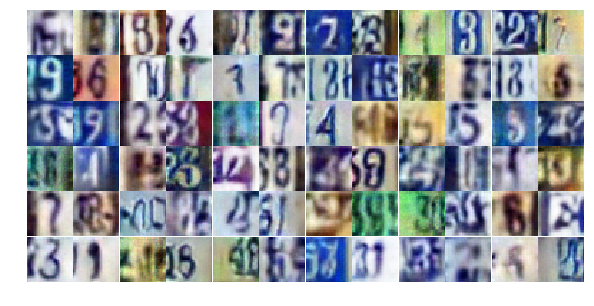

Epoch 18/25... Discriminator Loss: 0.4107... Generator Loss: 1.8685
Epoch 18/25... Discriminator Loss: 1.0941... Generator Loss: 0.5799
Epoch 18/25... Discriminator Loss: 0.9222... Generator Loss: 0.7055
Epoch 18/25... Discriminator Loss: 0.4519... Generator Loss: 1.5954
Epoch 18/25... Discriminator Loss: 0.5688... Generator Loss: 1.2850
Epoch 18/25... Discriminator Loss: 0.8437... Generator Loss: 0.8899
Epoch 18/25... Discriminator Loss: 0.5394... Generator Loss: 1.2937
Epoch 18/25... Discriminator Loss: 0.8905... Generator Loss: 0.7092
Epoch 18/25... Discriminator Loss: 0.7582... Generator Loss: 0.8598
Epoch 18/25... Discriminator Loss: 0.3641... Generator Loss: 1.7424


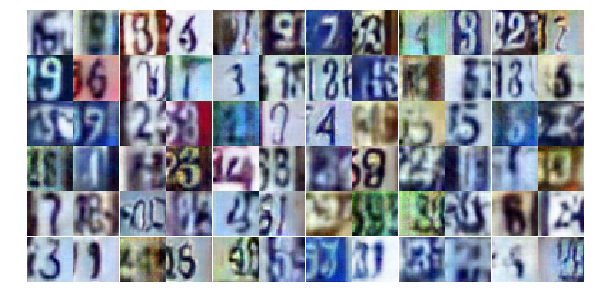

Epoch 18/25... Discriminator Loss: 0.6046... Generator Loss: 1.1619
Epoch 18/25... Discriminator Loss: 1.0760... Generator Loss: 0.5956
Epoch 18/25... Discriminator Loss: 1.4859... Generator Loss: 0.3861
Epoch 18/25... Discriminator Loss: 0.6411... Generator Loss: 1.0618
Epoch 18/25... Discriminator Loss: 1.1114... Generator Loss: 0.5491
Epoch 18/25... Discriminator Loss: 0.9768... Generator Loss: 0.7245
Epoch 18/25... Discriminator Loss: 0.7323... Generator Loss: 1.0367
Epoch 18/25... Discriminator Loss: 1.1545... Generator Loss: 0.5797
Epoch 18/25... Discriminator Loss: 0.8939... Generator Loss: 0.8309
Epoch 18/25... Discriminator Loss: 0.6403... Generator Loss: 1.3308


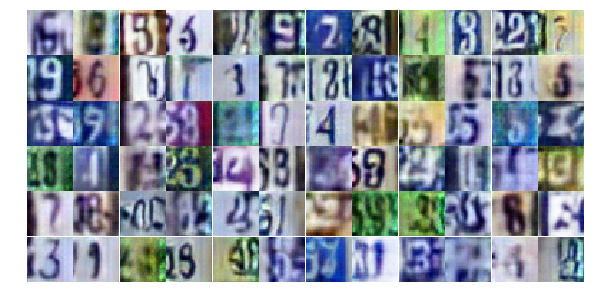

Epoch 18/25... Discriminator Loss: 0.5259... Generator Loss: 1.5996
Epoch 18/25... Discriminator Loss: 0.8650... Generator Loss: 0.8694
Epoch 18/25... Discriminator Loss: 0.5666... Generator Loss: 1.1588
Epoch 18/25... Discriminator Loss: 0.6159... Generator Loss: 1.5091
Epoch 18/25... Discriminator Loss: 1.1582... Generator Loss: 0.5651
Epoch 18/25... Discriminator Loss: 0.6844... Generator Loss: 1.1128
Epoch 18/25... Discriminator Loss: 0.7162... Generator Loss: 1.0911
Epoch 18/25... Discriminator Loss: 0.3156... Generator Loss: 2.0951
Epoch 18/25... Discriminator Loss: 0.4240... Generator Loss: 1.4374
Epoch 18/25... Discriminator Loss: 0.7457... Generator Loss: 0.9367


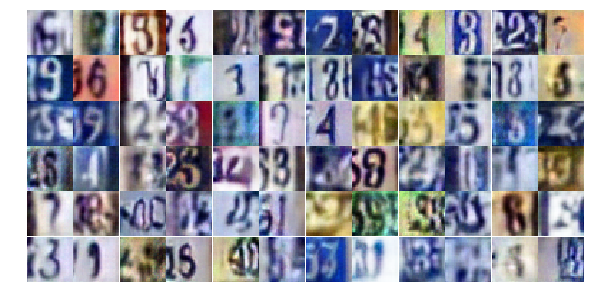

Epoch 18/25... Discriminator Loss: 0.7110... Generator Loss: 0.9974
Epoch 18/25... Discriminator Loss: 0.6178... Generator Loss: 1.0494
Epoch 18/25... Discriminator Loss: 0.8207... Generator Loss: 0.7976
Epoch 18/25... Discriminator Loss: 0.5761... Generator Loss: 1.7672
Epoch 18/25... Discriminator Loss: 0.8484... Generator Loss: 0.8428
Epoch 18/25... Discriminator Loss: 0.5249... Generator Loss: 1.2002
Epoch 18/25... Discriminator Loss: 0.9149... Generator Loss: 0.7755
Epoch 18/25... Discriminator Loss: 2.8221... Generator Loss: 4.4200
Epoch 18/25... Discriminator Loss: 2.3055... Generator Loss: 0.1811
Epoch 18/25... Discriminator Loss: 0.4721... Generator Loss: 1.6559


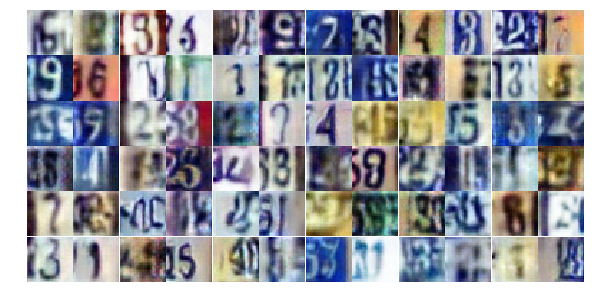

Epoch 18/25... Discriminator Loss: 0.6266... Generator Loss: 1.1432
Epoch 18/25... Discriminator Loss: 0.6300... Generator Loss: 1.7938
Epoch 18/25... Discriminator Loss: 0.8289... Generator Loss: 0.8425
Epoch 18/25... Discriminator Loss: 1.1727... Generator Loss: 0.4993
Epoch 18/25... Discriminator Loss: 0.9034... Generator Loss: 0.8110
Epoch 18/25... Discriminator Loss: 0.6533... Generator Loss: 1.1638
Epoch 18/25... Discriminator Loss: 0.8177... Generator Loss: 0.8159
Epoch 18/25... Discriminator Loss: 0.5110... Generator Loss: 1.4064
Epoch 18/25... Discriminator Loss: 1.0120... Generator Loss: 0.7002
Epoch 18/25... Discriminator Loss: 0.9530... Generator Loss: 0.7703


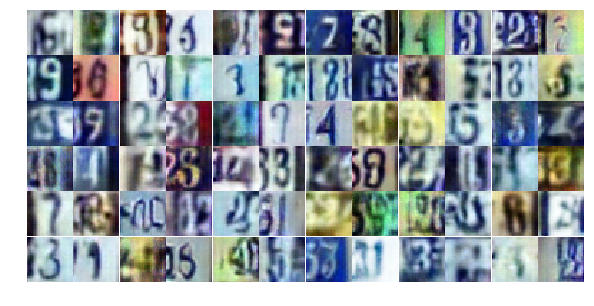

Epoch 18/25... Discriminator Loss: 0.5635... Generator Loss: 1.3879
Epoch 19/25... Discriminator Loss: 0.9645... Generator Loss: 2.2296
Epoch 19/25... Discriminator Loss: 1.0037... Generator Loss: 0.6432
Epoch 19/25... Discriminator Loss: 1.3433... Generator Loss: 0.4740
Epoch 19/25... Discriminator Loss: 0.6788... Generator Loss: 1.1489
Epoch 19/25... Discriminator Loss: 1.0575... Generator Loss: 0.6059
Epoch 19/25... Discriminator Loss: 0.5082... Generator Loss: 1.3819
Epoch 19/25... Discriminator Loss: 0.9426... Generator Loss: 0.8455
Epoch 19/25... Discriminator Loss: 0.7386... Generator Loss: 2.6575
Epoch 19/25... Discriminator Loss: 0.9086... Generator Loss: 0.8143


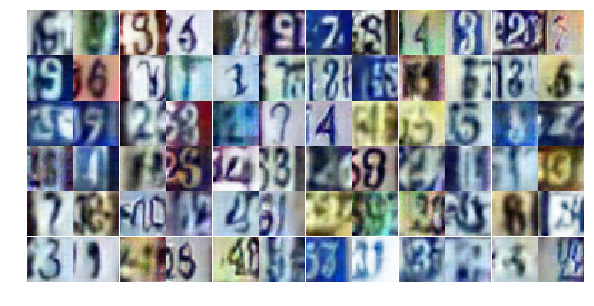

Epoch 19/25... Discriminator Loss: 0.5170... Generator Loss: 1.3178
Epoch 19/25... Discriminator Loss: 0.4742... Generator Loss: 1.5688
Epoch 19/25... Discriminator Loss: 0.7316... Generator Loss: 1.0092
Epoch 19/25... Discriminator Loss: 1.0772... Generator Loss: 0.5827
Epoch 19/25... Discriminator Loss: 1.1849... Generator Loss: 0.5108
Epoch 19/25... Discriminator Loss: 0.5136... Generator Loss: 1.4431
Epoch 19/25... Discriminator Loss: 1.1489... Generator Loss: 0.7210
Epoch 19/25... Discriminator Loss: 0.5160... Generator Loss: 1.3532
Epoch 19/25... Discriminator Loss: 0.7097... Generator Loss: 1.1126
Epoch 19/25... Discriminator Loss: 0.9758... Generator Loss: 0.7480


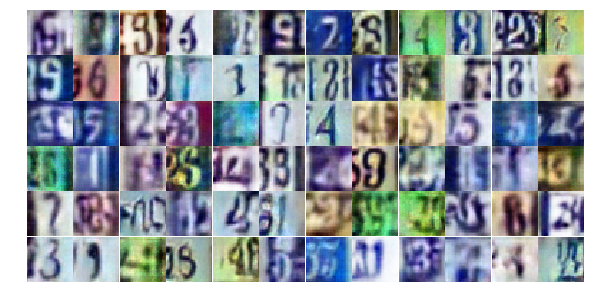

Epoch 19/25... Discriminator Loss: 0.7924... Generator Loss: 0.8181
Epoch 19/25... Discriminator Loss: 1.3252... Generator Loss: 0.4833
Epoch 19/25... Discriminator Loss: 1.0411... Generator Loss: 0.6136
Epoch 19/25... Discriminator Loss: 0.8884... Generator Loss: 1.0857
Epoch 19/25... Discriminator Loss: 0.9561... Generator Loss: 0.7531
Epoch 19/25... Discriminator Loss: 1.7110... Generator Loss: 0.3655
Epoch 19/25... Discriminator Loss: 1.0724... Generator Loss: 0.6597
Epoch 19/25... Discriminator Loss: 0.5851... Generator Loss: 1.2133
Epoch 19/25... Discriminator Loss: 0.7258... Generator Loss: 1.0443
Epoch 19/25... Discriminator Loss: 1.0820... Generator Loss: 0.6045


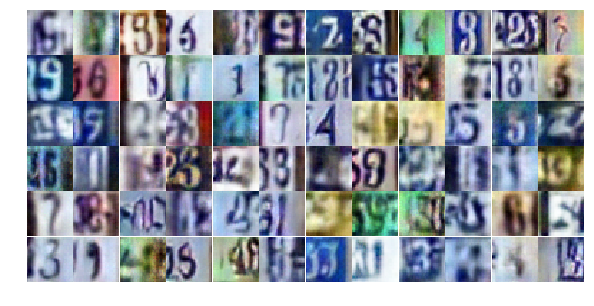

Epoch 19/25... Discriminator Loss: 1.0665... Generator Loss: 0.6797
Epoch 19/25... Discriminator Loss: 0.5343... Generator Loss: 1.1628
Epoch 19/25... Discriminator Loss: 0.7763... Generator Loss: 0.9624
Epoch 19/25... Discriminator Loss: 0.6146... Generator Loss: 1.1025
Epoch 19/25... Discriminator Loss: 0.7293... Generator Loss: 1.1026
Epoch 19/25... Discriminator Loss: 0.8892... Generator Loss: 0.7326
Epoch 19/25... Discriminator Loss: 0.6702... Generator Loss: 1.3751
Epoch 19/25... Discriminator Loss: 0.4932... Generator Loss: 1.6899
Epoch 19/25... Discriminator Loss: 0.8215... Generator Loss: 0.8407
Epoch 19/25... Discriminator Loss: 0.8050... Generator Loss: 0.7793


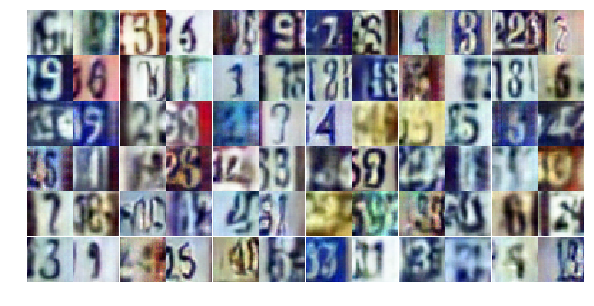

Epoch 19/25... Discriminator Loss: 0.6551... Generator Loss: 1.0478
Epoch 19/25... Discriminator Loss: 0.8350... Generator Loss: 0.8555
Epoch 19/25... Discriminator Loss: 1.4103... Generator Loss: 0.4146
Epoch 19/25... Discriminator Loss: 0.6129... Generator Loss: 1.1449
Epoch 19/25... Discriminator Loss: 0.8702... Generator Loss: 1.6001
Epoch 19/25... Discriminator Loss: 0.5952... Generator Loss: 1.2276
Epoch 19/25... Discriminator Loss: 0.6765... Generator Loss: 1.6988
Epoch 19/25... Discriminator Loss: 0.6102... Generator Loss: 2.0851
Epoch 19/25... Discriminator Loss: 0.4923... Generator Loss: 1.6321
Epoch 19/25... Discriminator Loss: 1.1171... Generator Loss: 0.6386


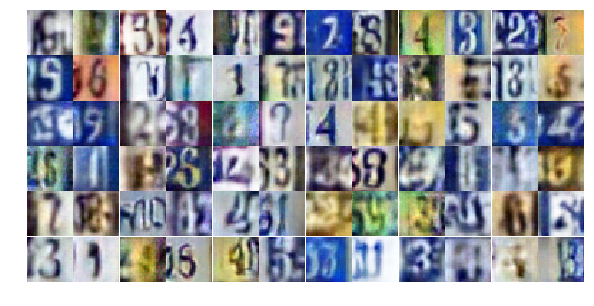

Epoch 19/25... Discriminator Loss: 0.8391... Generator Loss: 0.8479
Epoch 19/25... Discriminator Loss: 0.8344... Generator Loss: 0.8916
Epoch 19/25... Discriminator Loss: 0.6293... Generator Loss: 1.3397
Epoch 19/25... Discriminator Loss: 0.8715... Generator Loss: 0.7645
Epoch 19/25... Discriminator Loss: 0.8546... Generator Loss: 1.5667
Epoch 19/25... Discriminator Loss: 0.6475... Generator Loss: 1.1735
Epoch 19/25... Discriminator Loss: 1.1597... Generator Loss: 0.8048
Epoch 19/25... Discriminator Loss: 0.6672... Generator Loss: 1.6151
Epoch 20/25... Discriminator Loss: 0.7483... Generator Loss: 0.8965
Epoch 20/25... Discriminator Loss: 0.7136... Generator Loss: 1.3526


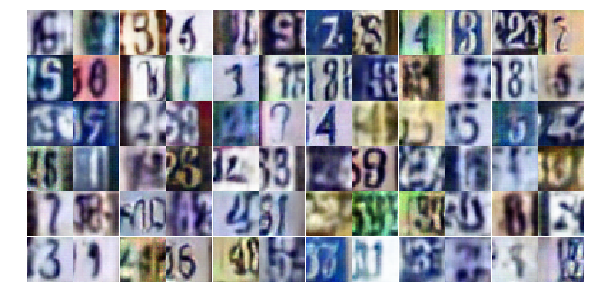

Epoch 20/25... Discriminator Loss: 0.6486... Generator Loss: 1.0107
Epoch 20/25... Discriminator Loss: 0.7985... Generator Loss: 0.8396
Epoch 20/25... Discriminator Loss: 1.6864... Generator Loss: 0.2720
Epoch 20/25... Discriminator Loss: 0.8692... Generator Loss: 0.7733
Epoch 20/25... Discriminator Loss: 0.6541... Generator Loss: 1.1157
Epoch 20/25... Discriminator Loss: 0.6846... Generator Loss: 1.1182
Epoch 20/25... Discriminator Loss: 0.7290... Generator Loss: 0.9530
Epoch 20/25... Discriminator Loss: 0.5166... Generator Loss: 1.3830
Epoch 20/25... Discriminator Loss: 0.8533... Generator Loss: 0.8309
Epoch 20/25... Discriminator Loss: 0.7248... Generator Loss: 0.8766


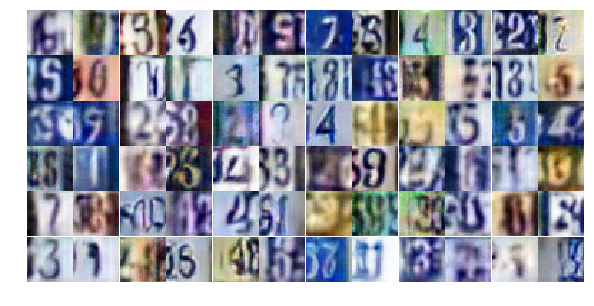

Epoch 20/25... Discriminator Loss: 1.8351... Generator Loss: 0.2581
Epoch 20/25... Discriminator Loss: 1.3775... Generator Loss: 0.3883
Epoch 20/25... Discriminator Loss: 0.8017... Generator Loss: 0.9476
Epoch 20/25... Discriminator Loss: 0.5247... Generator Loss: 1.5271
Epoch 20/25... Discriminator Loss: 0.8568... Generator Loss: 0.7673
Epoch 20/25... Discriminator Loss: 1.2039... Generator Loss: 0.5129
Epoch 20/25... Discriminator Loss: 1.4040... Generator Loss: 0.4164
Epoch 20/25... Discriminator Loss: 0.7022... Generator Loss: 0.9972
Epoch 20/25... Discriminator Loss: 0.9597... Generator Loss: 0.6412
Epoch 20/25... Discriminator Loss: 1.3219... Generator Loss: 0.4713


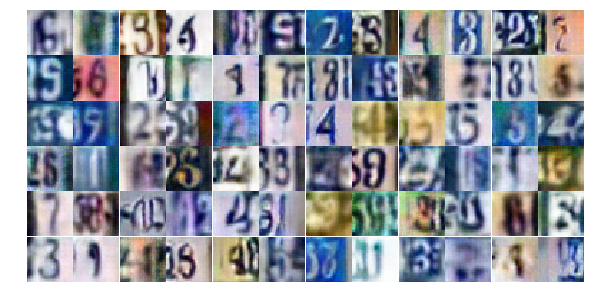

Epoch 20/25... Discriminator Loss: 0.7027... Generator Loss: 0.9447
Epoch 20/25... Discriminator Loss: 0.7185... Generator Loss: 1.1131
Epoch 20/25... Discriminator Loss: 0.6142... Generator Loss: 2.8032
Epoch 20/25... Discriminator Loss: 1.5615... Generator Loss: 0.3693
Epoch 20/25... Discriminator Loss: 0.9776... Generator Loss: 0.7225
Epoch 20/25... Discriminator Loss: 0.6073... Generator Loss: 1.1199
Epoch 20/25... Discriminator Loss: 0.6028... Generator Loss: 1.4701
Epoch 20/25... Discriminator Loss: 1.3210... Generator Loss: 0.4578
Epoch 20/25... Discriminator Loss: 0.9853... Generator Loss: 0.6836
Epoch 20/25... Discriminator Loss: 0.7101... Generator Loss: 0.9064


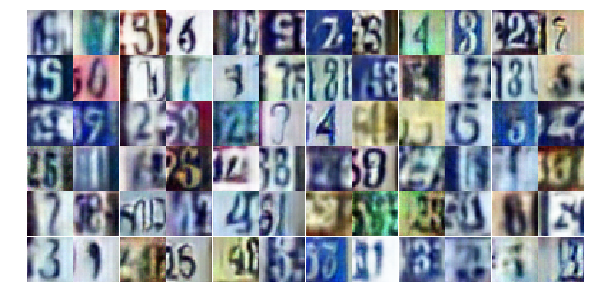

Epoch 20/25... Discriminator Loss: 0.5642... Generator Loss: 1.8803
Epoch 20/25... Discriminator Loss: 0.7091... Generator Loss: 1.0126
Epoch 20/25... Discriminator Loss: 1.2979... Generator Loss: 0.4649
Epoch 20/25... Discriminator Loss: 1.1082... Generator Loss: 2.9509
Epoch 20/25... Discriminator Loss: 0.8090... Generator Loss: 1.0002
Epoch 20/25... Discriminator Loss: 0.5959... Generator Loss: 1.2300
Epoch 20/25... Discriminator Loss: 1.1306... Generator Loss: 2.2907
Epoch 20/25... Discriminator Loss: 0.9301... Generator Loss: 0.8058
Epoch 20/25... Discriminator Loss: 0.7358... Generator Loss: 0.9126
Epoch 20/25... Discriminator Loss: 1.1088... Generator Loss: 0.5836


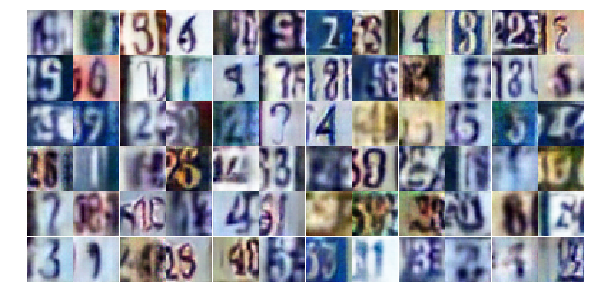

Epoch 20/25... Discriminator Loss: 1.0455... Generator Loss: 0.5985
Epoch 20/25... Discriminator Loss: 0.9364... Generator Loss: 0.6933
Epoch 20/25... Discriminator Loss: 1.2251... Generator Loss: 0.6755
Epoch 20/25... Discriminator Loss: 0.5298... Generator Loss: 1.3042
Epoch 20/25... Discriminator Loss: 0.9891... Generator Loss: 0.7117
Epoch 20/25... Discriminator Loss: 0.6770... Generator Loss: 1.1422
Epoch 20/25... Discriminator Loss: 1.0379... Generator Loss: 0.6386
Epoch 20/25... Discriminator Loss: 0.4360... Generator Loss: 2.0596
Epoch 20/25... Discriminator Loss: 0.6569... Generator Loss: 1.0398
Epoch 20/25... Discriminator Loss: 0.8786... Generator Loss: 0.8245


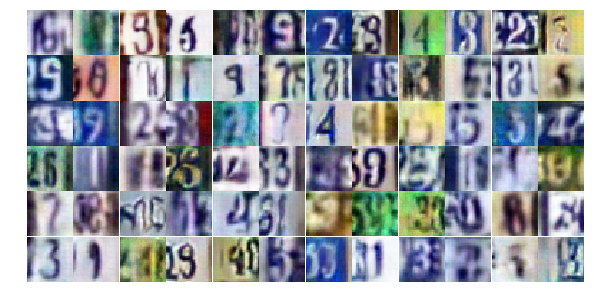

Epoch 20/25... Discriminator Loss: 2.9741... Generator Loss: 0.1413
Epoch 20/25... Discriminator Loss: 1.1609... Generator Loss: 0.5915
Epoch 20/25... Discriminator Loss: 0.5250... Generator Loss: 1.4580
Epoch 20/25... Discriminator Loss: 0.9529... Generator Loss: 1.6045
Epoch 20/25... Discriminator Loss: 0.5703... Generator Loss: 1.4934
Epoch 20/25... Discriminator Loss: 0.6188... Generator Loss: 1.2250
Epoch 21/25... Discriminator Loss: 0.9250... Generator Loss: 1.0033
Epoch 21/25... Discriminator Loss: 0.8172... Generator Loss: 0.8568
Epoch 21/25... Discriminator Loss: 1.1919... Generator Loss: 0.5861
Epoch 21/25... Discriminator Loss: 1.0589... Generator Loss: 2.0904


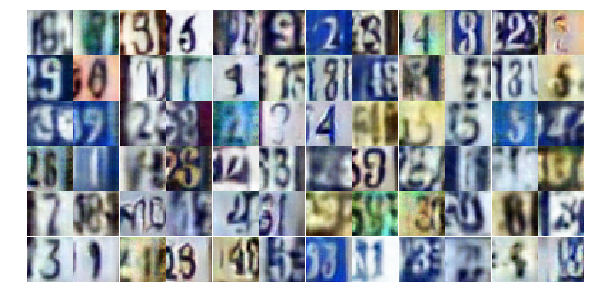

Epoch 21/25... Discriminator Loss: 0.9085... Generator Loss: 0.8209
Epoch 21/25... Discriminator Loss: 1.2227... Generator Loss: 1.3298
Epoch 21/25... Discriminator Loss: 0.6288... Generator Loss: 1.1497
Epoch 21/25... Discriminator Loss: 0.5109... Generator Loss: 1.2558
Epoch 21/25... Discriminator Loss: 0.6687... Generator Loss: 1.0464
Epoch 21/25... Discriminator Loss: 0.4325... Generator Loss: 1.4068
Epoch 21/25... Discriminator Loss: 0.7674... Generator Loss: 0.9103
Epoch 21/25... Discriminator Loss: 1.1208... Generator Loss: 0.6364
Epoch 21/25... Discriminator Loss: 0.5975... Generator Loss: 1.0932
Epoch 21/25... Discriminator Loss: 1.2136... Generator Loss: 0.4803


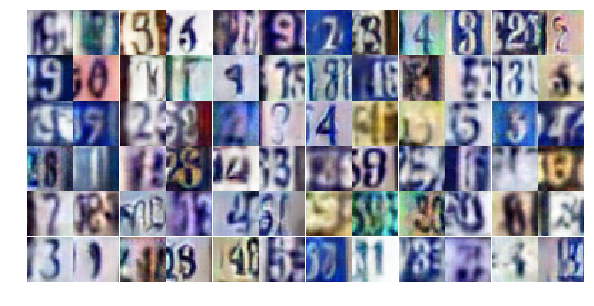

Epoch 21/25... Discriminator Loss: 0.3858... Generator Loss: 1.4900
Epoch 21/25... Discriminator Loss: 1.1174... Generator Loss: 0.5292
Epoch 21/25... Discriminator Loss: 1.5600... Generator Loss: 0.4006
Epoch 21/25... Discriminator Loss: 0.6427... Generator Loss: 1.2954
Epoch 21/25... Discriminator Loss: 0.6621... Generator Loss: 1.4486
Epoch 21/25... Discriminator Loss: 1.0319... Generator Loss: 0.6299
Epoch 21/25... Discriminator Loss: 0.7740... Generator Loss: 0.8597
Epoch 21/25... Discriminator Loss: 0.4380... Generator Loss: 1.7198
Epoch 21/25... Discriminator Loss: 0.5441... Generator Loss: 1.3312
Epoch 21/25... Discriminator Loss: 0.8033... Generator Loss: 0.8775


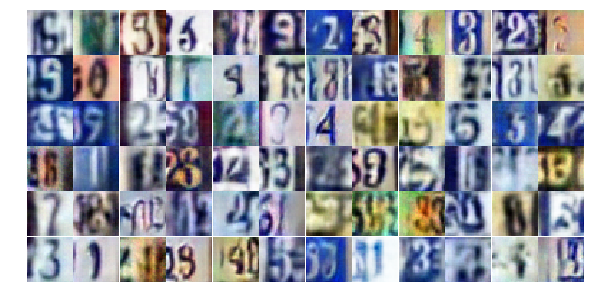

Epoch 21/25... Discriminator Loss: 0.9117... Generator Loss: 0.8799
Epoch 21/25... Discriminator Loss: 0.4428... Generator Loss: 1.4830
Epoch 21/25... Discriminator Loss: 1.4100... Generator Loss: 0.5220
Epoch 21/25... Discriminator Loss: 1.0224... Generator Loss: 0.6079
Epoch 21/25... Discriminator Loss: 1.0322... Generator Loss: 0.6229
Epoch 21/25... Discriminator Loss: 1.5083... Generator Loss: 0.3752
Epoch 21/25... Discriminator Loss: 0.4341... Generator Loss: 2.4558
Epoch 21/25... Discriminator Loss: 1.2629... Generator Loss: 0.4762
Epoch 21/25... Discriminator Loss: 1.0193... Generator Loss: 0.6588
Epoch 21/25... Discriminator Loss: 1.4003... Generator Loss: 0.4305


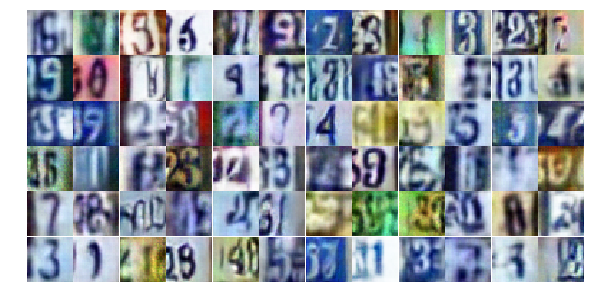

Epoch 21/25... Discriminator Loss: 1.1843... Generator Loss: 0.5151
Epoch 21/25... Discriminator Loss: 0.4762... Generator Loss: 1.4124
Epoch 21/25... Discriminator Loss: 1.1823... Generator Loss: 0.5526
Epoch 21/25... Discriminator Loss: 0.3316... Generator Loss: 1.7666
Epoch 21/25... Discriminator Loss: 0.4479... Generator Loss: 1.3800
Epoch 21/25... Discriminator Loss: 0.9509... Generator Loss: 0.7591
Epoch 21/25... Discriminator Loss: 1.2057... Generator Loss: 0.5490
Epoch 21/25... Discriminator Loss: 1.1908... Generator Loss: 0.4824
Epoch 21/25... Discriminator Loss: 0.8991... Generator Loss: 0.7469
Epoch 21/25... Discriminator Loss: 0.3373... Generator Loss: 1.7809


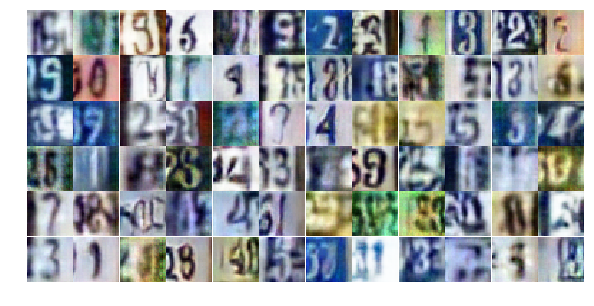

Epoch 21/25... Discriminator Loss: 1.4915... Generator Loss: 0.4089
Epoch 21/25... Discriminator Loss: 1.1167... Generator Loss: 0.6183
Epoch 21/25... Discriminator Loss: 0.9207... Generator Loss: 0.6758
Epoch 21/25... Discriminator Loss: 0.8511... Generator Loss: 0.8037
Epoch 21/25... Discriminator Loss: 0.4550... Generator Loss: 1.8678
Epoch 21/25... Discriminator Loss: 0.9204... Generator Loss: 0.7543
Epoch 21/25... Discriminator Loss: 1.1366... Generator Loss: 0.5801
Epoch 21/25... Discriminator Loss: 1.2866... Generator Loss: 0.4945
Epoch 21/25... Discriminator Loss: 1.2401... Generator Loss: 0.4997
Epoch 21/25... Discriminator Loss: 0.4967... Generator Loss: 1.4458


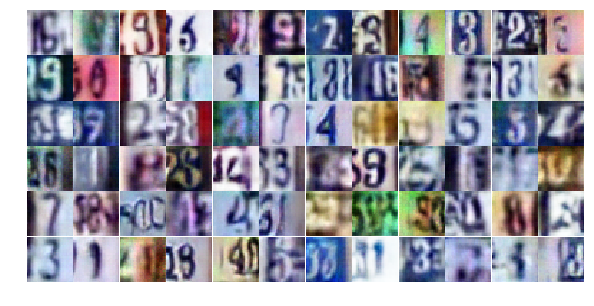

Epoch 21/25... Discriminator Loss: 0.4827... Generator Loss: 1.4421
Epoch 21/25... Discriminator Loss: 1.1867... Generator Loss: 0.5627
Epoch 21/25... Discriminator Loss: 1.0705... Generator Loss: 0.7866
Epoch 22/25... Discriminator Loss: 0.8701... Generator Loss: 0.8238
Epoch 22/25... Discriminator Loss: 0.9673... Generator Loss: 2.1342
Epoch 22/25... Discriminator Loss: 0.9235... Generator Loss: 0.8417
Epoch 22/25... Discriminator Loss: 0.4563... Generator Loss: 1.5451
Epoch 22/25... Discriminator Loss: 0.6856... Generator Loss: 0.9086
Epoch 22/25... Discriminator Loss: 0.8369... Generator Loss: 0.7725
Epoch 22/25... Discriminator Loss: 0.5844... Generator Loss: 1.2821


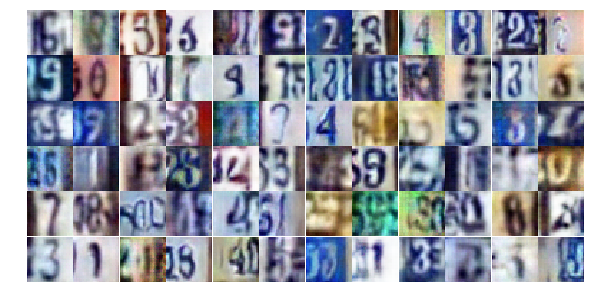

Epoch 22/25... Discriminator Loss: 1.1188... Generator Loss: 0.6466
Epoch 22/25... Discriminator Loss: 0.5335... Generator Loss: 1.3399
Epoch 22/25... Discriminator Loss: 1.1454... Generator Loss: 0.5753
Epoch 22/25... Discriminator Loss: 0.5917... Generator Loss: 1.1513
Epoch 22/25... Discriminator Loss: 0.8117... Generator Loss: 0.9796
Epoch 22/25... Discriminator Loss: 0.4399... Generator Loss: 1.6494
Epoch 22/25... Discriminator Loss: 0.9392... Generator Loss: 2.1770
Epoch 22/25... Discriminator Loss: 0.4982... Generator Loss: 1.6560
Epoch 22/25... Discriminator Loss: 1.0706... Generator Loss: 0.6302
Epoch 22/25... Discriminator Loss: 1.8953... Generator Loss: 0.2452


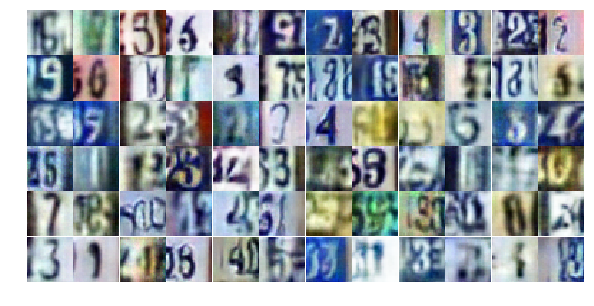

Epoch 22/25... Discriminator Loss: 0.6455... Generator Loss: 1.6750
Epoch 22/25... Discriminator Loss: 0.5085... Generator Loss: 1.2848
Epoch 22/25... Discriminator Loss: 0.7257... Generator Loss: 1.0537
Epoch 22/25... Discriminator Loss: 0.6300... Generator Loss: 1.0517
Epoch 22/25... Discriminator Loss: 0.4224... Generator Loss: 1.6418
Epoch 22/25... Discriminator Loss: 0.7461... Generator Loss: 0.9020
Epoch 22/25... Discriminator Loss: 0.4537... Generator Loss: 1.4011
Epoch 22/25... Discriminator Loss: 0.7771... Generator Loss: 0.9317
Epoch 22/25... Discriminator Loss: 0.5878... Generator Loss: 1.5445
Epoch 22/25... Discriminator Loss: 0.9076... Generator Loss: 0.7968


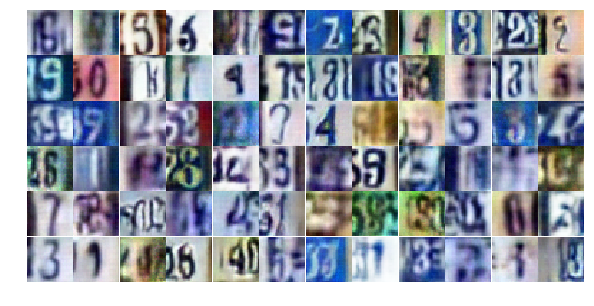

Epoch 22/25... Discriminator Loss: 0.2679... Generator Loss: 2.2332
Epoch 22/25... Discriminator Loss: 0.5912... Generator Loss: 1.2731
Epoch 22/25... Discriminator Loss: 1.0559... Generator Loss: 0.6922
Epoch 22/25... Discriminator Loss: 0.8501... Generator Loss: 0.7610
Epoch 22/25... Discriminator Loss: 0.7032... Generator Loss: 1.1667
Epoch 22/25... Discriminator Loss: 1.3023... Generator Loss: 0.4515
Epoch 22/25... Discriminator Loss: 1.0359... Generator Loss: 0.6849
Epoch 22/25... Discriminator Loss: 0.5858... Generator Loss: 1.3465
Epoch 22/25... Discriminator Loss: 0.5246... Generator Loss: 1.5474
Epoch 22/25... Discriminator Loss: 1.3799... Generator Loss: 0.4548


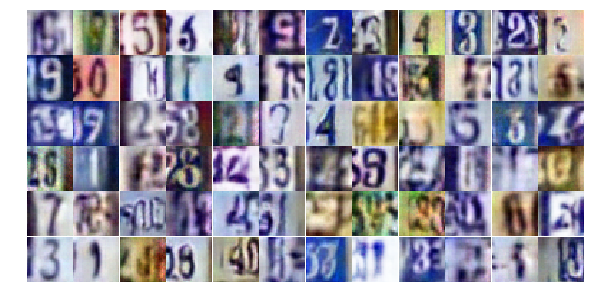

Epoch 22/25... Discriminator Loss: 0.6742... Generator Loss: 1.2456
Epoch 22/25... Discriminator Loss: 0.6798... Generator Loss: 1.0738
Epoch 22/25... Discriminator Loss: 0.4727... Generator Loss: 1.2452
Epoch 22/25... Discriminator Loss: 0.9177... Generator Loss: 0.6931
Epoch 22/25... Discriminator Loss: 0.5811... Generator Loss: 1.0544
Epoch 22/25... Discriminator Loss: 0.3249... Generator Loss: 2.0184
Epoch 22/25... Discriminator Loss: 0.7332... Generator Loss: 0.9820
Epoch 22/25... Discriminator Loss: 2.3895... Generator Loss: 0.2059
Epoch 22/25... Discriminator Loss: 1.5938... Generator Loss: 0.4839
Epoch 22/25... Discriminator Loss: 0.8467... Generator Loss: 0.9485


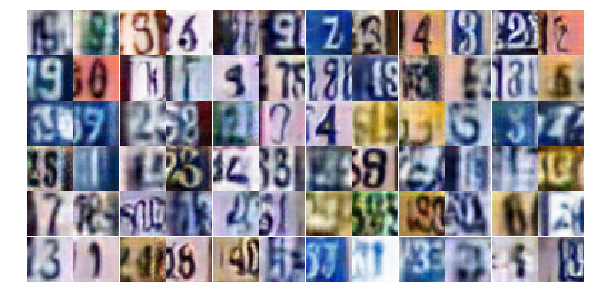

Epoch 22/25... Discriminator Loss: 1.0974... Generator Loss: 0.5830
Epoch 22/25... Discriminator Loss: 0.6891... Generator Loss: 1.0491
Epoch 22/25... Discriminator Loss: 0.9279... Generator Loss: 0.7842
Epoch 22/25... Discriminator Loss: 1.1312... Generator Loss: 0.5486
Epoch 22/25... Discriminator Loss: 0.8413... Generator Loss: 0.8455
Epoch 22/25... Discriminator Loss: 0.5558... Generator Loss: 1.2588
Epoch 22/25... Discriminator Loss: 1.3818... Generator Loss: 0.4606
Epoch 22/25... Discriminator Loss: 0.8178... Generator Loss: 0.7794
Epoch 22/25... Discriminator Loss: 0.7043... Generator Loss: 1.4982
Epoch 22/25... Discriminator Loss: 1.1713... Generator Loss: 0.5712


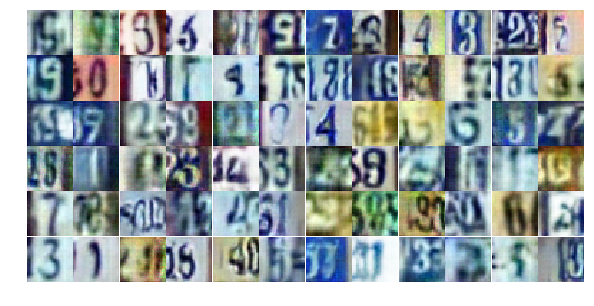

Epoch 23/25... Discriminator Loss: 0.6335... Generator Loss: 1.1010
Epoch 23/25... Discriminator Loss: 0.4206... Generator Loss: 1.5697
Epoch 23/25... Discriminator Loss: 1.1236... Generator Loss: 0.5285
Epoch 23/25... Discriminator Loss: 0.8211... Generator Loss: 0.8535
Epoch 23/25... Discriminator Loss: 0.9891... Generator Loss: 2.7442
Epoch 23/25... Discriminator Loss: 1.6972... Generator Loss: 0.2779
Epoch 23/25... Discriminator Loss: 1.0391... Generator Loss: 0.6777
Epoch 23/25... Discriminator Loss: 0.9159... Generator Loss: 0.7846
Epoch 23/25... Discriminator Loss: 0.6439... Generator Loss: 1.0973
Epoch 23/25... Discriminator Loss: 0.5006... Generator Loss: 1.6021


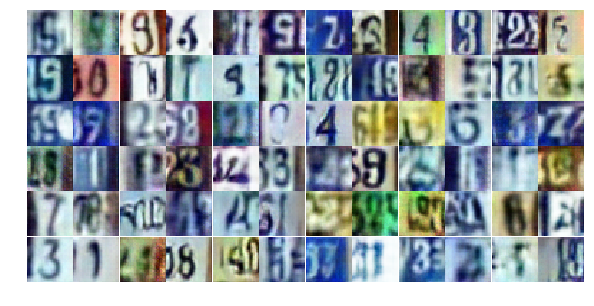

Epoch 23/25... Discriminator Loss: 0.5674... Generator Loss: 1.1684
Epoch 23/25... Discriminator Loss: 0.6756... Generator Loss: 1.0205
Epoch 23/25... Discriminator Loss: 0.9586... Generator Loss: 0.6772
Epoch 23/25... Discriminator Loss: 0.9753... Generator Loss: 0.6213
Epoch 23/25... Discriminator Loss: 0.4841... Generator Loss: 1.5220
Epoch 23/25... Discriminator Loss: 1.3850... Generator Loss: 0.4540
Epoch 23/25... Discriminator Loss: 0.8980... Generator Loss: 0.7666
Epoch 23/25... Discriminator Loss: 0.4495... Generator Loss: 2.1489
Epoch 23/25... Discriminator Loss: 0.7427... Generator Loss: 1.0823
Epoch 23/25... Discriminator Loss: 1.1466... Generator Loss: 0.5750


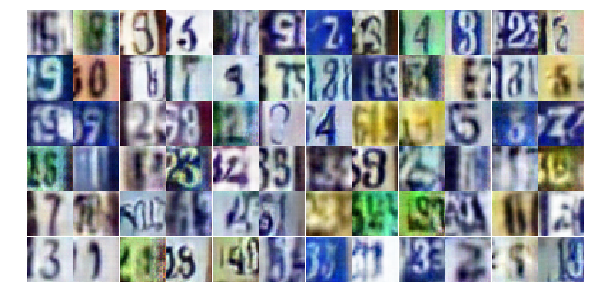

Epoch 23/25... Discriminator Loss: 1.1161... Generator Loss: 0.5938
Epoch 23/25... Discriminator Loss: 0.5531... Generator Loss: 1.2313
Epoch 23/25... Discriminator Loss: 1.0292... Generator Loss: 0.6747
Epoch 23/25... Discriminator Loss: 0.8767... Generator Loss: 0.9257
Epoch 23/25... Discriminator Loss: 0.6096... Generator Loss: 1.1334
Epoch 23/25... Discriminator Loss: 0.7302... Generator Loss: 1.1938
Epoch 23/25... Discriminator Loss: 0.6418... Generator Loss: 1.0376
Epoch 23/25... Discriminator Loss: 0.8923... Generator Loss: 0.7840
Epoch 23/25... Discriminator Loss: 0.7933... Generator Loss: 1.0007
Epoch 23/25... Discriminator Loss: 0.8565... Generator Loss: 1.5188


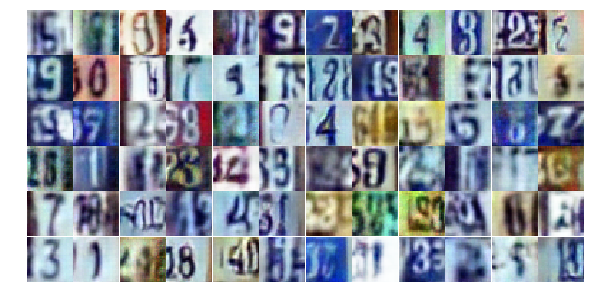

Epoch 23/25... Discriminator Loss: 0.5607... Generator Loss: 1.2680
Epoch 23/25... Discriminator Loss: 0.6622... Generator Loss: 1.1497
Epoch 23/25... Discriminator Loss: 0.6397... Generator Loss: 1.1401
Epoch 23/25... Discriminator Loss: 1.7523... Generator Loss: 0.3083
Epoch 23/25... Discriminator Loss: 4.6058... Generator Loss: 0.1288
Epoch 23/25... Discriminator Loss: 2.0139... Generator Loss: 0.2965
Epoch 23/25... Discriminator Loss: 0.8013... Generator Loss: 1.2200
Epoch 23/25... Discriminator Loss: 0.6056... Generator Loss: 1.1643
Epoch 23/25... Discriminator Loss: 0.4856... Generator Loss: 1.7827
Epoch 23/25... Discriminator Loss: 0.5258... Generator Loss: 1.4370


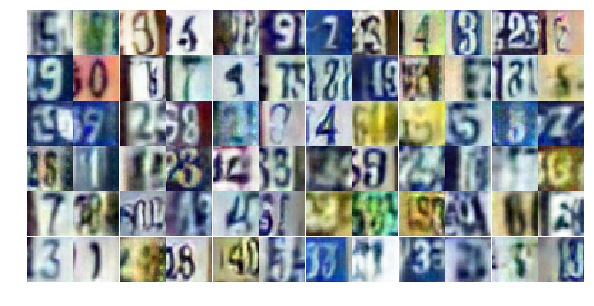

Epoch 23/25... Discriminator Loss: 0.8646... Generator Loss: 0.7995
Epoch 23/25... Discriminator Loss: 0.8051... Generator Loss: 0.8694
Epoch 23/25... Discriminator Loss: 1.1517... Generator Loss: 0.5542
Epoch 23/25... Discriminator Loss: 0.7108... Generator Loss: 1.0242
Epoch 23/25... Discriminator Loss: 0.7835... Generator Loss: 0.9404
Epoch 23/25... Discriminator Loss: 0.6476... Generator Loss: 1.0239
Epoch 23/25... Discriminator Loss: 0.6697... Generator Loss: 1.0025
Epoch 23/25... Discriminator Loss: 0.7273... Generator Loss: 0.9844
Epoch 23/25... Discriminator Loss: 0.6888... Generator Loss: 1.0113
Epoch 23/25... Discriminator Loss: 0.5675... Generator Loss: 1.2047


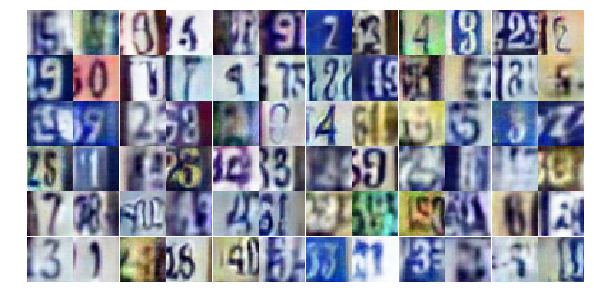

Epoch 23/25... Discriminator Loss: 0.8280... Generator Loss: 0.8246
Epoch 23/25... Discriminator Loss: 1.0849... Generator Loss: 0.5975
Epoch 23/25... Discriminator Loss: 0.8087... Generator Loss: 0.9007
Epoch 23/25... Discriminator Loss: 0.3093... Generator Loss: 1.7192
Epoch 23/25... Discriminator Loss: 0.9031... Generator Loss: 0.7977
Epoch 23/25... Discriminator Loss: 1.4435... Generator Loss: 0.3859
Epoch 23/25... Discriminator Loss: 1.1691... Generator Loss: 0.6055
Epoch 24/25... Discriminator Loss: 0.6830... Generator Loss: 1.0319
Epoch 24/25... Discriminator Loss: 0.8613... Generator Loss: 0.9630
Epoch 24/25... Discriminator Loss: 0.8875... Generator Loss: 1.2006


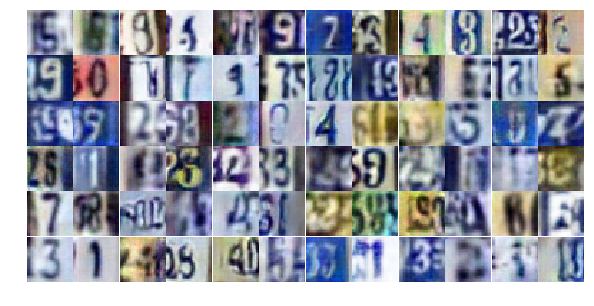

Epoch 24/25... Discriminator Loss: 0.6433... Generator Loss: 1.1521
Epoch 24/25... Discriminator Loss: 0.8072... Generator Loss: 0.8472
Epoch 24/25... Discriminator Loss: 1.0302... Generator Loss: 0.6107
Epoch 24/25... Discriminator Loss: 0.7535... Generator Loss: 1.1155
Epoch 24/25... Discriminator Loss: 0.6887... Generator Loss: 1.0688
Epoch 24/25... Discriminator Loss: 0.4587... Generator Loss: 1.4588
Epoch 24/25... Discriminator Loss: 0.6286... Generator Loss: 1.1383
Epoch 24/25... Discriminator Loss: 0.6937... Generator Loss: 0.9349
Epoch 24/25... Discriminator Loss: 0.5477... Generator Loss: 1.0910
Epoch 24/25... Discriminator Loss: 0.4390... Generator Loss: 1.5622


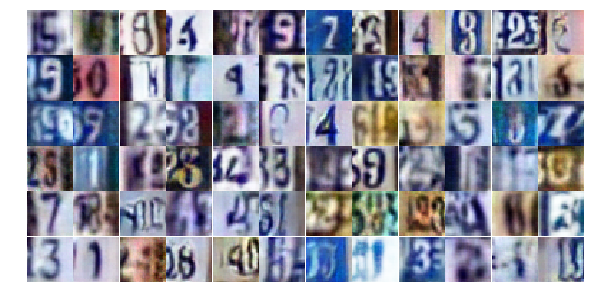

Epoch 24/25... Discriminator Loss: 0.9935... Generator Loss: 0.6390
Epoch 24/25... Discriminator Loss: 1.5160... Generator Loss: 0.3710
Epoch 24/25... Discriminator Loss: 1.3249... Generator Loss: 0.5021
Epoch 24/25... Discriminator Loss: 0.4923... Generator Loss: 1.2352
Epoch 24/25... Discriminator Loss: 0.5063... Generator Loss: 1.7993
Epoch 24/25... Discriminator Loss: 1.3879... Generator Loss: 0.4819
Epoch 24/25... Discriminator Loss: 0.5229... Generator Loss: 1.2539
Epoch 24/25... Discriminator Loss: 0.7806... Generator Loss: 1.7279
Epoch 24/25... Discriminator Loss: 0.9929... Generator Loss: 0.9874
Epoch 24/25... Discriminator Loss: 1.4491... Generator Loss: 0.3804


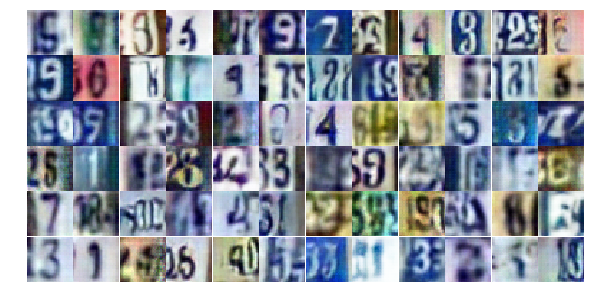

Epoch 24/25... Discriminator Loss: 0.8697... Generator Loss: 0.8345
Epoch 24/25... Discriminator Loss: 1.1373... Generator Loss: 0.6105
Epoch 24/25... Discriminator Loss: 0.5758... Generator Loss: 1.0613
Epoch 24/25... Discriminator Loss: 1.2312... Generator Loss: 0.4958
Epoch 24/25... Discriminator Loss: 0.6193... Generator Loss: 1.1574
Epoch 24/25... Discriminator Loss: 0.4936... Generator Loss: 2.4995
Epoch 24/25... Discriminator Loss: 0.4055... Generator Loss: 1.6418
Epoch 24/25... Discriminator Loss: 0.7366... Generator Loss: 0.9963
Epoch 24/25... Discriminator Loss: 0.6316... Generator Loss: 1.2499
Epoch 24/25... Discriminator Loss: 0.8183... Generator Loss: 0.8676


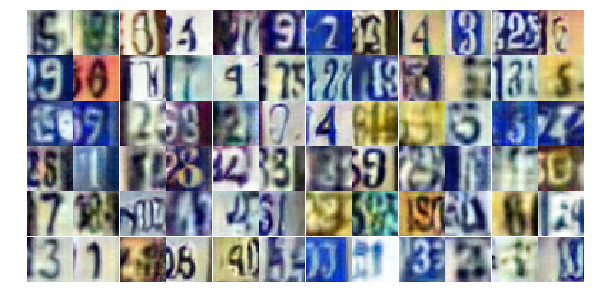

Epoch 24/25... Discriminator Loss: 0.4657... Generator Loss: 1.3957
Epoch 24/25... Discriminator Loss: 0.9419... Generator Loss: 0.6949
Epoch 24/25... Discriminator Loss: 0.7939... Generator Loss: 0.8719
Epoch 24/25... Discriminator Loss: 1.0124... Generator Loss: 0.6149
Epoch 24/25... Discriminator Loss: 0.6762... Generator Loss: 2.1659
Epoch 24/25... Discriminator Loss: 0.7648... Generator Loss: 0.9138
Epoch 24/25... Discriminator Loss: 0.8431... Generator Loss: 0.8346
Epoch 24/25... Discriminator Loss: 0.8610... Generator Loss: 0.7585
Epoch 24/25... Discriminator Loss: 0.6144... Generator Loss: 1.1749
Epoch 24/25... Discriminator Loss: 1.4830... Generator Loss: 4.0767


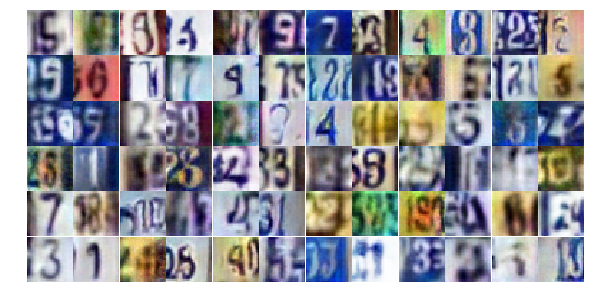

Epoch 24/25... Discriminator Loss: 1.2386... Generator Loss: 0.5387
Epoch 24/25... Discriminator Loss: 1.9403... Generator Loss: 0.2936
Epoch 24/25... Discriminator Loss: 6.1102... Generator Loss: 0.0081
Epoch 24/25... Discriminator Loss: 1.1962... Generator Loss: 2.6491
Epoch 24/25... Discriminator Loss: 1.2826... Generator Loss: 0.5413
Epoch 24/25... Discriminator Loss: 0.7554... Generator Loss: 0.9619
Epoch 24/25... Discriminator Loss: 0.9404... Generator Loss: 0.8105
Epoch 24/25... Discriminator Loss: 0.4856... Generator Loss: 1.3644
Epoch 24/25... Discriminator Loss: 1.1572... Generator Loss: 0.5596
Epoch 24/25... Discriminator Loss: 0.7593... Generator Loss: 1.1675


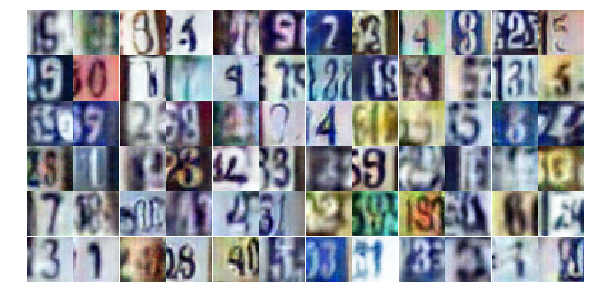

Epoch 24/25... Discriminator Loss: 0.7720... Generator Loss: 0.8867
Epoch 24/25... Discriminator Loss: 1.3357... Generator Loss: 0.5001
Epoch 24/25... Discriminator Loss: 0.7765... Generator Loss: 0.8767
Epoch 24/25... Discriminator Loss: 0.9005... Generator Loss: 0.8845
Epoch 24/25... Discriminator Loss: 1.1348... Generator Loss: 0.6582
Epoch 25/25... Discriminator Loss: 0.4767... Generator Loss: 1.6105
Epoch 25/25... Discriminator Loss: 0.6307... Generator Loss: 1.2193
Epoch 25/25... Discriminator Loss: 0.5451... Generator Loss: 1.4701
Epoch 25/25... Discriminator Loss: 0.5996... Generator Loss: 1.1664
Epoch 25/25... Discriminator Loss: 1.1541... Generator Loss: 0.5477


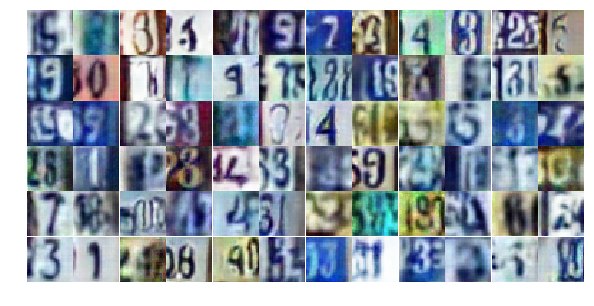

Epoch 25/25... Discriminator Loss: 0.9829... Generator Loss: 0.6372
Epoch 25/25... Discriminator Loss: 1.4955... Generator Loss: 0.4157
Epoch 25/25... Discriminator Loss: 0.9849... Generator Loss: 0.7061
Epoch 25/25... Discriminator Loss: 0.8407... Generator Loss: 0.8351
Epoch 25/25... Discriminator Loss: 0.6852... Generator Loss: 2.4974
Epoch 25/25... Discriminator Loss: 0.7111... Generator Loss: 0.9474
Epoch 25/25... Discriminator Loss: 0.7369... Generator Loss: 0.9596
Epoch 25/25... Discriminator Loss: 0.9724... Generator Loss: 0.6826
Epoch 25/25... Discriminator Loss: 0.5657... Generator Loss: 1.1735
Epoch 25/25... Discriminator Loss: 0.8367... Generator Loss: 0.7625


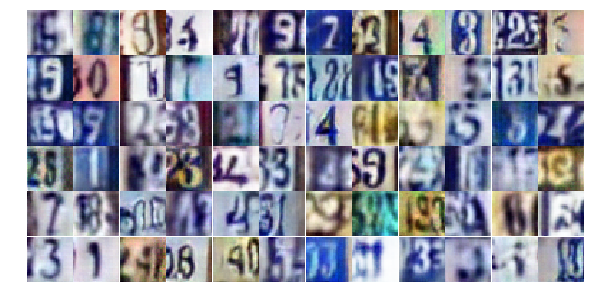

Epoch 25/25... Discriminator Loss: 0.7638... Generator Loss: 0.9256
Epoch 25/25... Discriminator Loss: 0.4340... Generator Loss: 1.7650
Epoch 25/25... Discriminator Loss: 1.2845... Generator Loss: 0.4898
Epoch 25/25... Discriminator Loss: 0.5362... Generator Loss: 1.3872
Epoch 25/25... Discriminator Loss: 0.7215... Generator Loss: 1.3132
Epoch 25/25... Discriminator Loss: 0.6054... Generator Loss: 1.1871
Epoch 25/25... Discriminator Loss: 1.1959... Generator Loss: 0.5806
Epoch 25/25... Discriminator Loss: 0.8408... Generator Loss: 1.5075
Epoch 25/25... Discriminator Loss: 0.4774... Generator Loss: 1.4265
Epoch 25/25... Discriminator Loss: 0.6446... Generator Loss: 1.1304


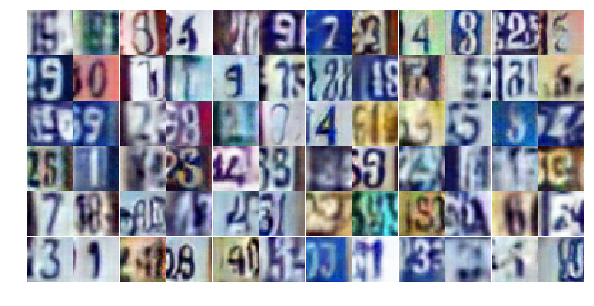

Epoch 25/25... Discriminator Loss: 0.7019... Generator Loss: 1.0092
Epoch 25/25... Discriminator Loss: 0.6830... Generator Loss: 2.4035
Epoch 25/25... Discriminator Loss: 0.8104... Generator Loss: 0.9010
Epoch 25/25... Discriminator Loss: 0.6732... Generator Loss: 0.9978
Epoch 25/25... Discriminator Loss: 0.6549... Generator Loss: 1.1332
Epoch 25/25... Discriminator Loss: 0.7044... Generator Loss: 0.9521
Epoch 25/25... Discriminator Loss: 0.6589... Generator Loss: 1.1309
Epoch 25/25... Discriminator Loss: 0.6502... Generator Loss: 1.0713
Epoch 25/25... Discriminator Loss: 0.8962... Generator Loss: 2.0861
Epoch 25/25... Discriminator Loss: 0.6180... Generator Loss: 1.2153


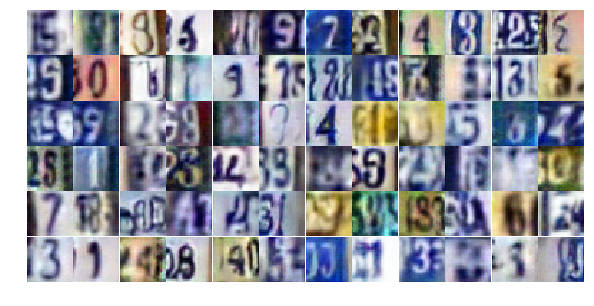

Epoch 25/25... Discriminator Loss: 0.6543... Generator Loss: 1.1269
Epoch 25/25... Discriminator Loss: 0.6734... Generator Loss: 0.9638
Epoch 25/25... Discriminator Loss: 0.7440... Generator Loss: 1.2410
Epoch 25/25... Discriminator Loss: 0.6208... Generator Loss: 1.0531
Epoch 25/25... Discriminator Loss: 1.2918... Generator Loss: 0.4594
Epoch 25/25... Discriminator Loss: 1.2939... Generator Loss: 0.4700
Epoch 25/25... Discriminator Loss: 0.4211... Generator Loss: 1.7145
Epoch 25/25... Discriminator Loss: 0.5154... Generator Loss: 1.3884
Epoch 25/25... Discriminator Loss: 1.5351... Generator Loss: 0.4714
Epoch 25/25... Discriminator Loss: 0.7942... Generator Loss: 0.8718


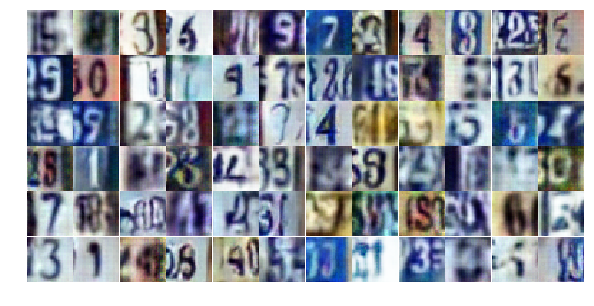

Epoch 25/25... Discriminator Loss: 0.7626... Generator Loss: 1.6697
Epoch 25/25... Discriminator Loss: 0.7960... Generator Loss: 0.8345
Epoch 25/25... Discriminator Loss: 0.7642... Generator Loss: 1.2168
Epoch 25/25... Discriminator Loss: 1.2402... Generator Loss: 0.4990
Epoch 25/25... Discriminator Loss: 0.8476... Generator Loss: 0.8651
Epoch 25/25... Discriminator Loss: 0.6232... Generator Loss: 1.0830
Epoch 25/25... Discriminator Loss: 1.1920... Generator Loss: 0.5561
Epoch 25/25... Discriminator Loss: 0.8990... Generator Loss: 1.0506
Epoch 25/25... Discriminator Loss: 1.1030... Generator Loss: 0.5871
Epoch 25/25... Discriminator Loss: 0.9635... Generator Loss: 0.7513


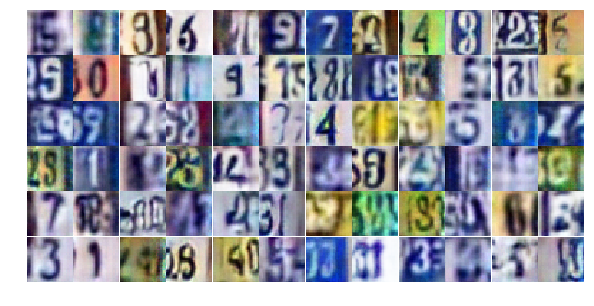

Epoch 25/25... Discriminator Loss: 0.5606... Generator Loss: 1.2640
Epoch 25/25... Discriminator Loss: 1.3795... Generator Loss: 0.4248


In [17]:
dataset = Dataset(trainset, testset)

losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

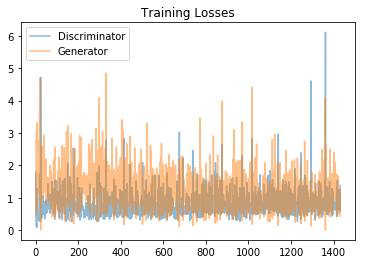

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

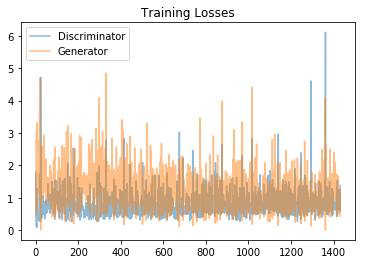

In [19]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

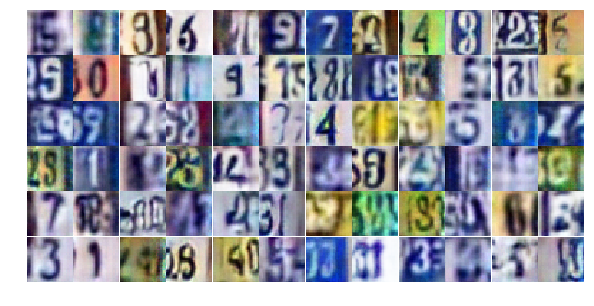

In [20]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))

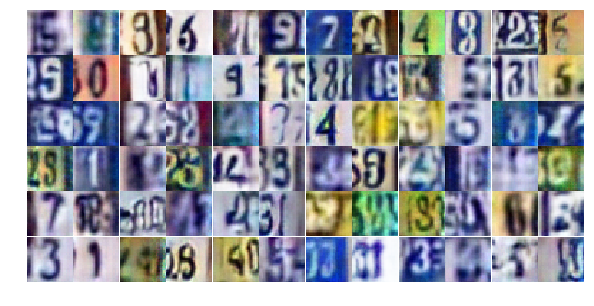

In [21]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))